# All oscillation analysis

Brief 1-2 sentence description of notebook.

In [1]:
# Imports of all used packages and libraries
import sys
import os
import git
import glob
from collections import defaultdict

In [2]:
git_repo = git.Repo(".", search_parent_directories=True)
git_root = git_repo.git.rev_parse("--show-toplevel")

In [3]:
git_root

'/blue/npadillacoreano/ryoi360/projects/reward_comp/repos/reward_competition_extention'

In [4]:
sys.path.insert(0, os.path.join(git_root, 'src'))

In [5]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
import os
import collections
import itertools
from collections import defaultdict
from itertools import combinations

In [7]:
# Imports of all used packages and libraries
import numpy as np
import pandas as pd
from scipy import stats
from scipy.stats import mannwhitneyu


In [8]:
import matplotlib
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import colorsys

In [9]:
import utilities.helper
import trodes.read_exported

In [10]:
import shutil
from pathlib import Path


In [11]:
FONTSIZE = 20

In [12]:
font = {'weight' : 'medium',
        'size'   : 20}

matplotlib.rc('font', **font)

## Inputs & Data

Explanation of each input and where it comes from.

In [13]:
# Inputs and Required data loading
# input varaible names are in all caps snake case
# Whenever an input changes or is used for processing 
# the vairables are all lower in snake case
OUTPUT_DIR = r"./proc" # where data is saved should always be shown in the inputs

In [14]:
LFP_SPECTRAL_DF = pd.read_pickle("../proc/rce_pilot_2_10_per_trial_spectral_bans_sleap.pkl")

In [15]:
OUTCOME_TO_COLOR = {"both_rewarded": "green", 
"novel_lose": "#e67073",
"novel_win": "#93a5da",
"lose": "#951a1d",
"alone_rewarded": "#0499af",
"win": "#3853a3",
"omission": "orange"}

In [16]:
OUTCOME_TO_COLOR = {"both_rewarded": "green", 
"novel_lose": "#e67073",
                    "novel_lose_competitive": "#e67073",
                    "novel_lose_no_comp": "#e67073",
"novel_win": "#93a5da",
                    "novel_win_competitive": "#93a5da",
                    "novel_win_no_comp": "#93a5da",
"lose": "#951a1d",
                    "lose_no_comp": "#951a1d",
                    "lose_competitive": "#951a1d",
"alone_rewarded": "#0499af",
"win": "#3853a3",
                    "win_competitive": "#3853a3",
                    "win_no_comp": "#3853a3",

"omission": "orange"}

In [17]:
session_types = ["training", "omission", "both", "novel"]

In [18]:
BAND_TO_FREQ_PLOT = {'theta': (4, 12), 'gamma': (30, 50)}
BAND_TO_FREQ_COLOR = {'theta': "red", 'beta': "blue", 'gamma': "green"}

In [19]:
preprocessing_type = ""

In [20]:
comp_closeness_dict = {'Subj 1 blocking Subj 2': "competitive",
'Subj 2 Only': "no_comp",
'Subj 2 blocking Subj 1': "competitive",
'Subj 1 then Subj 2': "competitive", 
'Subj 1 Only': "no_comp",
'Subj 2 then Subj 1': "competitive",
'Close Call': "competitive",
'After trial': "no_comp"}

## Outputs

Describe each output that the notebook creates. 

- Is it a plot or is it data?

- How valuable is the output and why is it valuable or useful?

## Functions 

In [21]:
def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """

    return np.isnan(y), lambda z: z.nonzero()[0]

In [22]:
# Define a function to horizontally stack arrays
def stack_arrays(arrays):
    return np.vstack(arrays)

## Processing

Describe what is done to the data here and how inputs are manipulated to generate outputs. 

In [23]:
# As much code and as many cells as required
# includes EDA and playing with data
# GO HAM!

# Ideally functions are defined here first and then data is processed using the functions

# function names are short and in snake case all lowercase
# a function name should be unique but does not have to describe the function
# doc strings describe functions not function names




In [24]:
for col in LFP_SPECTRAL_DF.columns:
    print(col)

index
tracked_subject
box_number
sleap_name
video_name
current_subject
tone_start_frame
reward_start_frame
tone_stop_frame
condition
competition_closeness
notes
experiment
session_dir
all_subjects
tone_start_timestamp
tone_stop_timestamp
trial_label
cohort
tone_frames
box_1_port_entry_frames
box_2_port_entry_frames
session_path
recording
subject
first_timestamp
last_timestamp
tone_timestamps
box_1_port_entry_timestamps
box_2_port_entry_timestamps
power_calculation_frequencies
coherence_calculation_frequencies
granger_calculation_frequencies
start_frame
stop_frame
in_video_subjects
body_parts
box_top_left
box_top_right
reward_port
box_bottom_left
box_bottom_right
agent
baseline_start_timestamp
baseline_stop_timestamp
baseline_agent_locations
baseline_agent_thorax_to_reward_port
baseline_agent_thorax_velocity
baseline_subject_locations
baseline_subject_thorax_to_reward_port
baseline_subject_thorax_velocity
baseline_video_frame
baseline_video_timestamps
trial_agent_locations
trial_agent_t

In [25]:
LFP_SPECTRAL_DF

,index,tracked_subject,box_number,sleap_name,video_name,current_subject,tone_start_frame,reward_start_frame,tone_stop_frame,condition,...,trial_LH_theta_band,trial_BLA_theta_band,trial_vHPC_theta_band,trial_mPFC_gamma_band,trial_MD_gamma_band,trial_LH_gamma_band,trial_BLA_gamma_band,trial_vHPC_gamma_band,trial_lfp_timestamps,in_video
0,0,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,1125,1225,1324,1.1,...,"[-0.1965594, -0.1906385, -0.1846614, -0.178647...","[-0.6278904, -0.6110051, -0.5924792, -0.572370...","[-0.86628234, -0.8033415, -0.73908955, -0.6737...","[-0.20077267, -0.27177534, -0.33255213, -0.378...","[0.042438794, -0.06269324, -0.16432026, -0.255...","[0.04900858, -0.041143205, -0.13162935, -0.216...","[-0.034259137, -0.07323087, -0.11172231, -0.14...","[0.091950886, 0.030192526, -0.039998747, -0.11...","[1126760, 1126780, 1126800, 1126820, 1126840, ...",True
1,1,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,3519,3619,3720,1.2,...,"[0.13085423, 0.18954182, 0.24687698, 0.3026803...","[0.23016661, 0.29850513, 0.36496305, 0.4293212...","[0.5561959, 0.5872191, 0.6153956, 0.6406603, 0...","[-0.20394863, -0.14480965, -0.0752808, -0.0018...","[-0.17063874, -0.1823823, -0.18196633, -0.1690...","[-0.13379243, -0.14699419, -0.15053916, -0.144...","[0.30445713, 0.2672235, 0.21840814, 0.16240521...","[0.41455534, 0.38904047, 0.34448272, 0.2843119...","[3526740, 3526760, 3526780, 3526800, 3526820, ...",True
2,2,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,5815,5915,6014,1.2,...,"[-0.117264144, -0.18494129, -0.25172737, -0.31...","[0.1510647, 0.102288105, 0.05333691, 0.0043895...","[0.15260983, 0.15515444, 0.15816545, 0.1616569...","[-0.2272427, -0.3109095, -0.375287, -0.4164722...","[-0.124851465, -0.1811587, -0.22630072, -0.257...","[-0.08437547, -0.14467272, -0.19493897, -0.231...","[-0.031209087, -0.07443029, -0.11561694, -0.15...","[-0.20006756, -0.29163465, -0.35794356, -0.393...","[5826740, 5826760, 5826780, 5826800, 5826820, ...",True
3,3,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,7612,7712,7811,1.2,...,"[0.571904, 0.57688946, 0.57978463, 0.5806063, ...","[1.093931, 1.0820043, 1.0669925, 1.0489453, 1....","[0.30607852, 0.26300424, 0.21877678, 0.1735299...","[-0.3201298, -0.3654427, -0.38641584, -0.38069...","[-0.22039057, -0.25678217, -0.2772813, -0.2792...","[-0.18128534, -0.2485002, -0.2972655, -0.32333...","[0.042083926, -0.04936665, -0.13645948, -0.211...","[0.16657004, 0.15574361, 0.14005733, 0.1210614...","[7626740, 7626760, 7626780, 7626800, 7626820, ...",True
4,4,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,8709,8809,8910,1.2,...,"[0.12631682, 0.12798116, 0.12979607, 0.1317504...","[-0.05114213, -0.075476125, -0.09903707, -0.12...","[-0.36225998, -0.3638156, -0.36478588, -0.3651...","[0.30167827, 0.2791766, 0.24319397, 0.19783372...","[0.16291839, 0.15559189, 0.14303625, 0.1267487...","[0.005076932, 0.04650006, 0.08811159, 0.127866...","[0.5704153, 0.55549455, 0.5117636, 0.44269294,...","[-0.14728308, -0.10256097, -0.05680496, -0.009...","[8726740, 8726760, 8726780, 8726800, 8726820, ...",True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
962,1364,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,60714,60814,60914,2.2,...,"[0.44909856, 0.4724813, 0.49443373, 0.51487184...","[0.3336614, 0.32942677, 0.32425243, 0.31815872...","[-0.36571392, -0.39123663, -0.41522902, -0.437...","[-0.019997114, -0.05471756, -0.08678063, -0.11...","[-0.15819319, -0.27901205, -0.3875353, -0.4765...","[0.016292952, -0.11031159, -0.23285471, -0

In [26]:
LFP_SPECTRAL_DF["competition_closeness"] = LFP_SPECTRAL_DF["competition_closeness"].apply(lambda x: comp_closeness_dict.get(x, ""))

In [27]:
LFP_SPECTRAL_DF["competition_closeness"]

0      competitive
1          no_comp
2      competitive
3          no_comp
4          no_comp
          ...     
962        no_comp
963        no_comp
964        no_comp
965        no_comp
966        no_comp
Name: competition_closeness, Length: 967, dtype: object

## Power plots

In [28]:
LFP_SPECTRAL_DF["trial_label"]

0       win
1      lose
2      lose
3      lose
4      lose
       ... 
962    lose
963    lose
964    lose
965    lose
966    lose
Name: trial_label, Length: 967, dtype: object

In [29]:
LFP_SPECTRAL_DF["experiment"]

0      standard
1      standard
2      standard
3      standard
4      standard
         ...   
962       novel
963       novel
964       novel
965       novel
966       novel
Name: experiment, Length: 967, dtype: object

In [30]:
LFP_SPECTRAL_DF["experiment_and_label"] = LFP_SPECTRAL_DF.apply(lambda x: "{}_{}".format(x["experiment"], x["trial_label"]) if x["experiment"] != x["trial_label"] else x["experiment"], axis=1)

In [31]:
LFP_SPECTRAL_DF["experiment_and_label"] = LFP_SPECTRAL_DF["experiment_and_label"].apply(lambda x: x.replace("omission_rewarded", "alone_rewarded").replace("standard_rewarded", "alone_rewarded").replace("standard", "").strip("_"))

In [32]:
LFP_SPECTRAL_DF["experiment_and_label"].unique()

array(['win', 'lose', 'alone_rewarded', 'omission', 'both_rewarded',
       'novel_lose', 'novel_win'], dtype=object)

In [33]:
LFP_SPECTRAL_DF["experiment_and_comp"] = LFP_SPECTRAL_DF.apply(lambda x: "{}_{}".format(x["experiment"], x["trial_label"]) if x["experiment"] != x["trial_label"] else x["experiment"], axis=1)

In [34]:
LFP_SPECTRAL_DF["experiment_and_comp"] = LFP_SPECTRAL_DF["experiment_and_comp"].apply(lambda x: x.replace("omission_rewarded", "alone_rewarded").replace("standard_rewarded", "alone_rewarded").replace("standard", "").strip("_"))

In [35]:
LFP_SPECTRAL_DF["experiment_and_comp"] = LFP_SPECTRAL_DF.apply(lambda x: "_".join([x["experiment_and_comp"], x["competition_closeness"]]).strip("_"), axis=1)

In [36]:
LFP_SPECTRAL_DF["experiment_and_comp"].unique()

array(['win_competitive', 'lose_no_comp', 'lose_competitive',
       'win_no_comp', 'alone_rewarded', 'omission', 'both_rewarded',
       'novel_lose_competitive', 'novel_lose_no_comp',
       'novel_win_no_comp', 'novel_win_competitive'], dtype=object)

In [37]:
LFP_SPECTRAL_DF["experiment_and_comp"].unique()

array(['win_competitive', 'lose_no_comp', 'lose_competitive',
       'win_no_comp', 'alone_rewarded', 'omission', 'both_rewarded',
       'novel_lose_competitive', 'novel_lose_no_comp',
       'novel_win_no_comp', 'novel_win_competitive'], dtype=object)

In [38]:
LFP_SPECTRAL_DF

,index,tracked_subject,box_number,sleap_name,video_name,current_subject,tone_start_frame,reward_start_frame,tone_stop_frame,condition,...,trial_vHPC_theta_band,trial_mPFC_gamma_band,trial_MD_gamma_band,trial_LH_gamma_band,trial_BLA_gamma_band,trial_vHPC_gamma_band,trial_lfp_timestamps,in_video,experiment_and_label,experiment_and_comp
0,0,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,1125,1225,1324,1.1,...,"[-0.86628234, -0.8033415, -0.73908955, -0.6737...","[-0.20077267, -0.27177534, -0.33255213, -0.378...","[0.042438794, -0.06269324, -0.16432026, -0.255...","[0.04900858, -0.041143205, -0.13162935, -0.216...","[-0.034259137, -0.07323087, -0.11172231, -0.14...","[0.091950886, 0.030192526, -0.039998747, -0.11...","[1126760, 1126780, 1126800, 1126820, 1126840, ...",True,win,win_competitive
1,1,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,3519,3619,3720,1.2,...,"[0.5561959, 0.5872191, 0.6153956, 0.6406603, 0...","[-0.20394863, -0.14480965, -0.0752808, -0.0018...","[-0.17063874, -0.1823823, -0.18196633, -0.1690...","[-0.13379243, -0.14699419, -0.15053916, -0.144...","[0.30445713, 0.2672235, 0.21840814, 0.16240521...","[0.41455534, 0.38904047, 0.34448272, 0.2843119...","[3526740, 3526760, 3526780, 3526800, 3526820, ...",True,lose,lose_no_comp
2,2,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,5815,5915,6014,1.2,...,"[0.15260983, 0.15515444, 0.15816545, 0.1616569...","[-0.2272427, -0.3109095, -0.375287, -0.4164722...","[-0.124851465, -0.1811587, -0.22630072, -0.257...","[-0.08437547, -0.14467272, -0.19493897, -0.231...","[-0.031209087, -0.07443029, -0.11561694, -0.15...","[-0.20006756, -0.29163465, -0.35794356, -0.393...","[5826740, 5826760, 5826780, 5826800, 5826820, ...",True,lose,lose_competitive
3,3,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,7612,7712,7811,1.2,...,"[0.30607852, 0.26300424, 0.21877678, 0.1735299...","[-0.3201298, -0.3654427, -0.38641584, -0.38069...","[-0.22039057, -0.25678217, -0.2772813, -0.2792...","[-0.18128534, -0.2485002, -0.2972655, -0.32333...","[0.042083926, -0.04936665, -0.13645948, -0.211...","[0.16657004, 0.15574361, 0.14005733, 0.1210614...","[7626740, 7626760, 7626780, 7626800, 7626820, ...",True,lose,lose_no_comp
4,4,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,8709,8809,8910,1.2,...,"[-0.36225998, -0.3638156, -0.36478588, -0.3651...","[0.30167827, 0.2791766, 0.24319397, 0.19783372...","[0.16291839, 0.15559189, 0.14303625, 0.1267487...","[0.005076932, 0.04650006, 0.08811159, 0.127866...","[0.5704153, 0.55549455, 0.5117636, 0.44269294,...","[-0.14728308, -0.10256097, -0.05680496, -0.009...","[8726740, 8726760, 8726780, 8726800, 8726820, ...",True,lose,lose_no_comp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
962,1364,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,60714,60814,60914,2.2,...,"[-0.36571392, -0.39123663, -0.41522902, -0.437...","[-0.019997114, -0.05471756, -0.08678063, -0.11...","[-0.15819319, -0.27901205, -0.3875353, -0.4765...","[0.016292952, -0.11031159, -0.23285471, -0.343...","[-0.20192279, -0.2480358, -0.28188777, -0.3015...","[-0.123943016, -0.12023227, -0.10936394, -0.09...","[60673460, 60673480, 60673500, 60673520, 60673...",True,novel_lose,novel_lose_no_comp
963,1365,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,62211,62311,62410,2.2,...,"[-0.8144194, -0.83704716, -0.85886294, -0.8798...","[0.15954593, 0.12649903, 0.09139319, 0.0559388...","[0.3973643, 0.36353195, 0.30819902, 0.23553397...","[0.3019869, 0

In [39]:
for col in LFP_SPECTRAL_DF.columns:
    print(col)

index
tracked_subject
box_number
sleap_name
video_name
current_subject
tone_start_frame
reward_start_frame
tone_stop_frame
condition
competition_closeness
notes
experiment
session_dir
all_subjects
tone_start_timestamp
tone_stop_timestamp
trial_label
cohort
tone_frames
box_1_port_entry_frames
box_2_port_entry_frames
session_path
recording
subject
first_timestamp
last_timestamp
tone_timestamps
box_1_port_entry_timestamps
box_2_port_entry_timestamps
power_calculation_frequencies
coherence_calculation_frequencies
granger_calculation_frequencies
start_frame
stop_frame
in_video_subjects
body_parts
box_top_left
box_top_right
reward_port
box_bottom_left
box_bottom_right
agent
baseline_start_timestamp
baseline_stop_timestamp
baseline_agent_locations
baseline_agent_thorax_to_reward_port
baseline_agent_thorax_velocity
baseline_subject_locations
baseline_subject_thorax_to_reward_port
baseline_subject_thorax_velocity
baseline_video_frame
baseline_video_timestamps
trial_agent_locations
trial_agent_t

In [40]:
export_LFP_SPECTRAL_DF = LFP_SPECTRAL_DF.copy()

In [41]:
export_LFP_SPECTRAL_DF = export_LFP_SPECTRAL_DF.drop(columns = [col for col in export_LFP_SPECTRAL_DF.columns if "trace" in col or "RMS" in col], errors="ignore")
export_LFP_SPECTRAL_DF = export_LFP_SPECTRAL_DF.drop(columns = [col for col in export_LFP_SPECTRAL_DF.columns if "lfp" in col], errors="ignore")
export_LFP_SPECTRAL_DF = export_LFP_SPECTRAL_DF.drop(columns = [col for col in export_LFP_SPECTRAL_DF.columns if "power" in col], errors="ignore")

In [42]:
export_LFP_SPECTRAL_DF

,index,tracked_subject,box_number,sleap_name,video_name,current_subject,tone_start_frame,reward_start_frame,tone_stop_frame,condition,...,trial_BLA_theta_band,trial_vHPC_theta_band,trial_mPFC_gamma_band,trial_MD_gamma_band,trial_LH_gamma_band,trial_BLA_gamma_band,trial_vHPC_gamma_band,in_video,experiment_and_label,experiment_and_comp
0,0,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,1125,1225,1324,1.1,...,"[-0.6278904, -0.6110051, -0.5924792, -0.572370...","[-0.86628234, -0.8033415, -0.73908955, -0.6737...","[-0.20077267, -0.27177534, -0.33255213, -0.378...","[0.042438794, -0.06269324, -0.16432026, -0.255...","[0.04900858, -0.041143205, -0.13162935, -0.216...","[-0.034259137, -0.07323087, -0.11172231, -0.14...","[0.091950886, 0.030192526, -0.039998747, -0.11...",True,win,win_competitive
1,1,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,3519,3619,3720,1.2,...,"[0.23016661, 0.29850513, 0.36496305, 0.4293212...","[0.5561959, 0.5872191, 0.6153956, 0.6406603, 0...","[-0.20394863, -0.14480965, -0.0752808, -0.0018...","[-0.17063874, -0.1823823, -0.18196633, -0.1690...","[-0.13379243, -0.14699419, -0.15053916, -0.144...","[0.30445713, 0.2672235, 0.21840814, 0.16240521...","[0.41455534, 0.38904047, 0.34448272, 0.2843119...",True,lose,lose_no_comp
2,2,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,5815,5915,6014,1.2,...,"[0.1510647, 0.102288105, 0.05333691, 0.0043895...","[0.15260983, 0.15515444, 0.15816545, 0.1616569...","[-0.2272427, -0.3109095, -0.375287, -0.4164722...","[-0.124851465, -0.1811587, -0.22630072, -0.257...","[-0.08437547, -0.14467272, -0.19493897, -0.231...","[-0.031209087, -0.07443029, -0.11561694, -0.15...","[-0.20006756, -0.29163465, -0.35794356, -0.393...",True,lose,lose_competitive
3,3,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,7612,7712,7811,1.2,...,"[1.093931, 1.0820043, 1.0669925, 1.0489453, 1....","[0.30607852, 0.26300424, 0.21877678, 0.1735299...","[-0.3201298, -0.3654427, -0.38641584, -0.38069...","[-0.22039057, -0.25678217, -0.2772813, -0.2792...","[-0.18128534, -0.2485002, -0.2972655, -0.32333...","[0.042083926, -0.04936665, -0.13645948, -0.211...","[0.16657004, 0.15574361, 0.14005733, 0.1210614...",True,lose,lose_no_comp
4,4,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,8709,8809,8910,1.2,...,"[-0.05114213, -0.075476125, -0.09903707, -0.12...","[-0.36225998, -0.3638156, -0.36478588, -0.3651...","[0.30167827, 0.2791766, 0.24319397, 0.19783372...","[0.16291839, 0.15559189, 0.14303625, 0.1267487...","[0.005076932, 0.04650006, 0.08811159, 0.127866...","[0.5704153, 0.55549455, 0.5117636, 0.44269294,...","[-0.14728308, -0.10256097, -0.05680496, -0.009...",True,lose,lose_no_comp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
962,1364,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,60714,60814,60914,2.2,...,"[0.3336614, 0.32942677, 0.32425243, 0.31815872...","[-0.36571392, -0.39123663, -0.41522902, -0.437...","[-0.019997114, -0.05471756, -0.08678063, -0.11...","[-0.15819319, -0.27901205, -0.3875353, -0.4765...","[0.016292952, -0.11031159, -0.23285471, -0.343...","[-0.20192279, -0.2480358, -0.28188777, -0.3015...","[-0.123943016, -0.12023227, -0.10936394, -0.09...",True,novel_lose,novel_lose_no_comp
963,1365,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,62211,62311,62410,2.2,...,"[-0.24821186, -0.2566192, -0.26440945, -0.2715...","[-0.8144194, -0.83704716, -0.85886294, -0.8798...","[0.15954593, 0.12649903, 0.09139319, 0.0559388...","[0.3973643, 0

In [43]:
columns_to_keep = ['tracked_subject', 'video_name',
'current_subject', 'tone_start_frame', 'reward_start_frame',
'tone_stop_frame', 'condition', 'competition_closeness', 'notes',
'experiment', 'session_dir', 'all_subjects', 'tone_start_timestamp',
'tone_stop_timestamp', 'trial_label', 'cohort', 'tone_frames',
'recording', 'agent',
'baseline_start_timestamp',
'baseline_stop_timestamp', 'experiment_and_comp',
'experiment_and_comp']

In [44]:
columns_to_keep = sorted(columns_to_keep, key=lambda x: x.split("_")[-1])

In [45]:
columns_to_keep

['agent',
 'competition_closeness',
 'cohort',
 'experiment_and_comp',
 'experiment_and_comp',
 'condition',
 'session_dir',
 'experiment',
 'tone_start_frame',
 'reward_start_frame',
 'tone_stop_frame',
 'tone_frames',
 'trial_label',
 'video_name',
 'notes',
 'recording',
 'tracked_subject',
 'current_subject',
 'all_subjects',
 'tone_start_timestamp',
 'tone_stop_timestamp',
 'baseline_start_timestamp',
 'baseline_stop_timestamp']

In [46]:
power_columns = set([col.replace("baseline_", "").replace("trial_", "") for col in LFP_SPECTRAL_DF.columns if "all_frequencies" in col])


In [47]:
power_columns

{'BLA_LH_RMS_filtered_coherence_all_frequencies',
 'BLA_LH_granger_all_frequencies',
 'BLA_MD_RMS_filtered_coherence_all_frequencies',
 'BLA_MD_granger_all_frequencies',
 'BLA_RMS_filtered_power_all_frequencies',
 'BLA_mPFC_RMS_filtered_coherence_all_frequencies',
 'BLA_mPFC_granger_all_frequencies',
 'BLA_vHPC_RMS_filtered_coherence_all_frequencies',
 'BLA_vHPC_granger_all_frequencies',
 'LH_BLA_granger_all_frequencies',
 'LH_MD_RMS_filtered_coherence_all_frequencies',
 'LH_MD_granger_all_frequencies',
 'LH_RMS_filtered_power_all_frequencies',
 'LH_mPFC_RMS_filtered_coherence_all_frequencies',
 'LH_mPFC_granger_all_frequencies',
 'LH_vHPC_RMS_filtered_coherence_all_frequencies',
 'LH_vHPC_granger_all_frequencies',
 'MD_BLA_granger_all_frequencies',
 'MD_LH_granger_all_frequencies',
 'MD_RMS_filtered_power_all_frequencies',
 'MD_mPFC_RMS_filtered_coherence_all_frequencies',
 'MD_mPFC_granger_all_frequencies',
 'MD_vHPC_RMS_filtered_coherence_all_frequencies',
 'MD_vHPC_granger_all_freq

In [48]:
all_frequencies_col = [col for col in LFP_SPECTRAL_DF.columns if "all_frequencies" in col]

averaged_LFP_SPECTRAL_DF = LFP_SPECTRAL_DF.copy()
for col in all_frequencies_col:
    averaged_LFP_SPECTRAL_DF[col] = averaged_LFP_SPECTRAL_DF[col].apply(lambda x: np.nanmean(x, axis=0))

In [49]:
if os.path.exists("./proc/plots/spectra"):
    shutil.rmtree("./proc/plots/spectra")

In [50]:
Path("./proc/plots/spectra/session_average/competitive/png").mkdir(parents=True, exist_ok=True)
Path("./proc/plots/spectra/session_average/competitive/svg").mkdir(parents=True, exist_ok=True)
Path("./proc/plots/spectra/session_average/trial_type/png").mkdir(parents=True, exist_ok=True)
Path("./proc/plots/spectra/session_average/trial_type/svg").mkdir(parents=True, exist_ok=True)

In [51]:
comp_to_style = {key: ("--" if "no_comp" in key else "-") for key in averaged_LFP_SPECTRAL_DF["experiment_and_comp"].unique() }

In [52]:
for col in averaged_LFP_SPECTRAL_DF.columns:
    print(col)

index
tracked_subject
box_number
sleap_name
video_name
current_subject
tone_start_frame
reward_start_frame
tone_stop_frame
condition
competition_closeness
notes
experiment
session_dir
all_subjects
tone_start_timestamp
tone_stop_timestamp
trial_label
cohort
tone_frames
box_1_port_entry_frames
box_2_port_entry_frames
session_path
recording
subject
first_timestamp
last_timestamp
tone_timestamps
box_1_port_entry_timestamps
box_2_port_entry_timestamps
power_calculation_frequencies
coherence_calculation_frequencies
granger_calculation_frequencies
start_frame
stop_frame
in_video_subjects
body_parts
box_top_left
box_top_right
reward_port
box_bottom_left
box_bottom_right
agent
baseline_start_timestamp
baseline_stop_timestamp
baseline_agent_locations
baseline_agent_thorax_to_reward_port
baseline_agent_thorax_velocity
baseline_subject_locations
baseline_subject_thorax_to_reward_port
baseline_subject_thorax_velocity
baseline_video_frame
baseline_video_timestamps
trial_agent_locations
trial_agent_t

In [53]:
averaged_LFP_SPECTRAL_DF["trial_label"].unique()

array(['win', 'lose', 'rewarded', 'omission', 'both_rewarded'],
      dtype=object)

In [54]:
session_types

['training', 'omission', 'both', 'novel']

In [55]:
session_df = averaged_LFP_SPECTRAL_DF[averaged_LFP_SPECTRAL_DF["recording"].str.contains("novel")].copy()


In [56]:
session_types

['training', 'omission', 'both', 'novel']

In [57]:
averaged_LFP_SPECTRAL_DF

,index,tracked_subject,box_number,sleap_name,video_name,current_subject,tone_start_frame,reward_start_frame,tone_stop_frame,condition,...,trial_vHPC_theta_band,trial_mPFC_gamma_band,trial_MD_gamma_band,trial_LH_gamma_band,trial_BLA_gamma_band,trial_vHPC_gamma_band,trial_lfp_timestamps,in_video,experiment_and_label,experiment_and_comp
0,0,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,1125,1225,1324,1.1,...,"[-0.86628234, -0.8033415, -0.73908955, -0.6737...","[-0.20077267, -0.27177534, -0.33255213, -0.378...","[0.042438794, -0.06269324, -0.16432026, -0.255...","[0.04900858, -0.041143205, -0.13162935, -0.216...","[-0.034259137, -0.07323087, -0.11172231, -0.14...","[0.091950886, 0.030192526, -0.039998747, -0.11...","[1126760, 1126780, 1126800, 1126820, 1126840, ...",True,win,win_competitive
1,1,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,3519,3619,3720,1.2,...,"[0.5561959, 0.5872191, 0.6153956, 0.6406603, 0...","[-0.20394863, -0.14480965, -0.0752808, -0.0018...","[-0.17063874, -0.1823823, -0.18196633, -0.1690...","[-0.13379243, -0.14699419, -0.15053916, -0.144...","[0.30445713, 0.2672235, 0.21840814, 0.16240521...","[0.41455534, 0.38904047, 0.34448272, 0.2843119...","[3526740, 3526760, 3526780, 3526800, 3526820, ...",True,lose,lose_no_comp
2,2,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,5815,5915,6014,1.2,...,"[0.15260983, 0.15515444, 0.15816545, 0.1616569...","[-0.2272427, -0.3109095, -0.375287, -0.4164722...","[-0.124851465, -0.1811587, -0.22630072, -0.257...","[-0.08437547, -0.14467272, -0.19493897, -0.231...","[-0.031209087, -0.07443029, -0.11561694, -0.15...","[-0.20006756, -0.29163465, -0.35794356, -0.393...","[5826740, 5826760, 5826780, 5826800, 5826820, ...",True,lose,lose_competitive
3,3,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,7612,7712,7811,1.2,...,"[0.30607852, 0.26300424, 0.21877678, 0.1735299...","[-0.3201298, -0.3654427, -0.38641584, -0.38069...","[-0.22039057, -0.25678217, -0.2772813, -0.2792...","[-0.18128534, -0.2485002, -0.2972655, -0.32333...","[0.042083926, -0.04936665, -0.13645948, -0.211...","[0.16657004, 0.15574361, 0.14005733, 0.1210614...","[7626740, 7626760, 7626780, 7626800, 7626820, ...",True,lose,lose_no_comp
4,4,"['1.1', '1.2']",1,20230612_112630_standard_comp_to_training_D1_s...,20230612_112630_standard_comp_to_training_D1_s...,1.1,8709,8809,8910,1.2,...,"[-0.36225998, -0.3638156, -0.36478588, -0.3651...","[0.30167827, 0.2791766, 0.24319397, 0.19783372...","[0.16291839, 0.15559189, 0.14303625, 0.1267487...","[0.005076932, 0.04650006, 0.08811159, 0.127866...","[0.5704153, 0.55549455, 0.5117636, 0.44269294,...","[-0.14728308, -0.10256097, -0.05680496, -0.009...","[8726740, 8726760, 8726780, 8726800, 8726820, ...",True,lose,lose_no_comp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
962,1364,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,60714,60814,60914,2.2,...,"[-0.36571392, -0.39123663, -0.41522902, -0.437...","[-0.019997114, -0.05471756, -0.08678063, -0.11...","[-0.15819319, -0.27901205, -0.3875353, -0.4765...","[0.016292952, -0.11031159, -0.23285471, -0.343...","[-0.20192279, -0.2480358, -0.28188777, -0.3015...","[-0.123943016, -0.12023227, -0.10936394, -0.09...","[60673460, 60673480, 60673500, 60673520, 60673...",True,novel_lose,novel_lose_no_comp
963,1365,"['1.2', '2.2']",2,20230630_115506_standard_comp_to_novel_agent_D...,20230630_115506_standard_comp_to_novel_agent_D...,1.2,62211,62311,62410,2.2,...,"[-0.8144194, -0.83704716, -0.85886294, -0.8798...","[0.15954593, 0.12649903, 0.09139319, 0.0559388...","[0.3973643, 0.36353195, 0.30819902, 0.23553397...","[0.3019869, 0

# TODO Get all trials even if they don't have spikes

In [58]:
grouped_all_trials_df = averaged_LFP_SPECTRAL_DF.groupby(["experiment_and_label", "session_dir", "subject"]).agg({col: stack_arrays for col in all_frequencies_col})

In [59]:
grouped_all_trials_df = grouped_all_trials_df.reset_index()

In [60]:
grouped_all_trials_df.head()

,experiment_and_label,session_dir,subject,baseline_BLA_LH_RMS_filtered_coherence_all_frequencies,baseline_BLA_MD_RMS_filtered_coherence_all_frequencies,baseline_BLA_mPFC_RMS_filtered_coherence_all_frequencies,baseline_BLA_vHPC_RMS_filtered_coherence_all_frequencies,baseline_LH_MD_RMS_filtered_coherence_all_frequencies,baseline_LH_mPFC_RMS_filtered_coherence_all_frequencies,baseline_LH_vHPC_RMS_filtered_coherence_all_frequencies,...,baseline_mPFC_RMS_filtered_power_all_frequencies,baseline_MD_RMS_filtered_power_all_frequencies,baseline_LH_RMS_filtered_power_all_frequencies,baseline_BLA_RMS_filtered_power_all_frequencies,baseline_vHPC_RMS_filtered_power_all_frequencies,trial_mPFC_RMS_filtered_power_all_frequencies,trial_MD_RMS_filtered_power_all_frequencies,trial_LH_RMS_filtered_power_all_frequencies,trial_BLA_RMS_filtered_power_all_frequencies,trial_vHPC_RMS_filtered_power_all_frequencies
0,alone_rewarded,20230612_112630_standard_comp_to_training_D1_s...,1.1,"[[0.56944746, 0.67688686, 0.56452507, 0.604750...","[[0.57736605, 0.64018846, 0.6024165, 0.6038766...","[[0.629354, 0.6444489, 0.5587995, 0.5496808, 0...","[[0.5831038, 0.38748395, 0.21344662, 0.314851,...","[[0.81005734, 0.88079387, 0.8864479, 0.8522499...","[[0.65804607, 0.68928975, 0.59744895, 0.513224...","[[0.62812155, 0.5746768, 0.36713374, 0.4664234...",...,"[[0.012049191, 0.013566328, 0.028351154, 0.047...","[[0.006692386, 0.0070644906, 0.013530674, 0.01...","[[0.010200148, 0.00921591, 0.013702887, 0.0150...","[[0.005512206, 0.0048379092, 0.010834494, 0.01...","[[0.011701981, 0.014547105, 0.02278877, 0.0282...","[[0.010712872, 0.013313105, 0.03113448, 0.0416...","[[0.007314884, 0.010081389, 0.019537028, 0.024...","[[0.0063536027, 0.009966513, 0.020554783, 0.02...","[[0.0064778756, 0.008401272, 0.016793914, 0.02...","[[0.0074531175, 0.009829858, 0.022375528, 0.03..."
1,alone_rewarded,20230612_112630_standard_comp_to_training_D1_s...,1.2,"[[0.81132066, 0.85411125, 0.82396746, 0.746879...","[[0.6027567, 0.8090406, 0.7668062, 0.7800854, ...","[[0.56886107, 0.7420458, 0.7733228, 0.79100066...","[[0.23980443, 0.6279873, 0.39997795, 0.4530206...","[[0.49662265, 0.76845586, 0.7499657, 0.6666472...","[[0.3934331, 0.61398196, 0.6190176, 0.7664362,...","[[0.5351526, 0.47405648, 0.18224142, 0.3398589...",...,"[[0.01081984, 0.026367234, 0.07755388, 0.08316...","[[0.009614163, 0.021115243, 0.03431674, 0.0449...","[[0.0043675713, 0.008108017, 0.008151496, 0.01...","[[0.014927212, 0.025329132, 0.040434953, 0.054...","[[0.009149776, 0.011687341, 0.0210445, 0.03609...","[[0.006470935, 0.015603674, 0.04312595, 0.0783...","[[0.0067230114, 0.010393007, 0.02621069, 0.036...","[[0.009034382, 0.013182345, 0.023564624, 0.027...","[[0.010078105, 0.017757026, 0.028320342, 0.033...","[[0.008941954, 0.018325461, 0.04250825, 0.0488..."
2,alone_rewarded,20230613_105657_standard_comp_to_training_D2_s...,1.1,"[[0.56759286, 0.5957862, 0.5889246, 0.6356701,...","[[0.5362743, 0.6140727, 0.6772883, 0.68418, 0....","[[0.40328234, 0.54133236, 0.57851934, 0.568155...","[[0.6219263, 0.52132523, 0.4343137, 0.3961474,...","[[0.82169867, 0.8914334, 0.90243405, 0.9115898...","[[0.49115, 0.6047704, 0.67855126, 0.64320266, ...","[[0.5404703, 0.56666803, 0.44113612, 0.4395475...",...,"[[0.013173583, 0.016128764, 0.032264978, 0.041...","[[0.0043060454, 0.007141742, 0.014699012, 0.02...","[[0.0065138834, 0.008046514, 0.015063723, 0.01...","[[0.0025060936, 0.0046795704, 0.010579819, 0.0...","[[0.0090350285, 0.010156101, 0.015781257, 0.02...","[[0.019396612, 0.018969856, 0.027945466, 0.036...","[[0.007699083, 0.009043515, 0.014196151, 0.018...","[[0.007558201, 0.008142384, 0.0132888565, 0.01...","[[0.0028408032, 0.0041452814, 0.008632003, 0.0...","[[0.0058745667, 0.006381079, 0.010523616, 0.01..."
3,alone_rewarded,20230613_105657_standard_comp_to_training_D2_s...,1.4,"[[0.66320837, 0.7107828, 0.7294132, 0.69510186...","[[0.7122281, 0.7472903, 0.75646985, 0.73227876...","[[0.5251656, 0.6487489, 0.60395235, 0.57555616

In [61]:
subj_to_color = {"1.1": "red", "1.2": "blue", "1.4": "green"}

In [62]:
from collections import OrderedDict

vHPC_LH_granger_all_frequencies


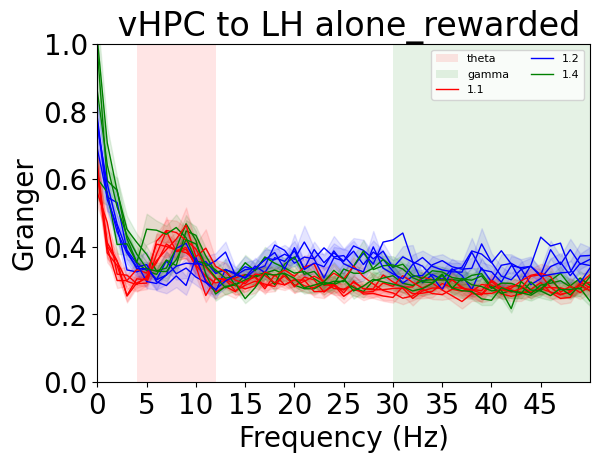

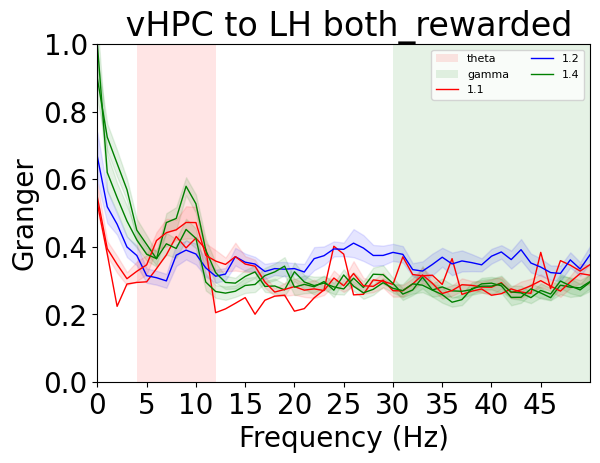

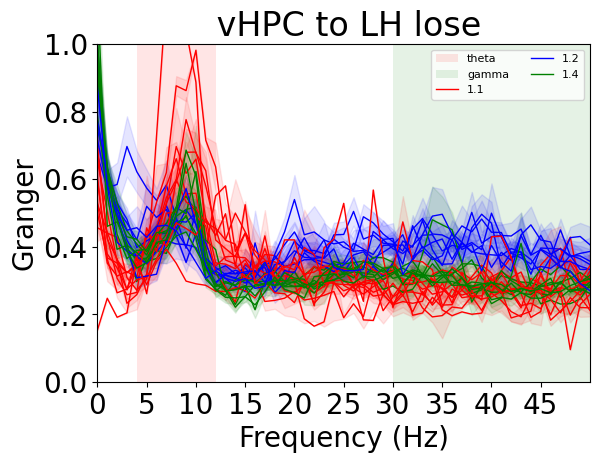

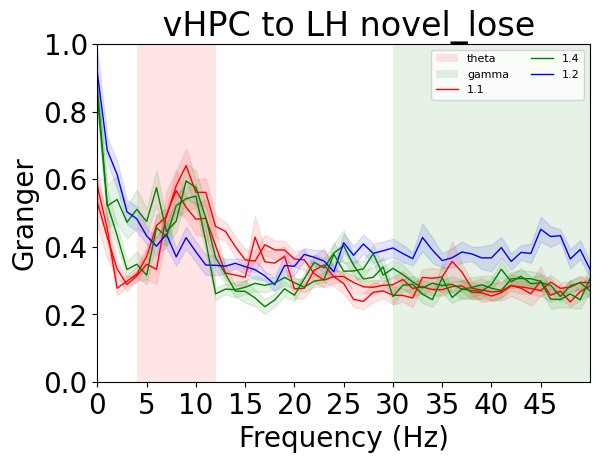

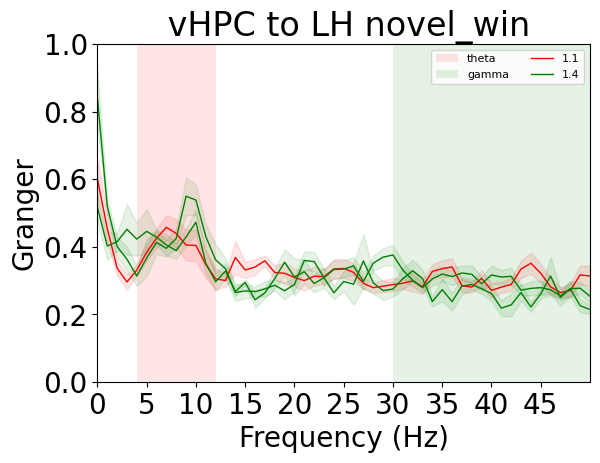

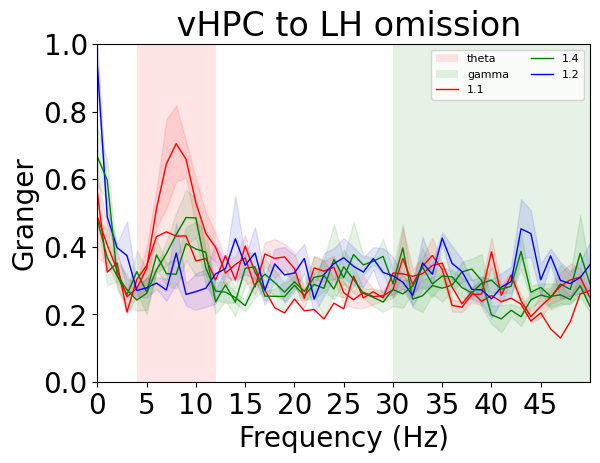

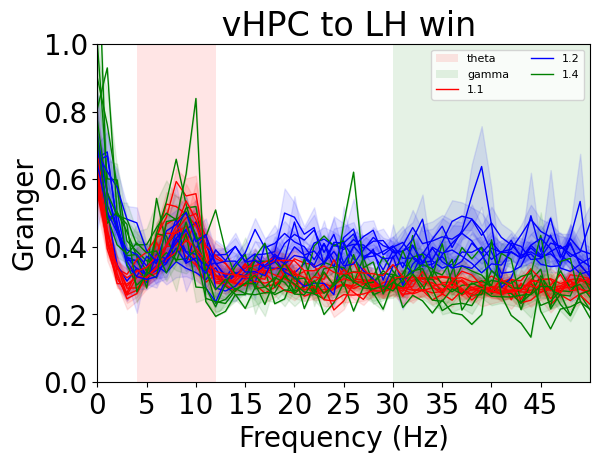

MD_RMS_filtered_power_all_frequencies


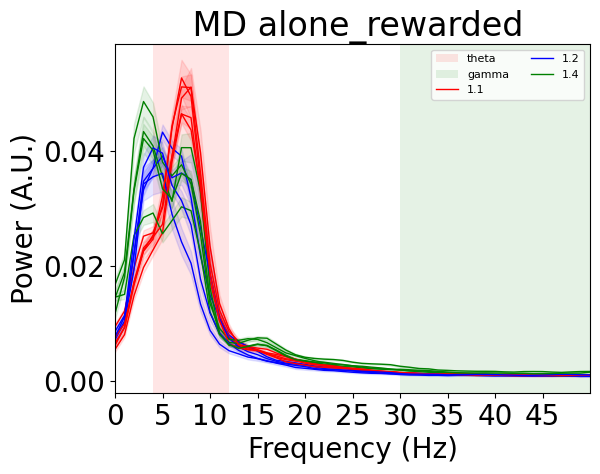

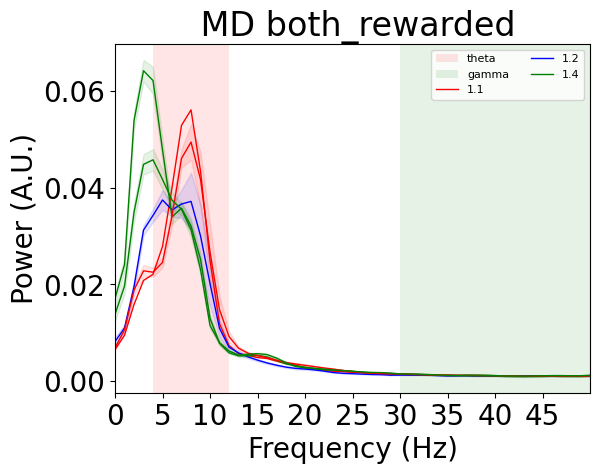

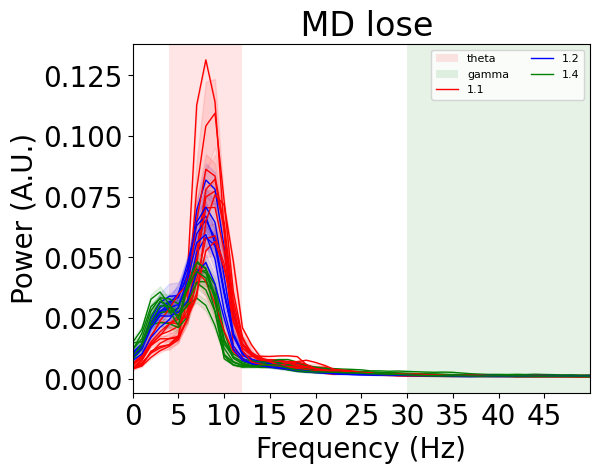

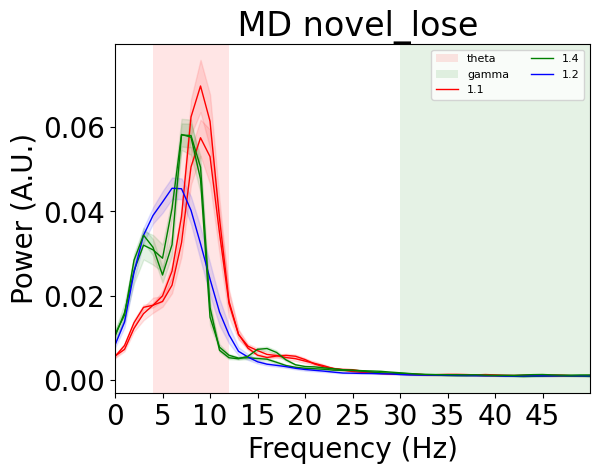

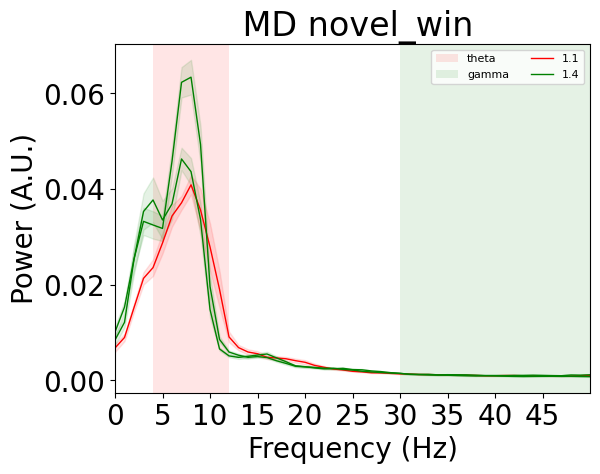

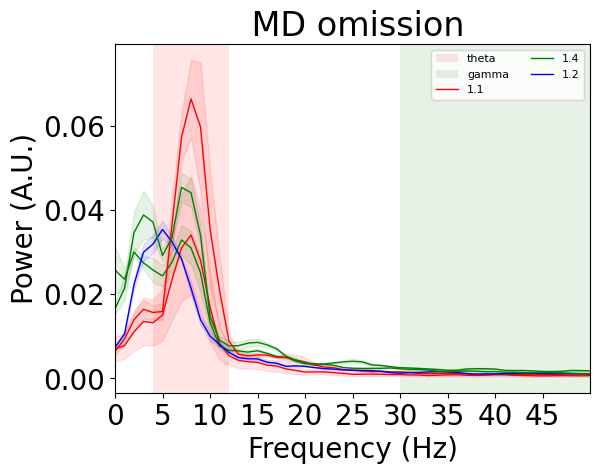

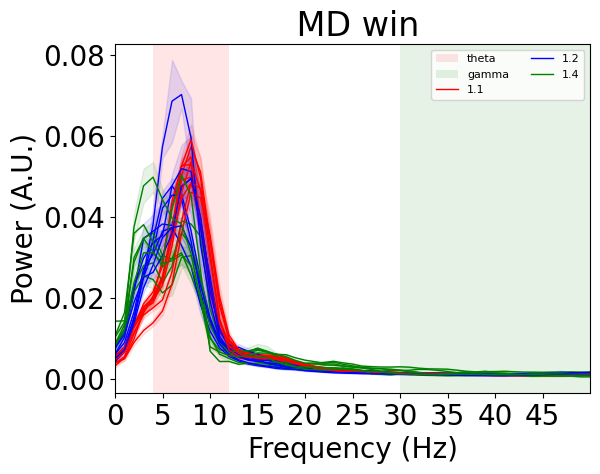

vHPC_RMS_filtered_power_all_frequencies


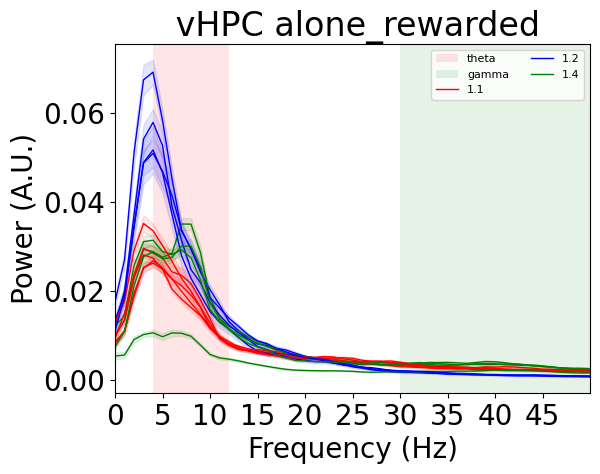

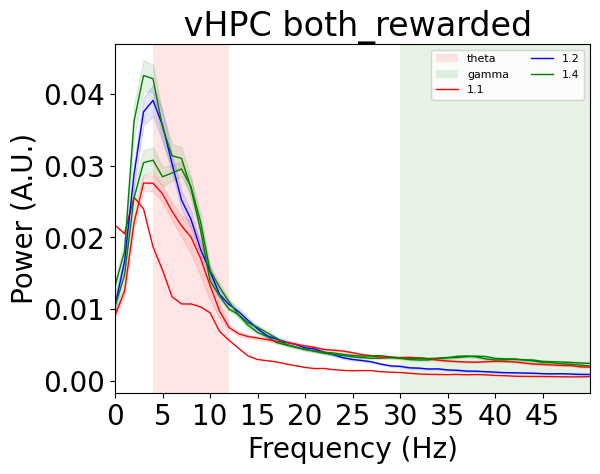

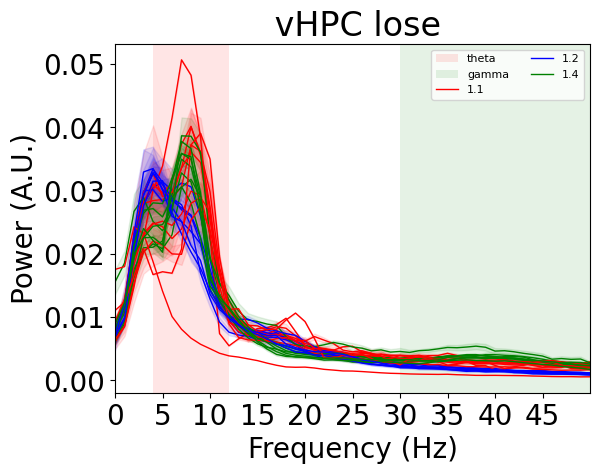

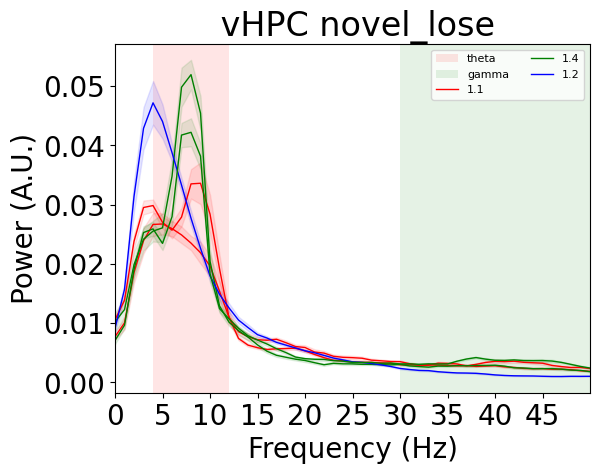

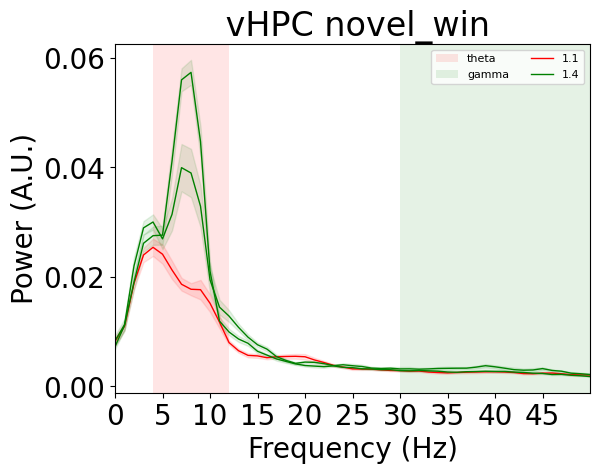

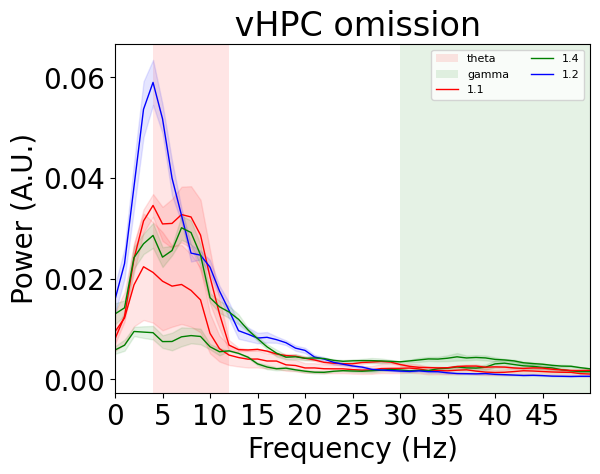

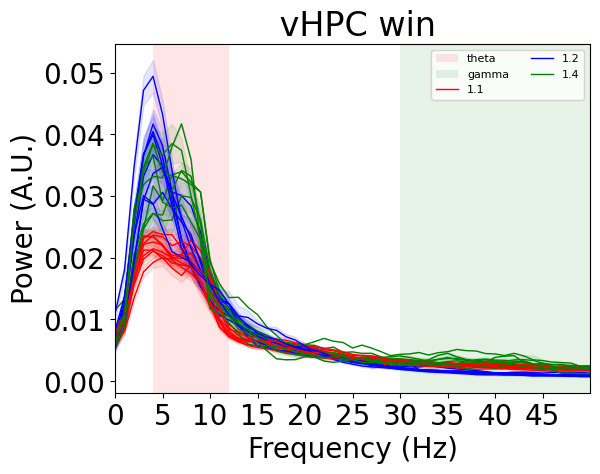

mPFC_BLA_granger_all_frequencies


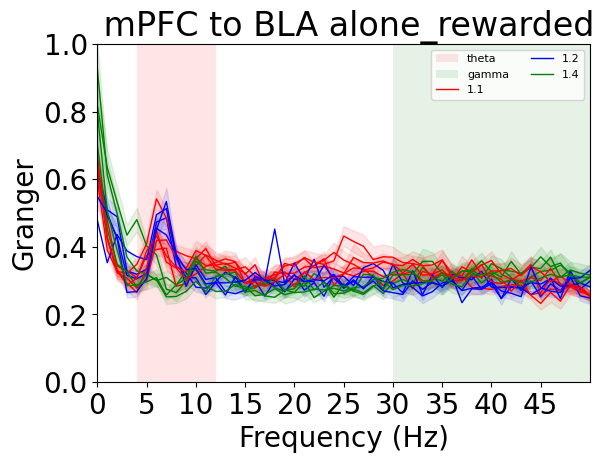

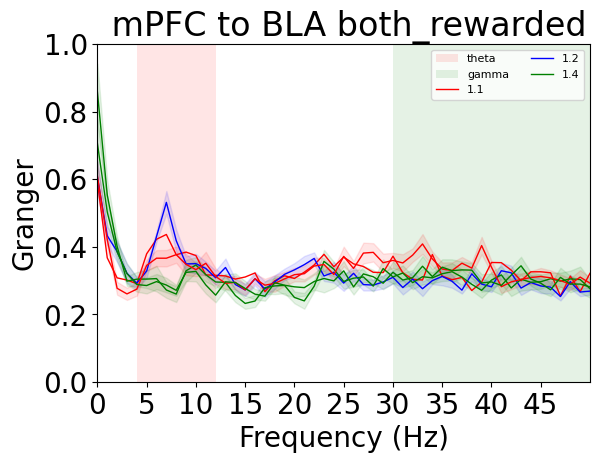

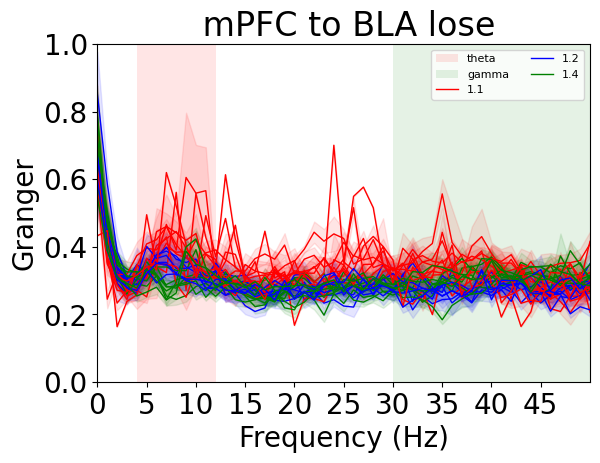

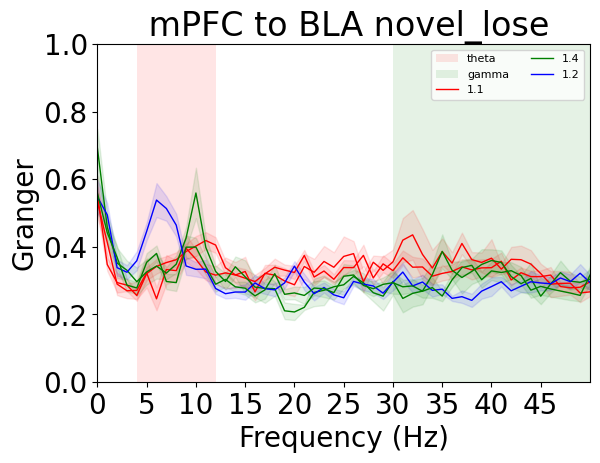

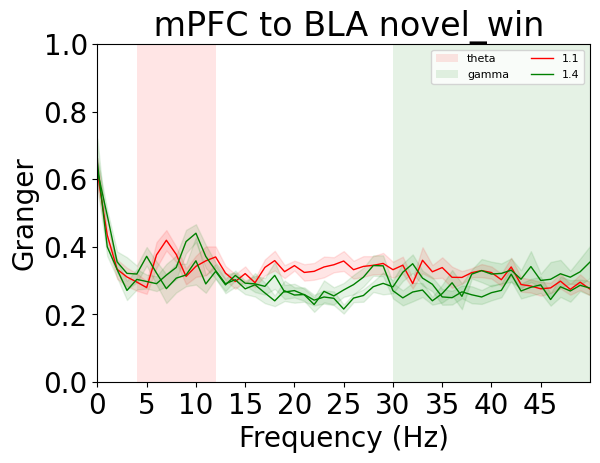

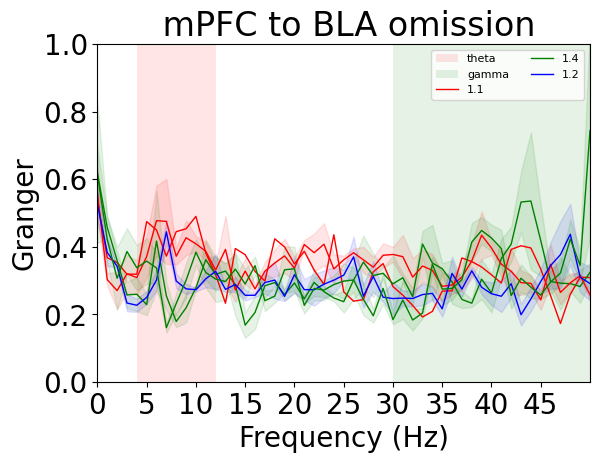

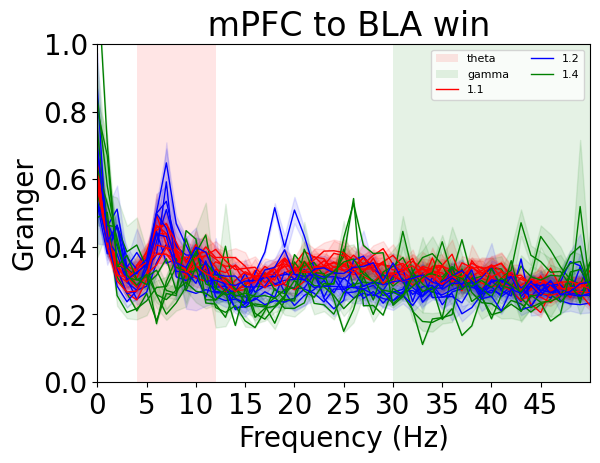

vHPC_BLA_granger_all_frequencies


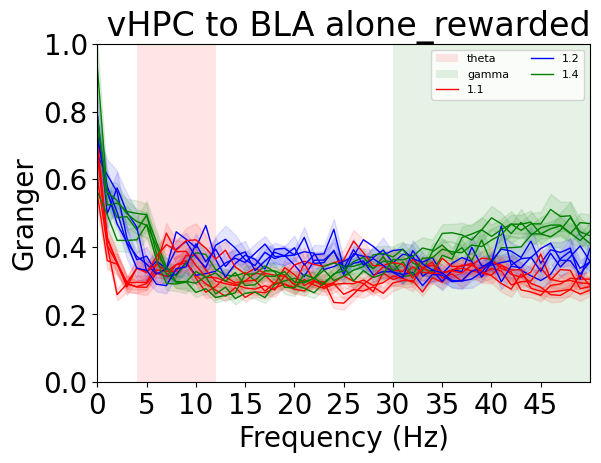

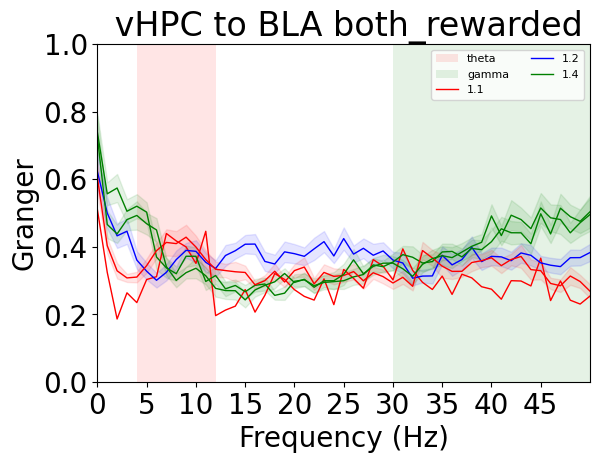

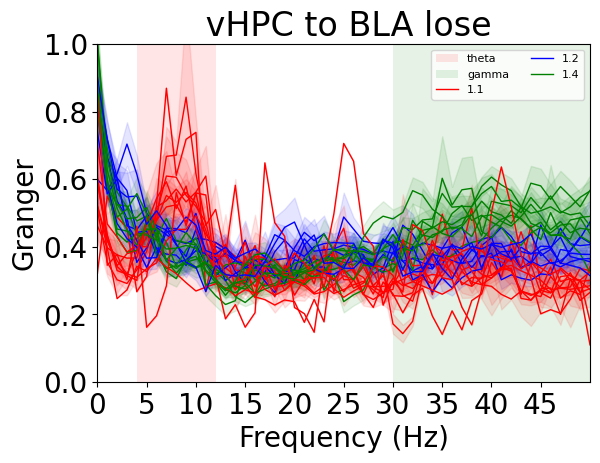

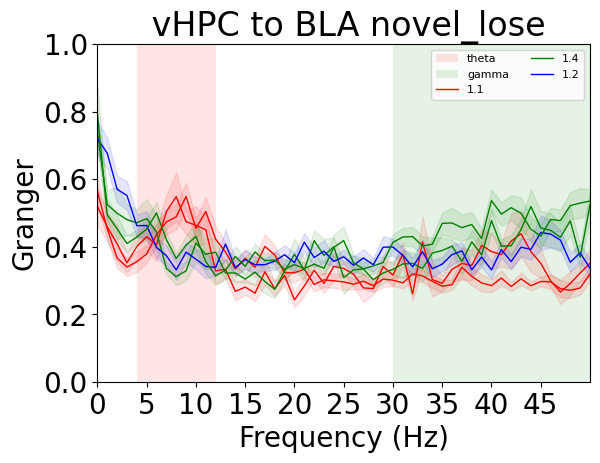

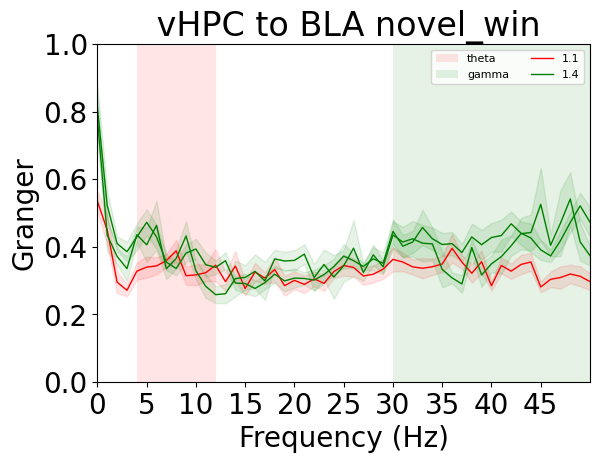

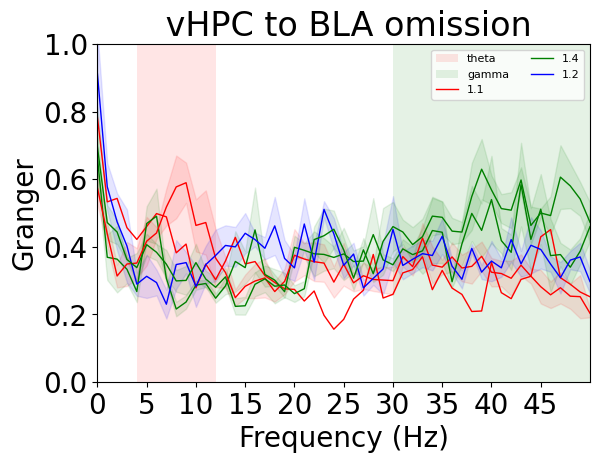

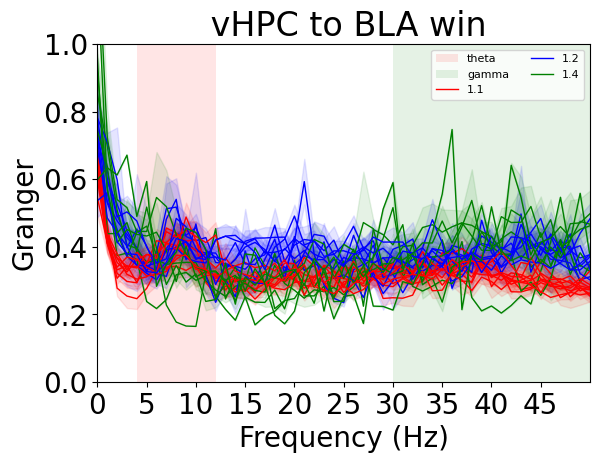

LH_vHPC_granger_all_frequencies


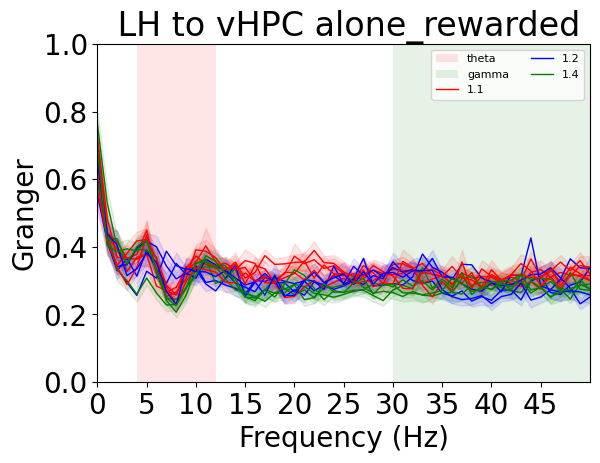

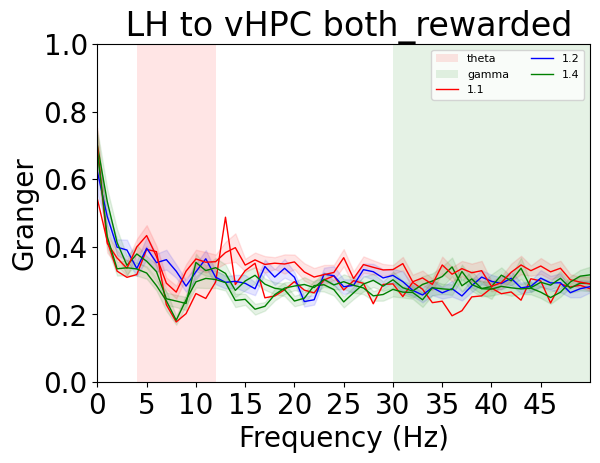

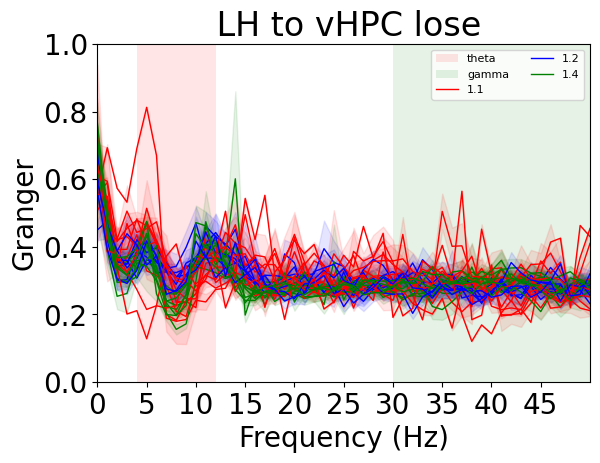

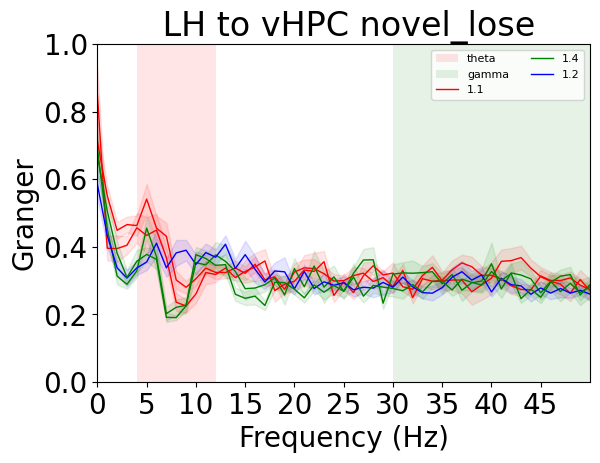

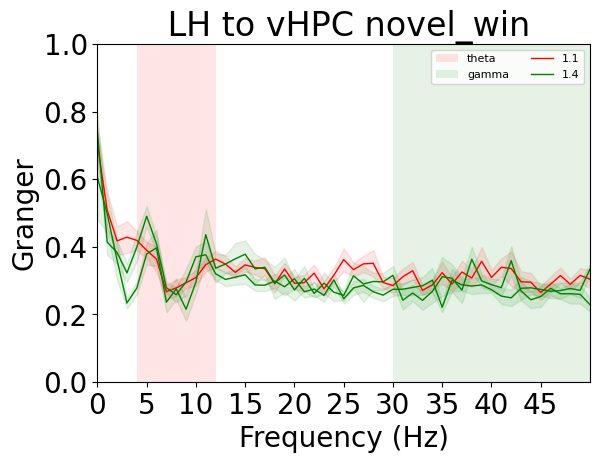

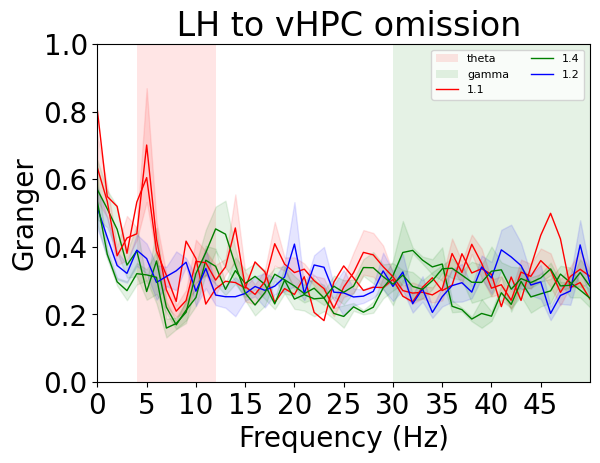

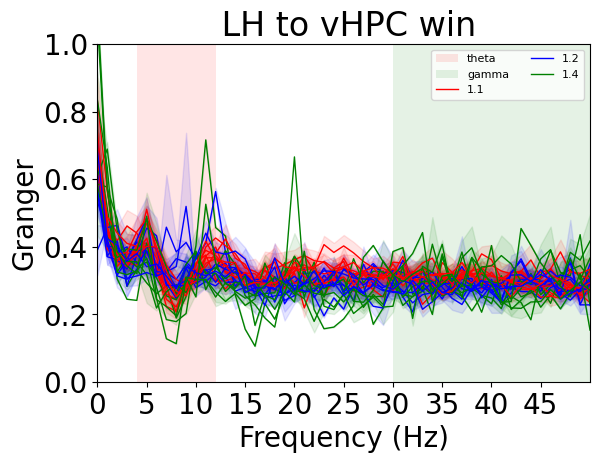

LH_MD_RMS_filtered_coherence_all_frequencies


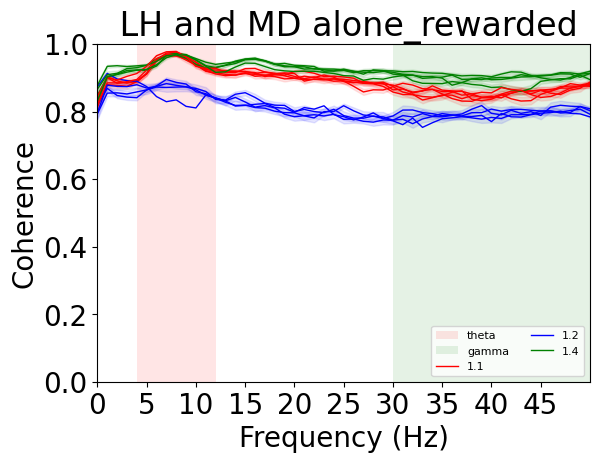

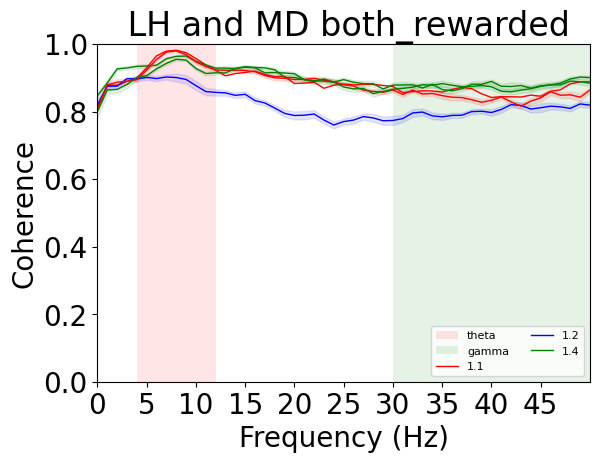

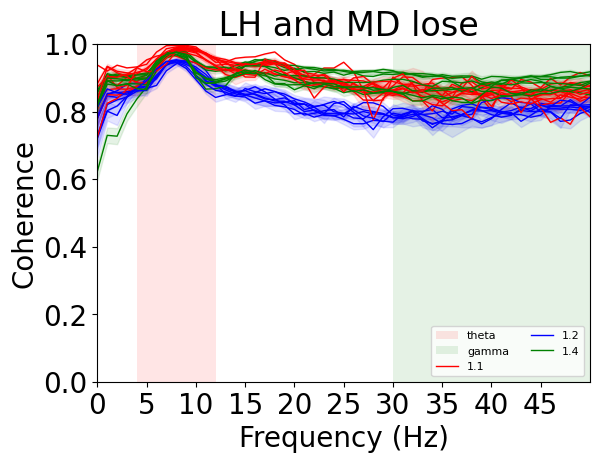

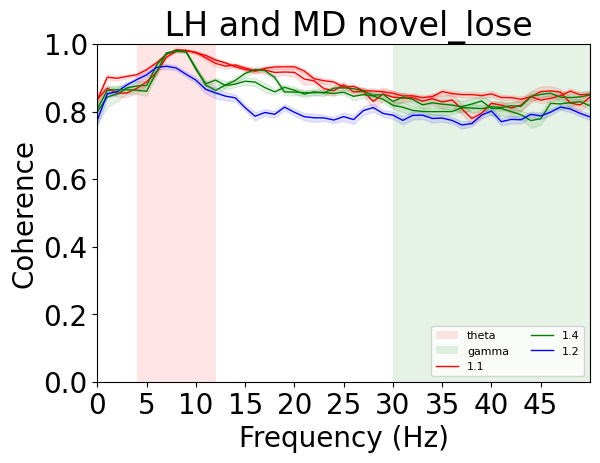

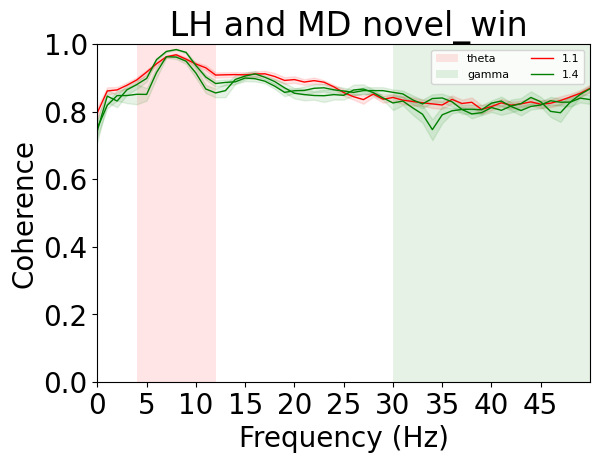

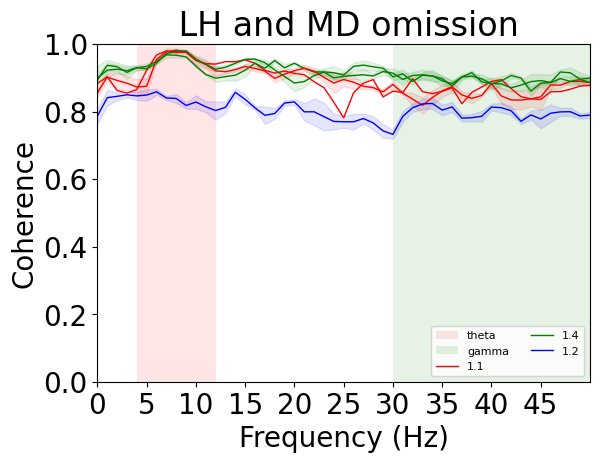

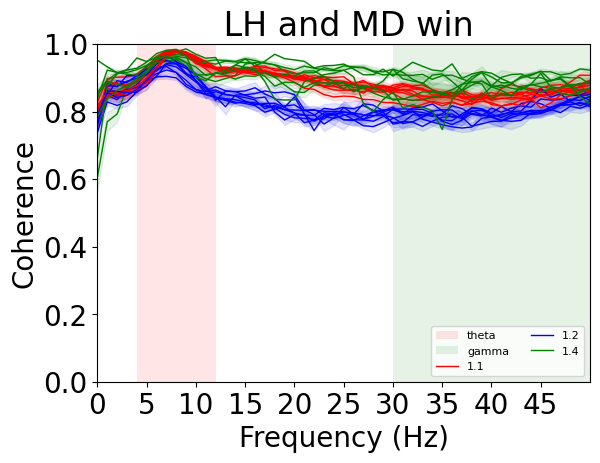

mPFC_LH_granger_all_frequencies


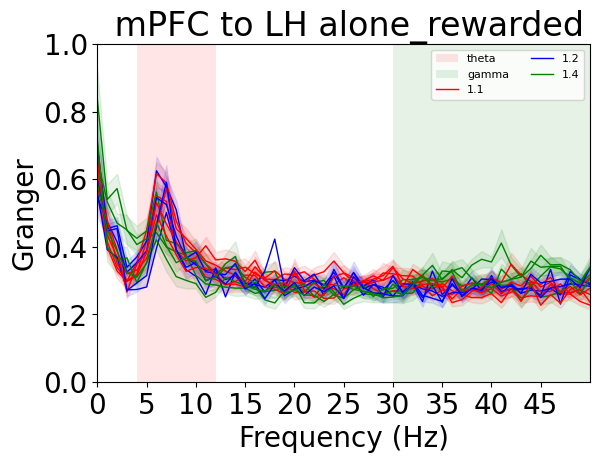

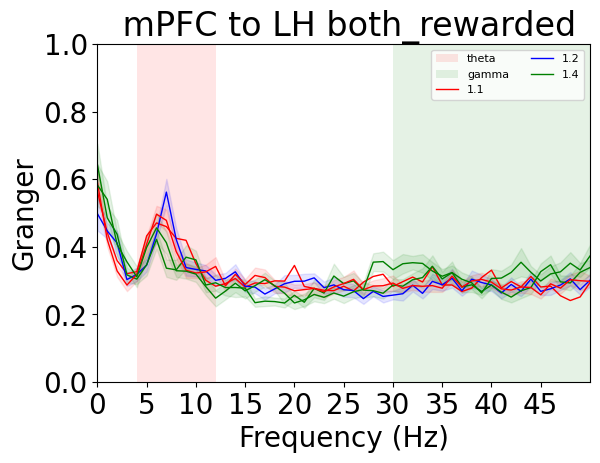

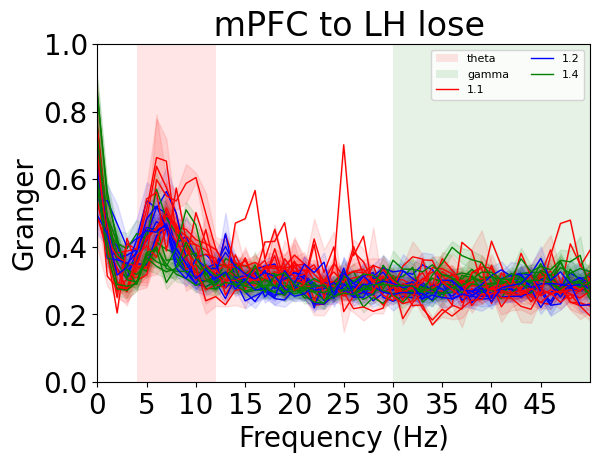

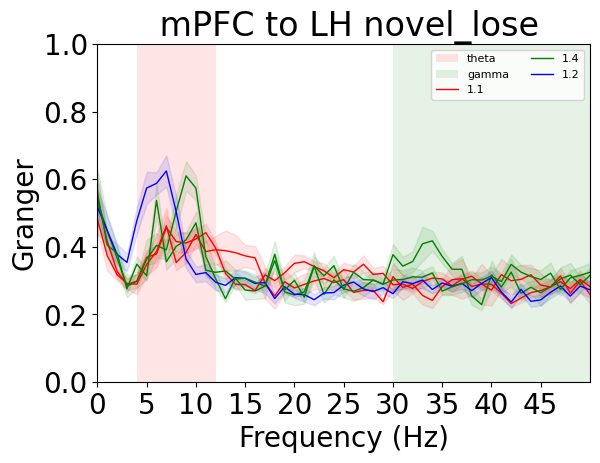

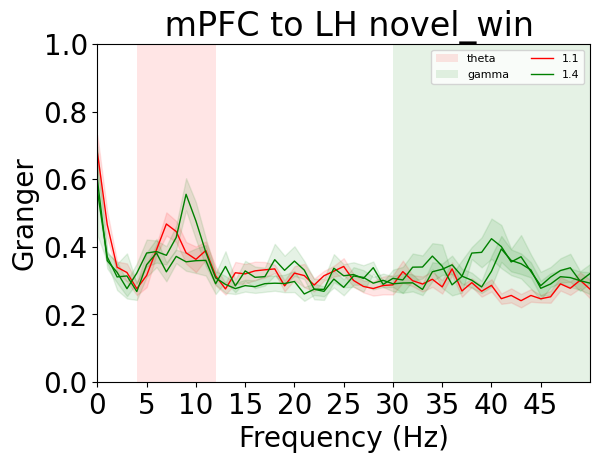

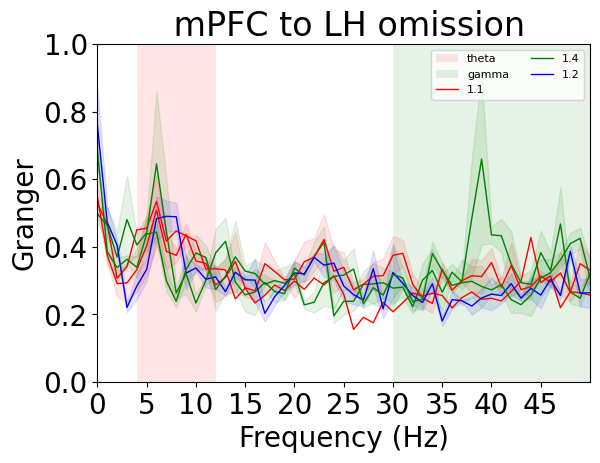

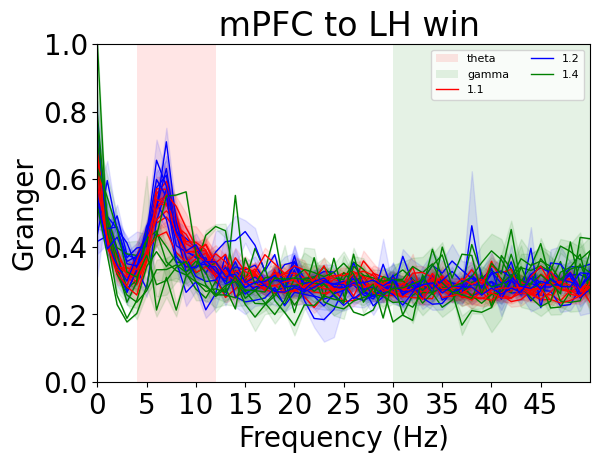

LH_MD_granger_all_frequencies


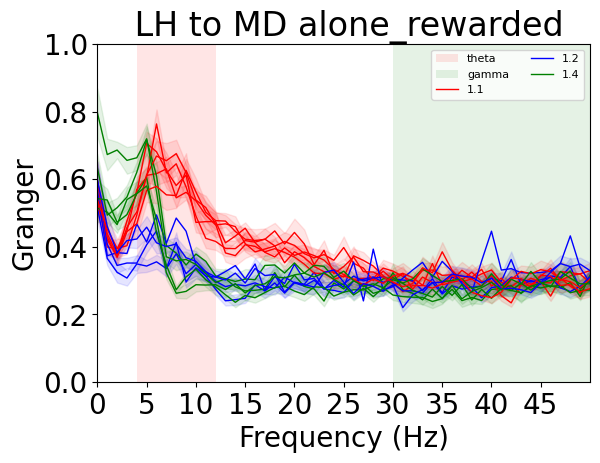

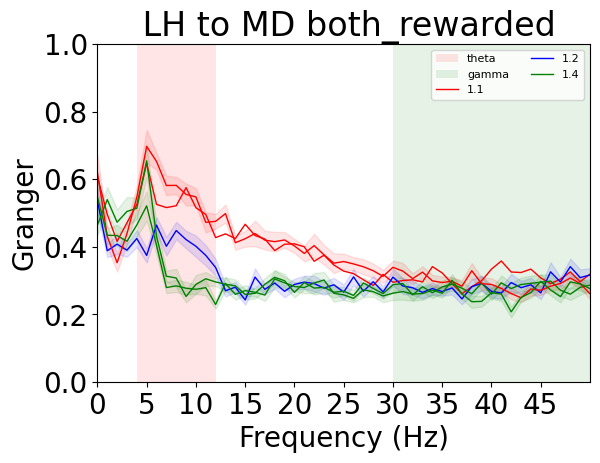

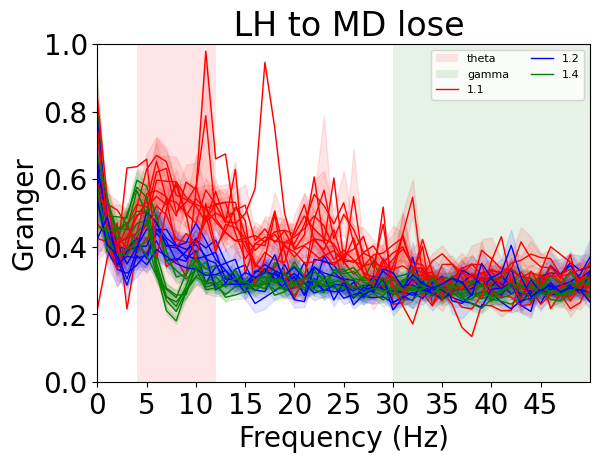

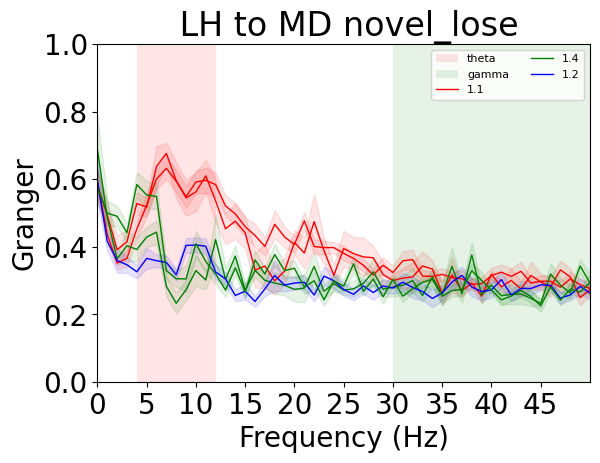

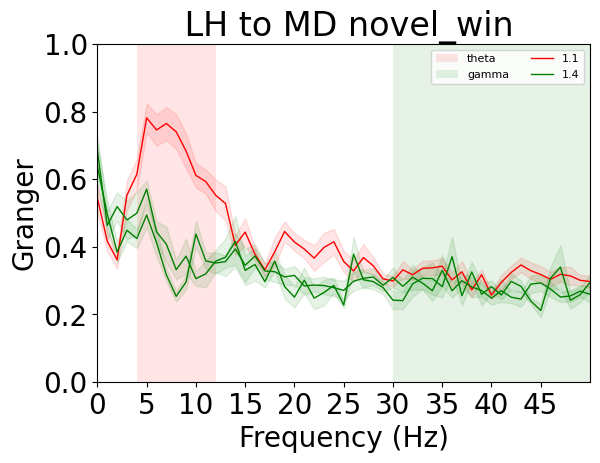

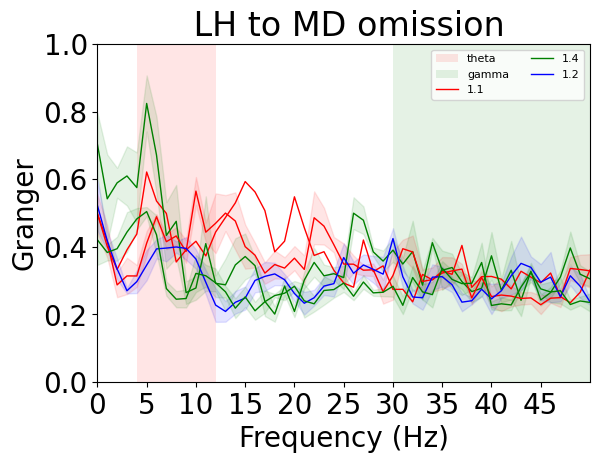

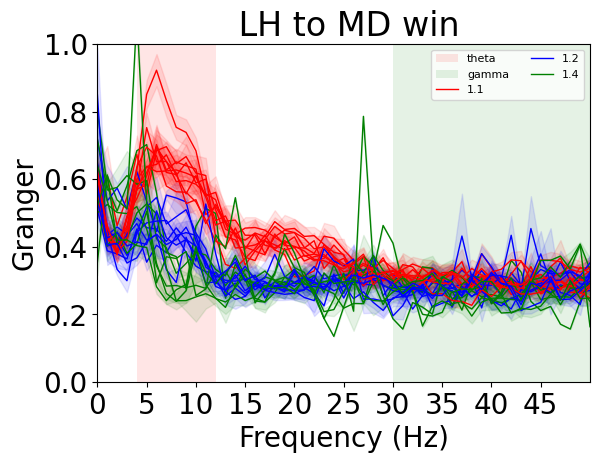

BLA_RMS_filtered_power_all_frequencies


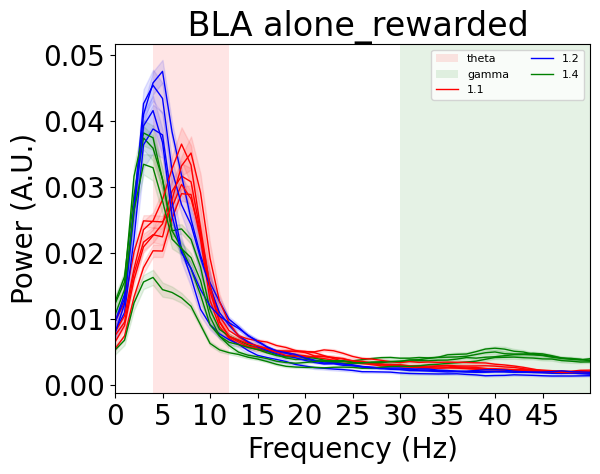

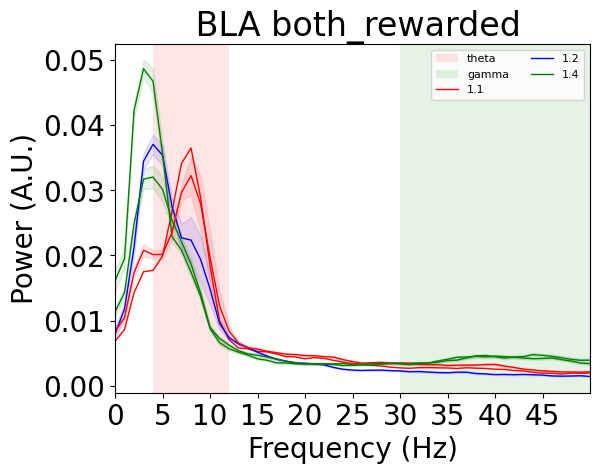

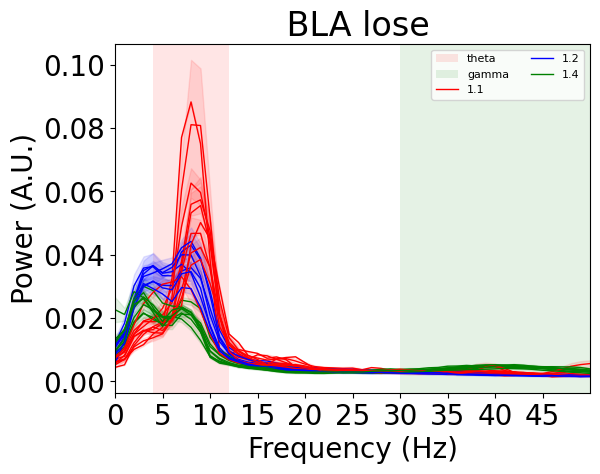

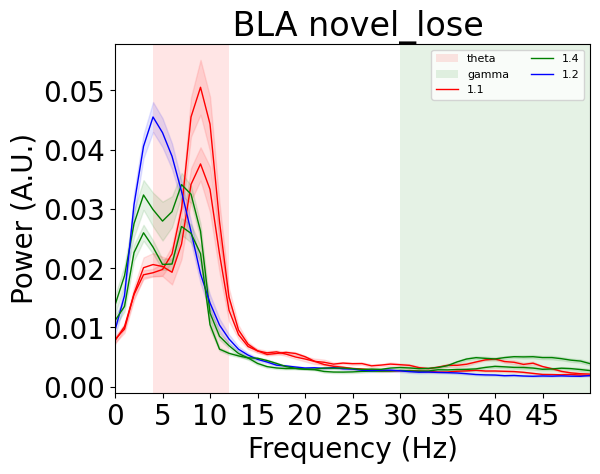

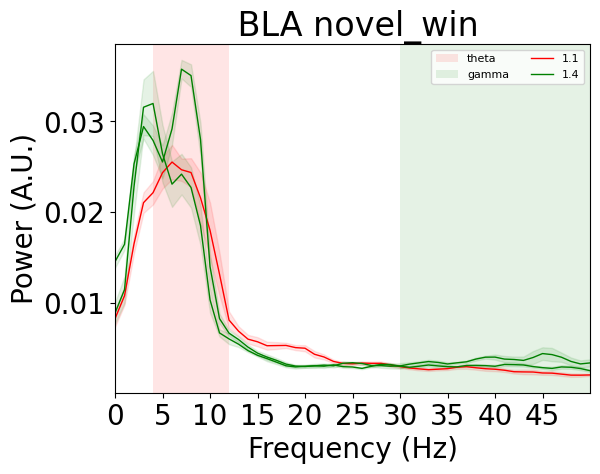

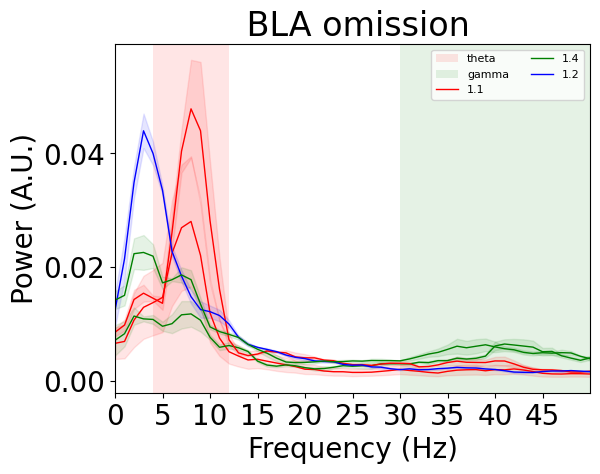

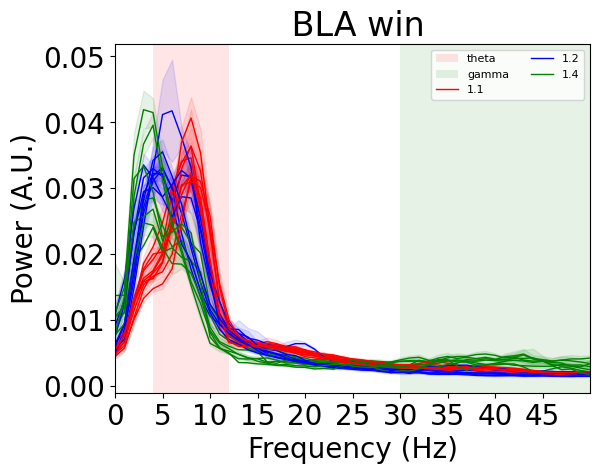

BLA_MD_granger_all_frequencies


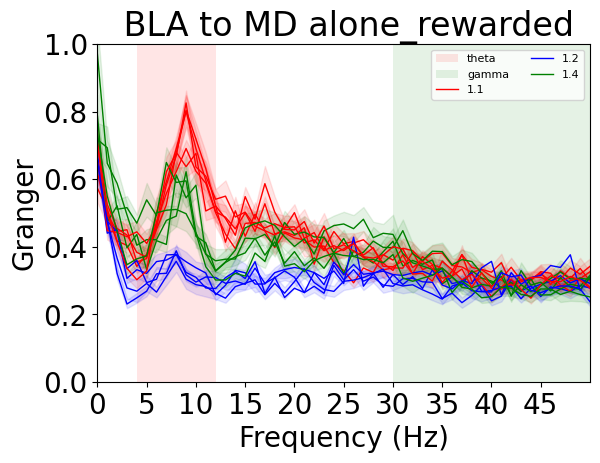

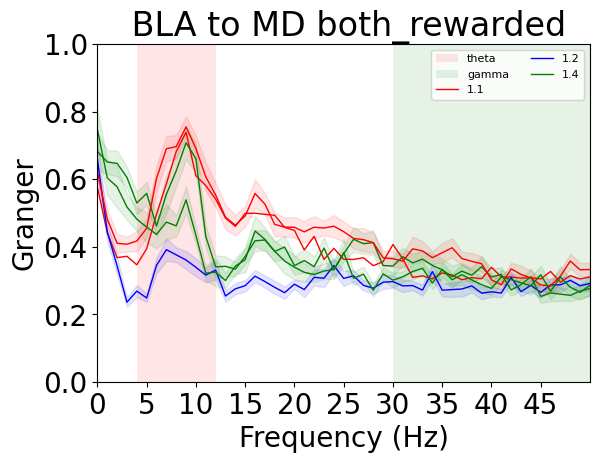

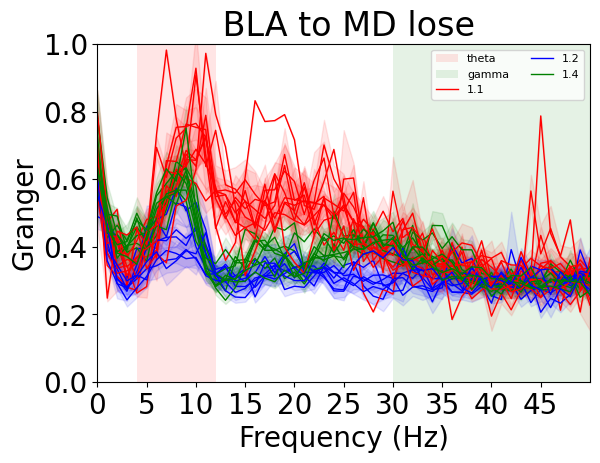

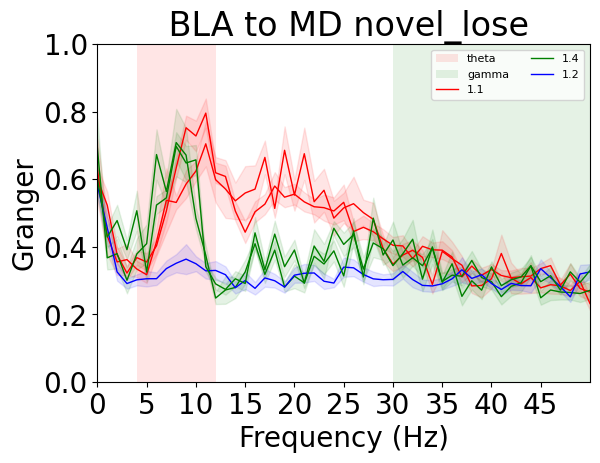

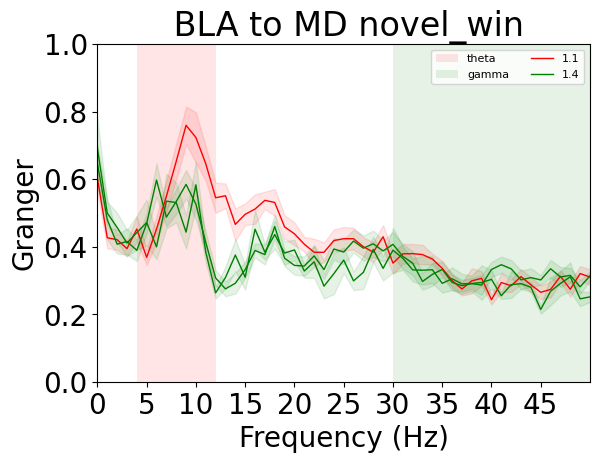

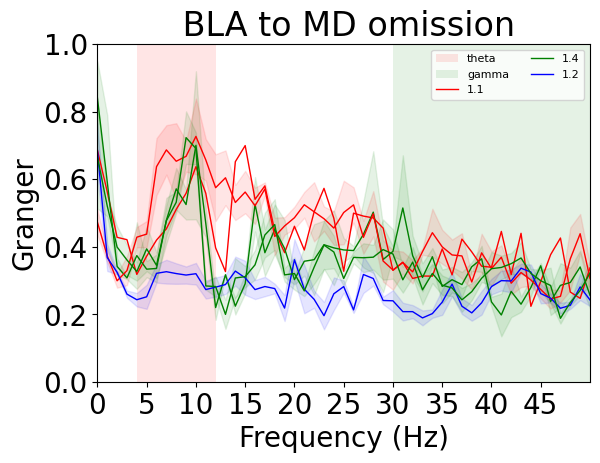

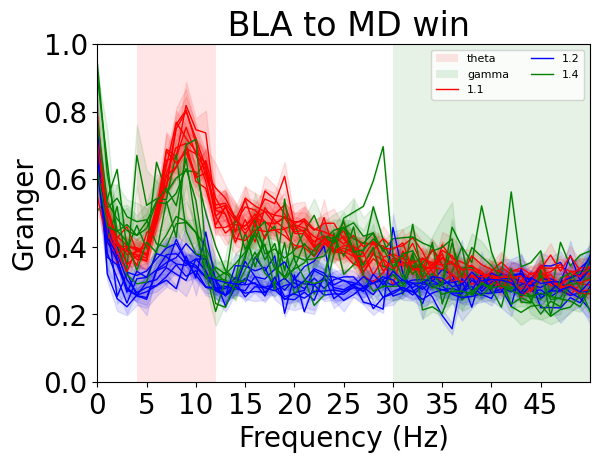

LH_mPFC_granger_all_frequencies


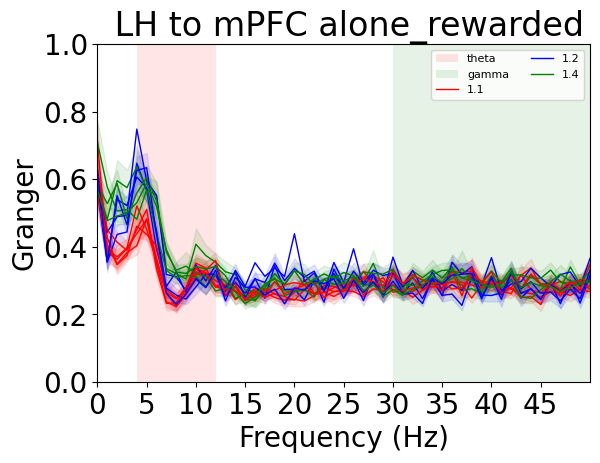

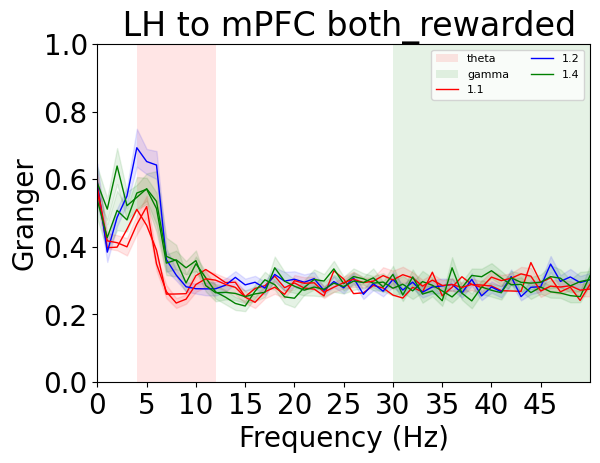

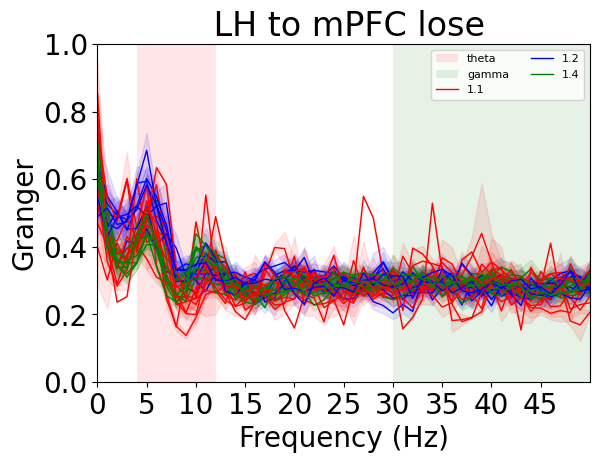

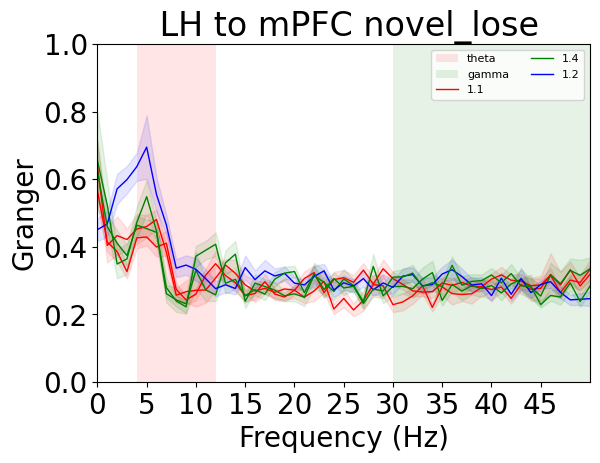

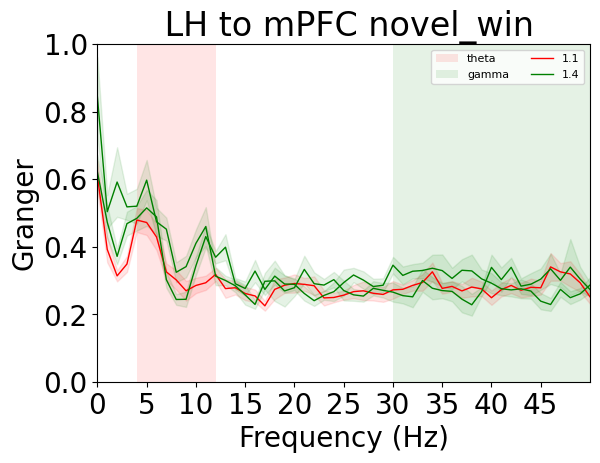

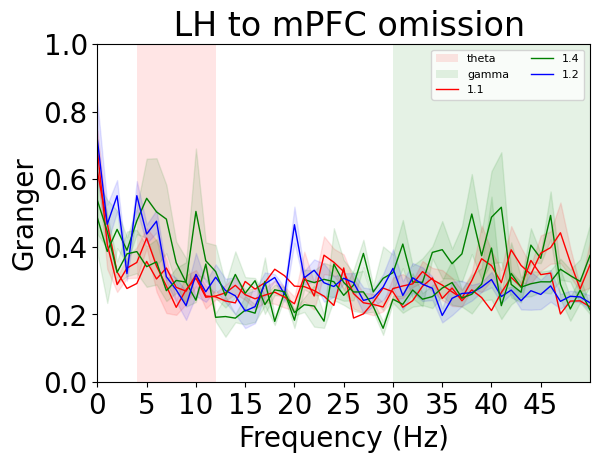

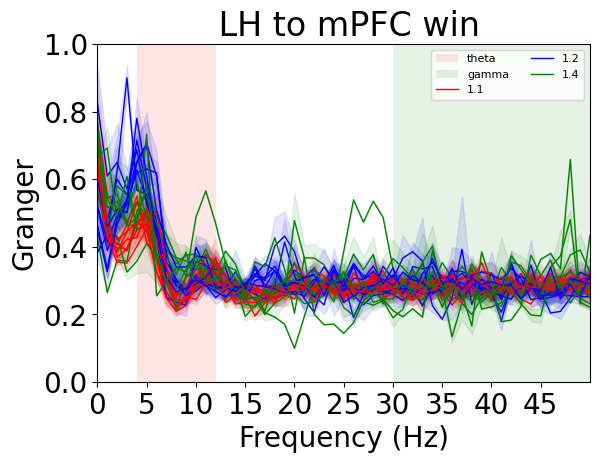

mPFC_RMS_filtered_power_all_frequencies


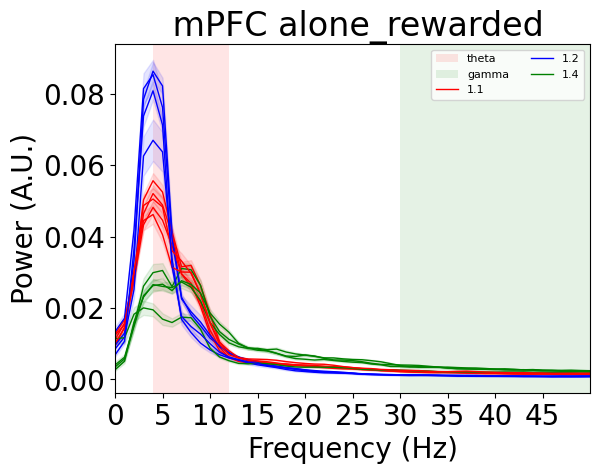

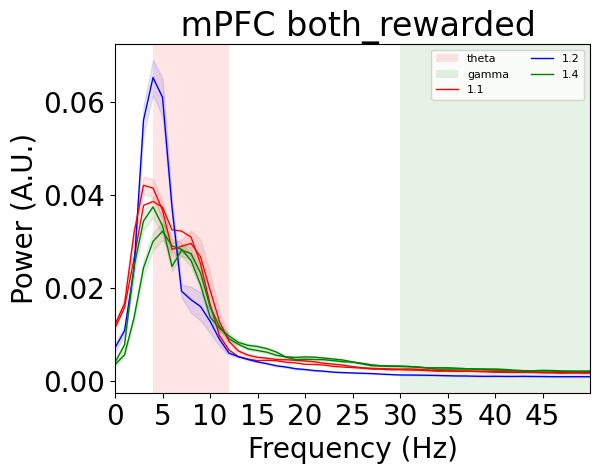

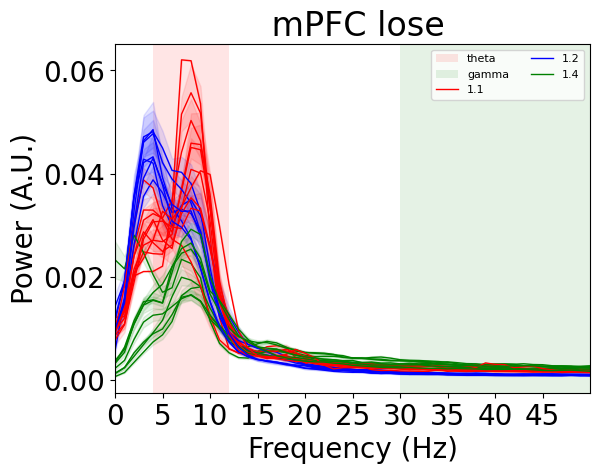

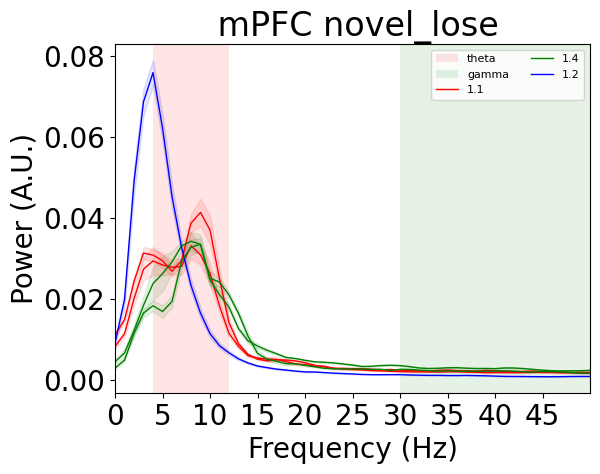

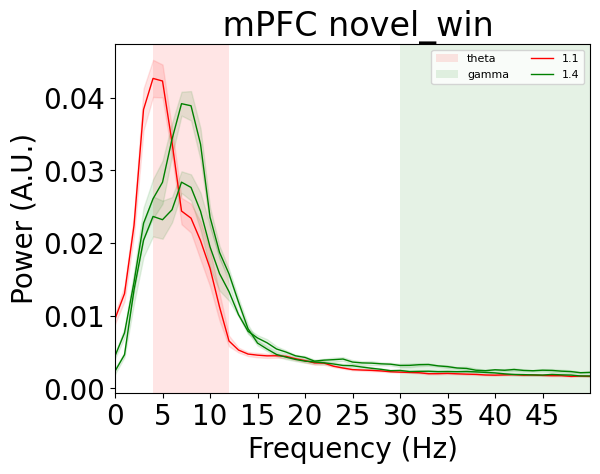

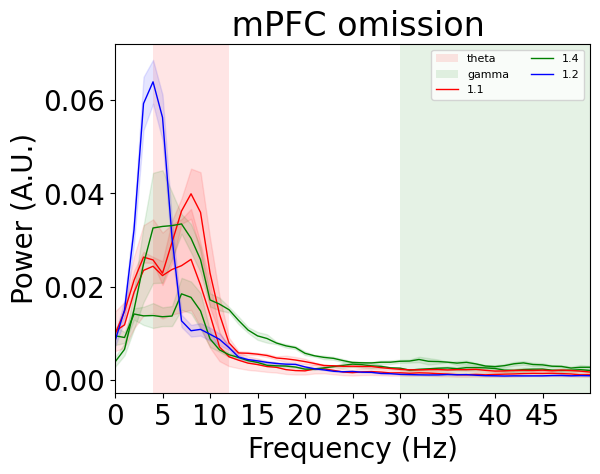

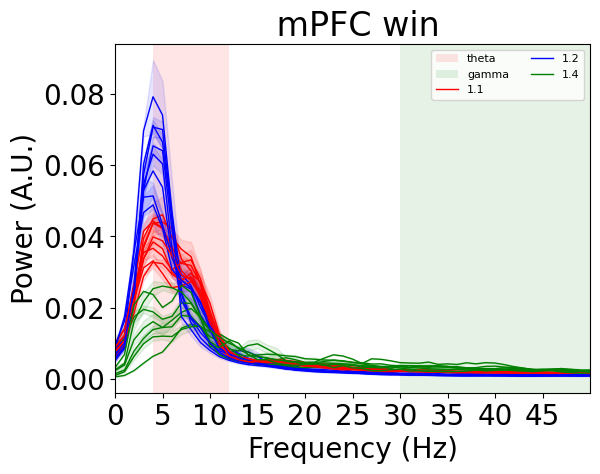

LH_BLA_granger_all_frequencies


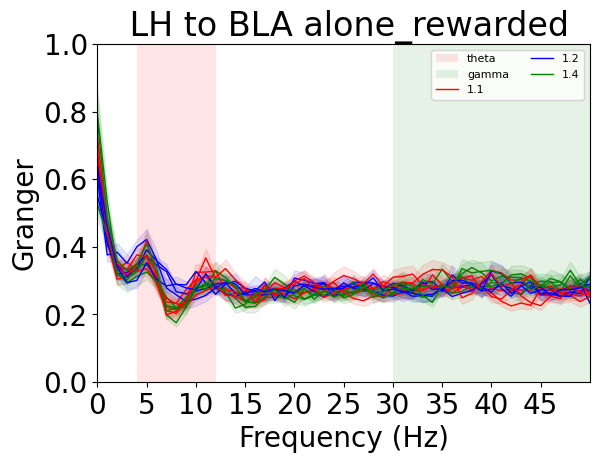

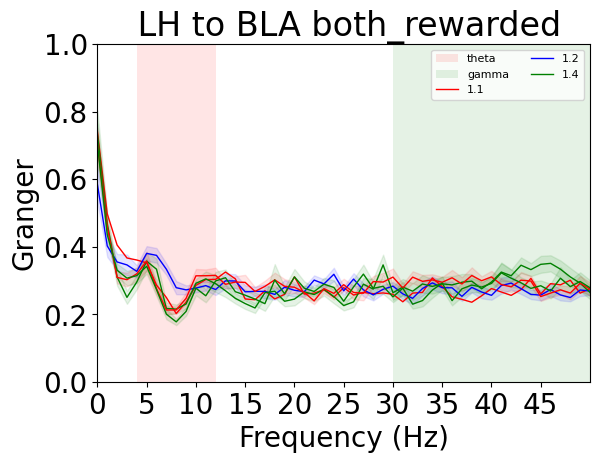

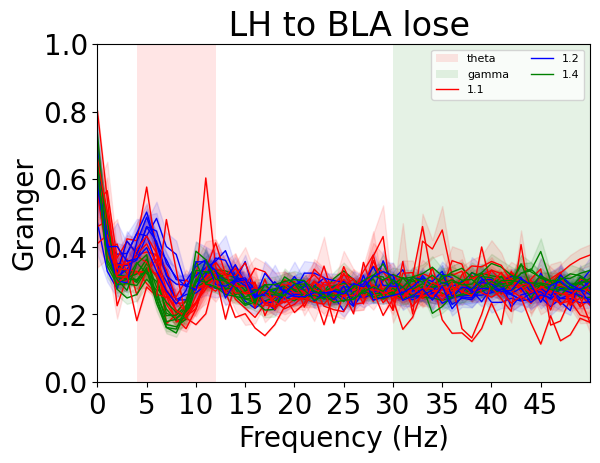

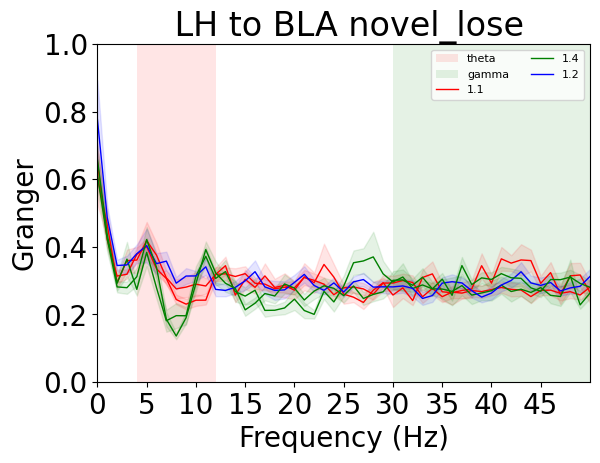

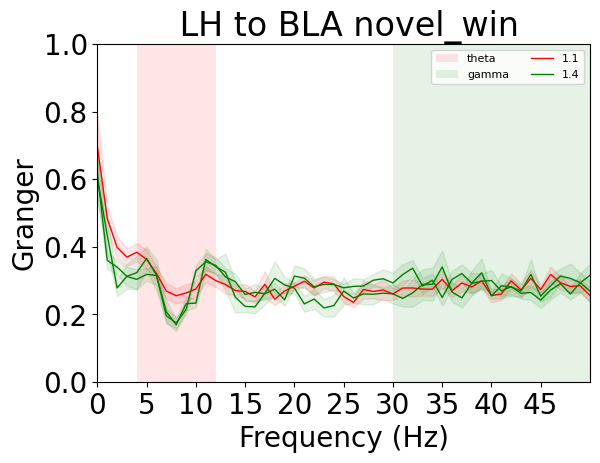

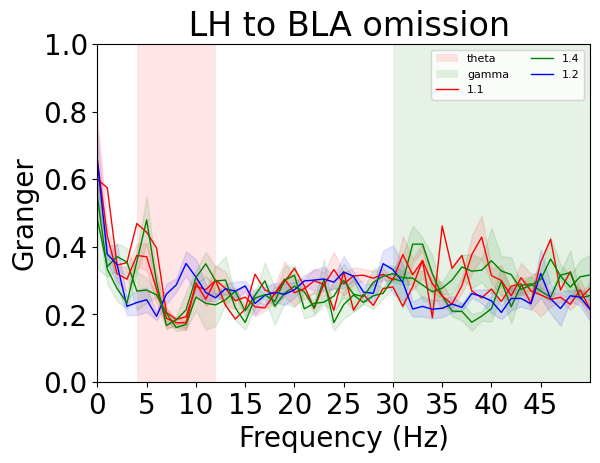

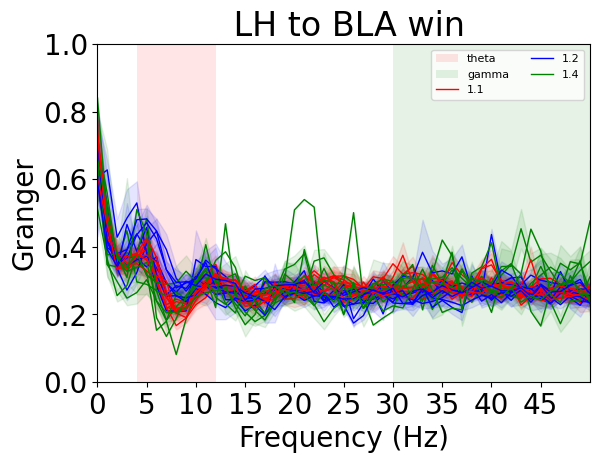

LH_mPFC_RMS_filtered_coherence_all_frequencies


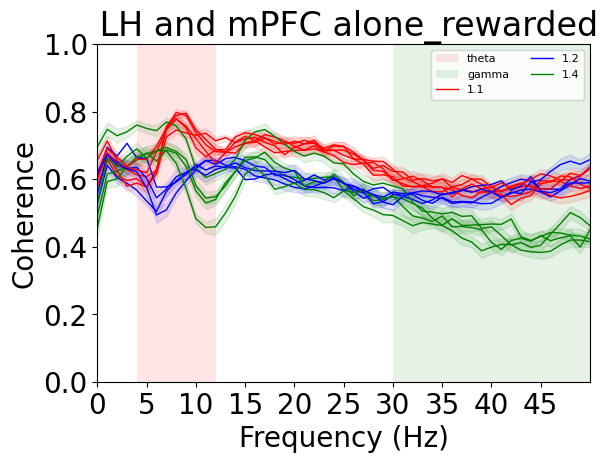

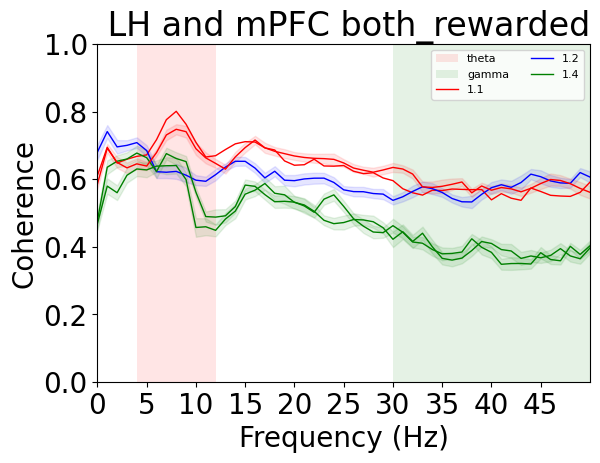

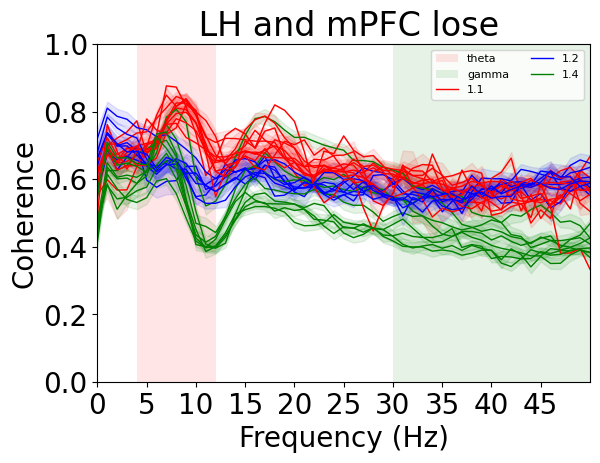

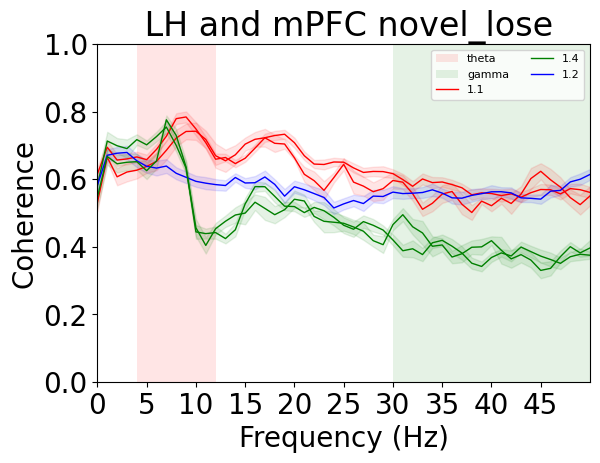

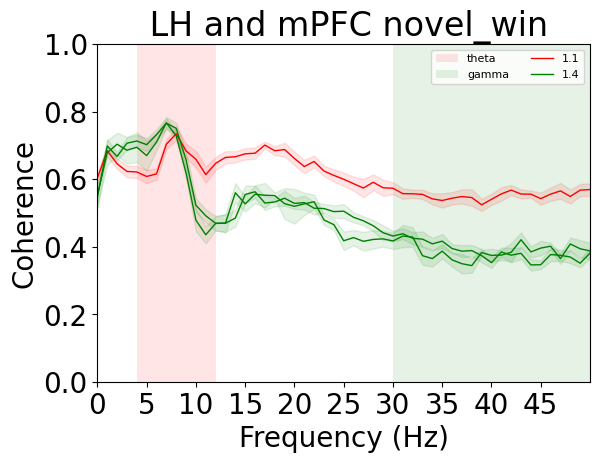

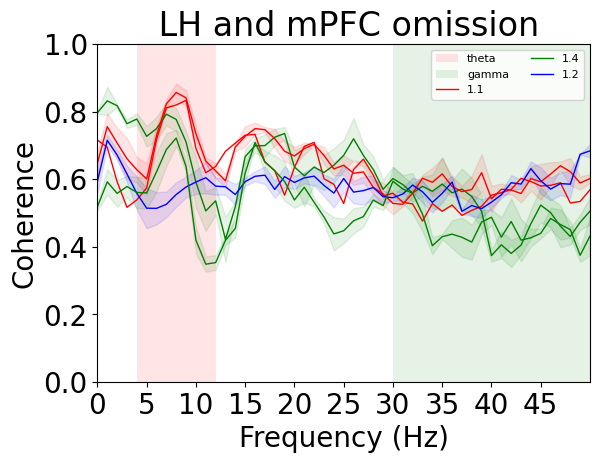

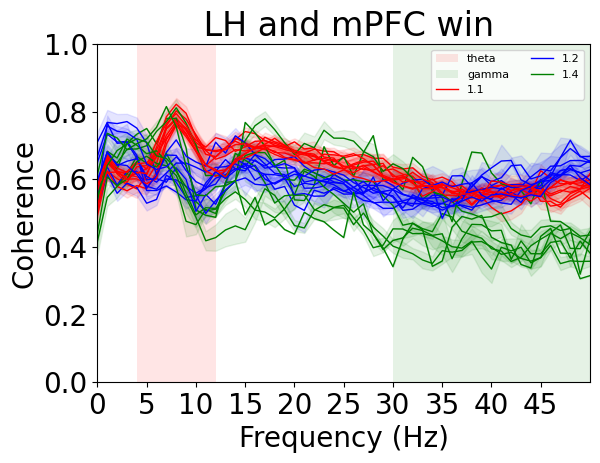

mPFC_vHPC_granger_all_frequencies


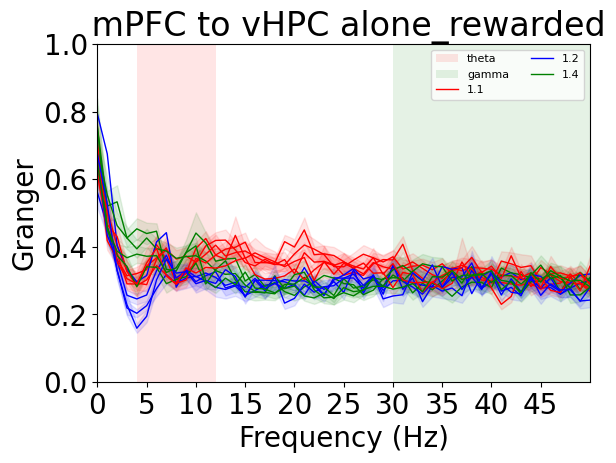

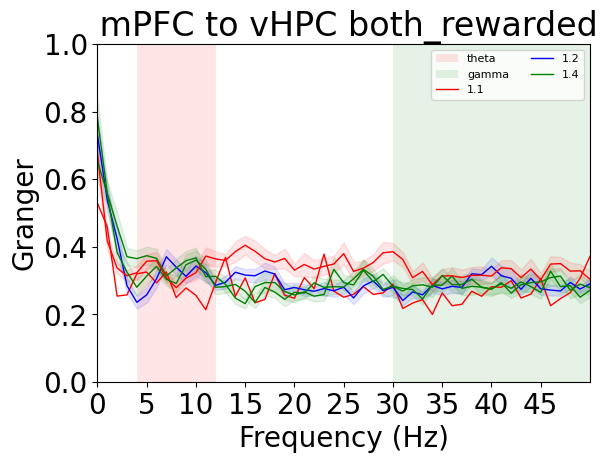

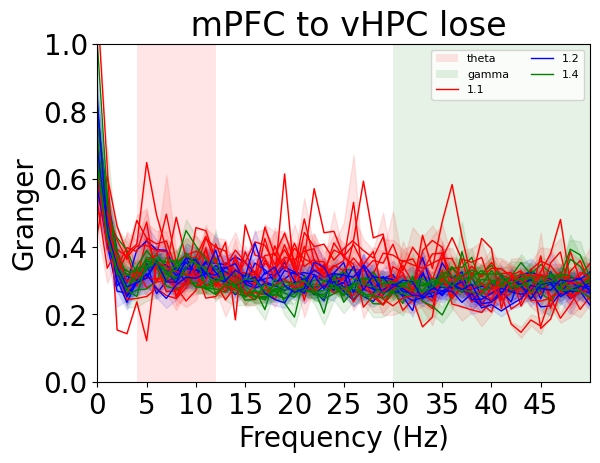

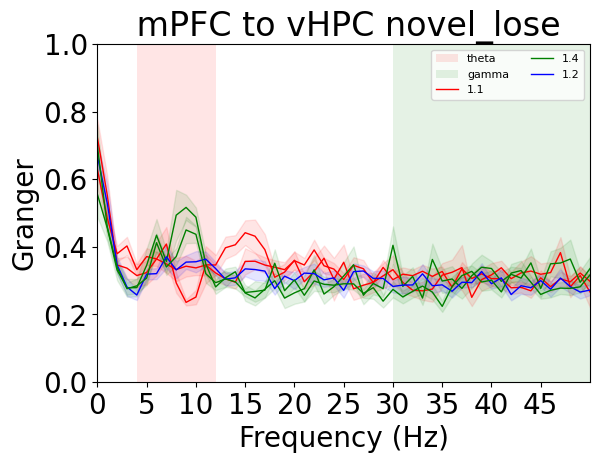

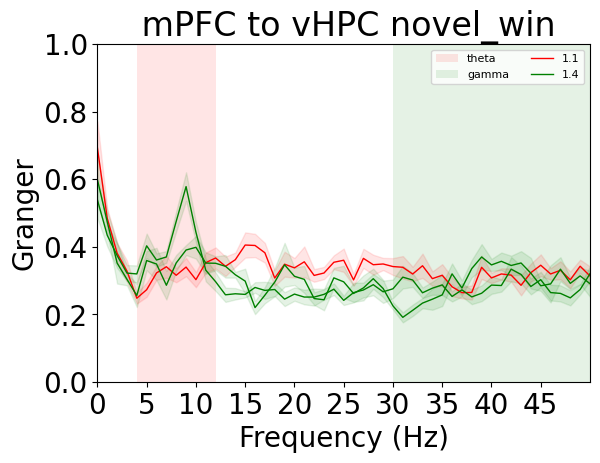

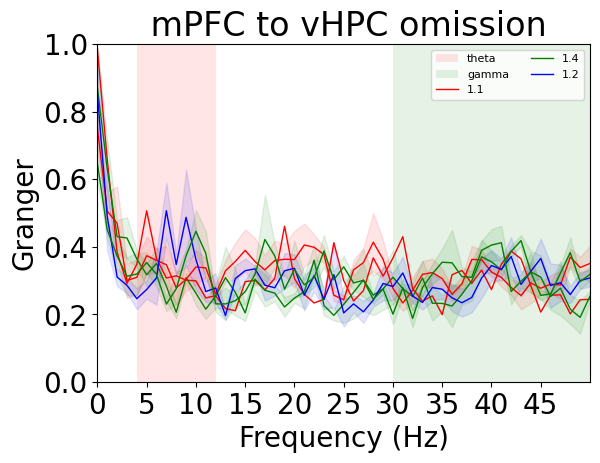

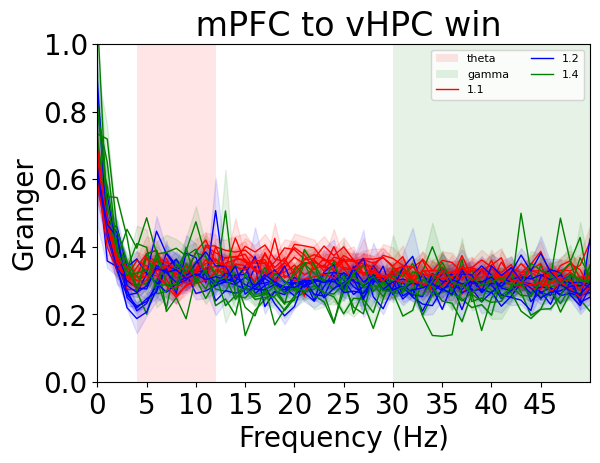

BLA_MD_RMS_filtered_coherence_all_frequencies


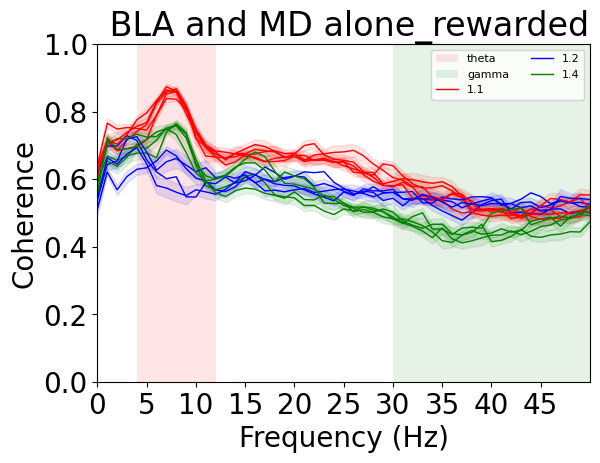

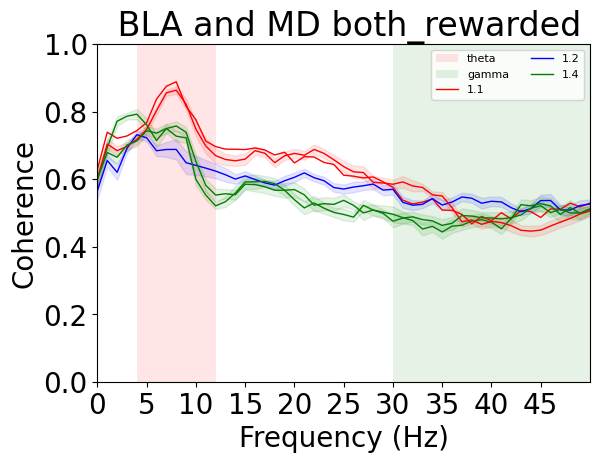

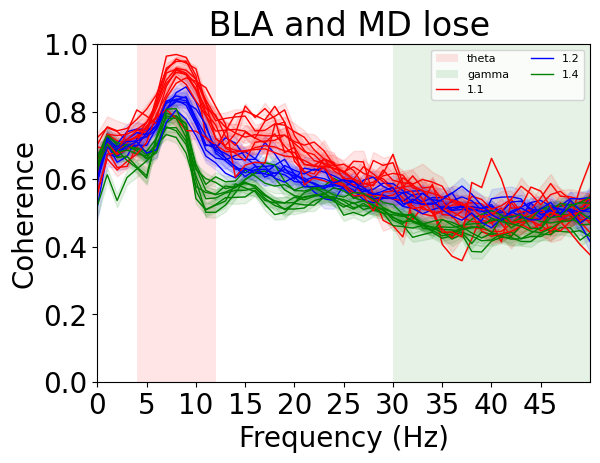

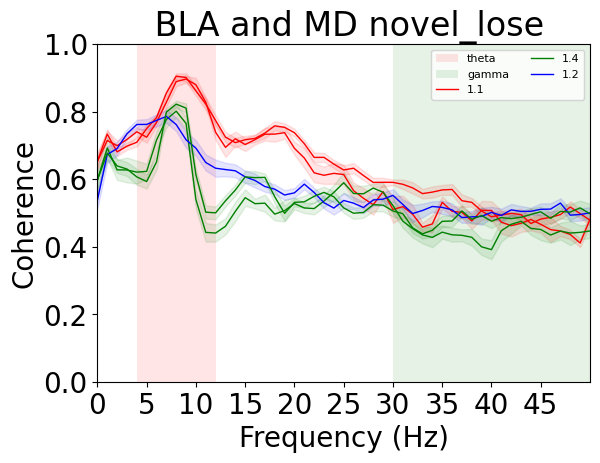

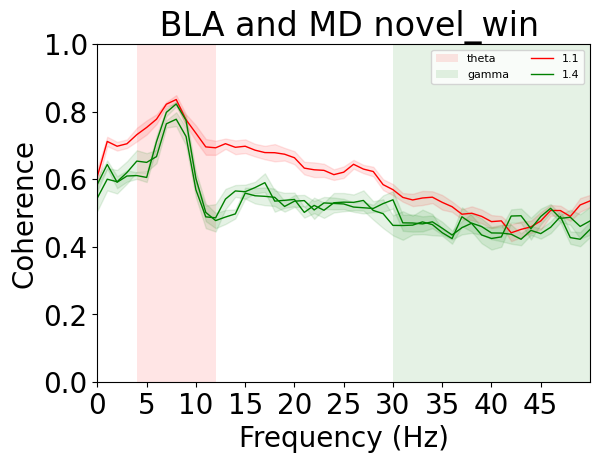

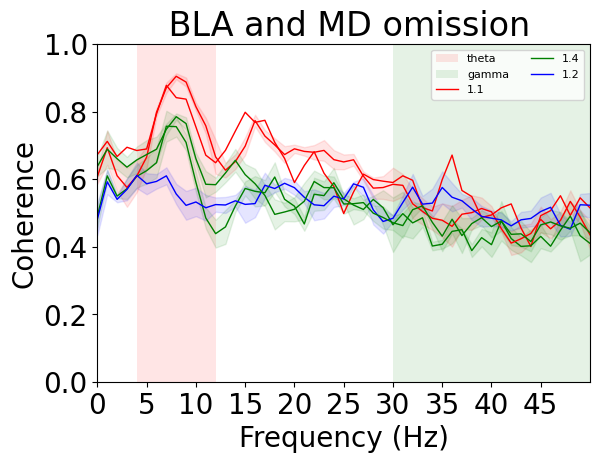

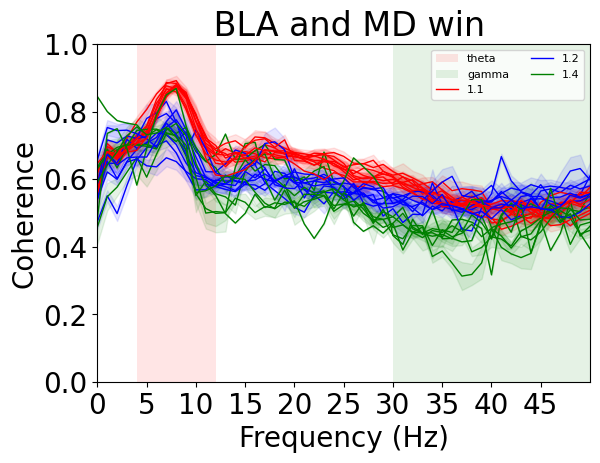

vHPC_mPFC_granger_all_frequencies


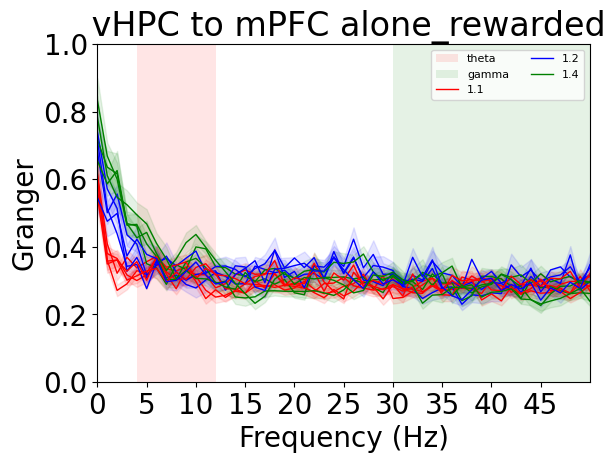

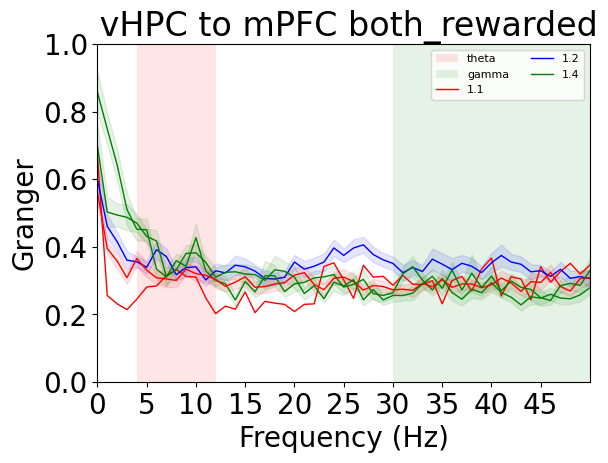

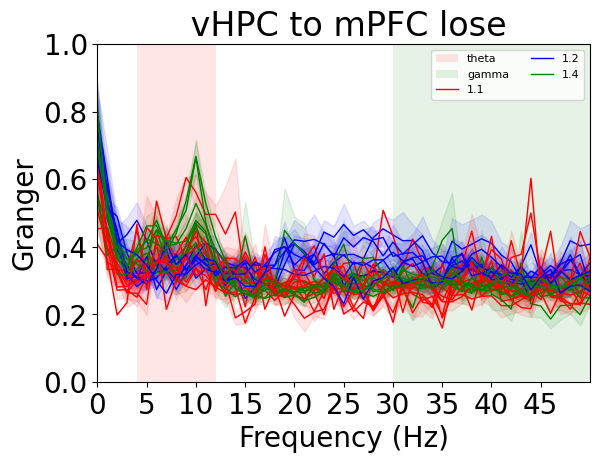

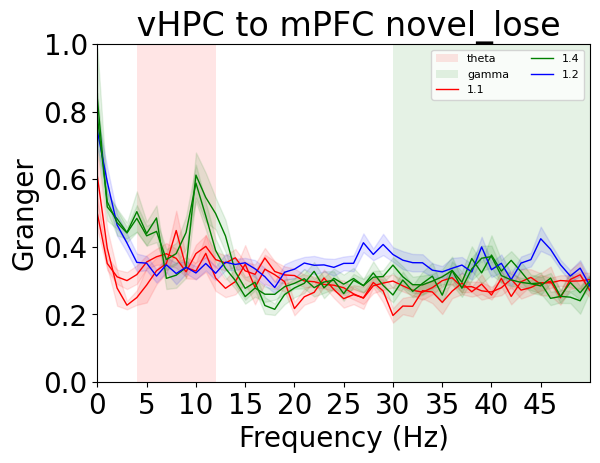

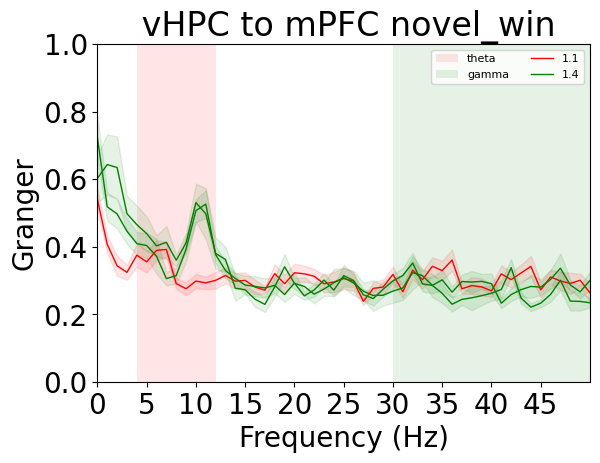

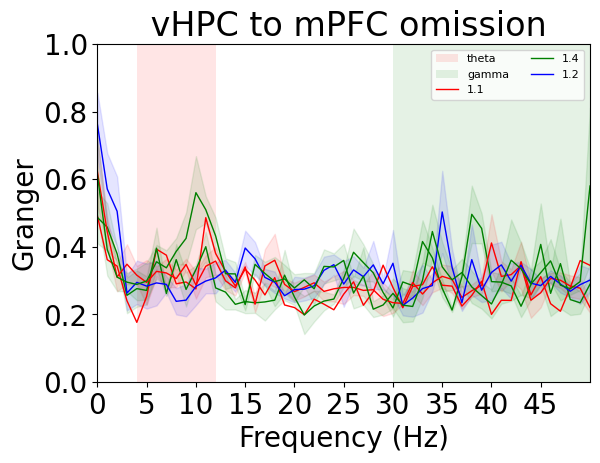

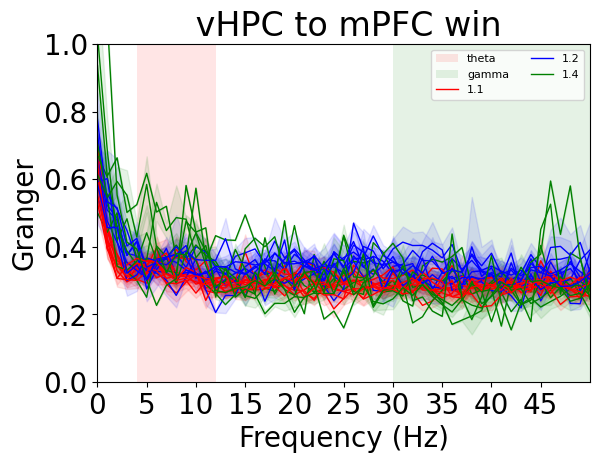

BLA_LH_RMS_filtered_coherence_all_frequencies


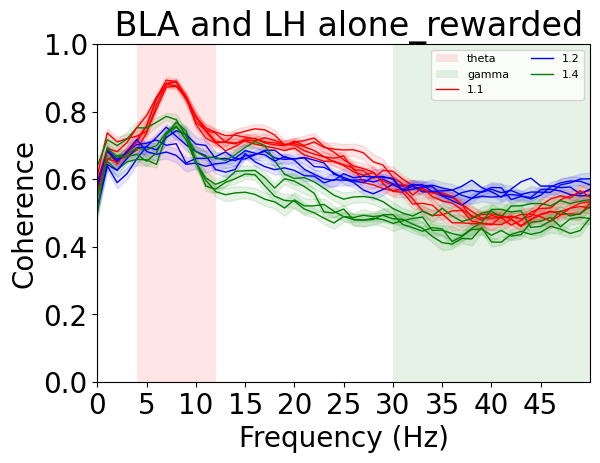

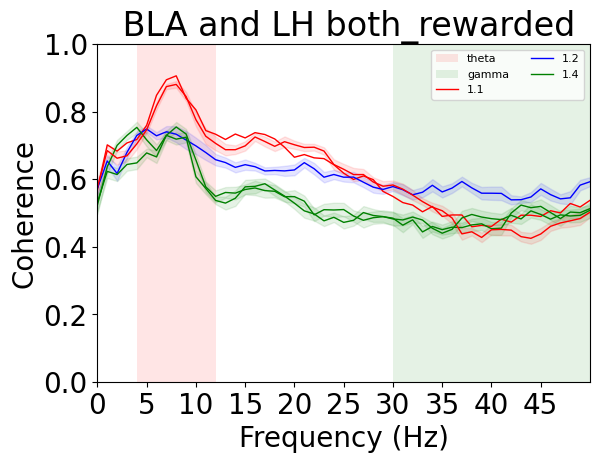

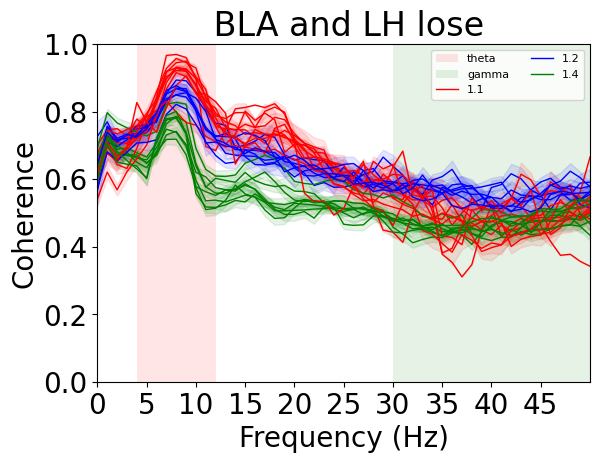

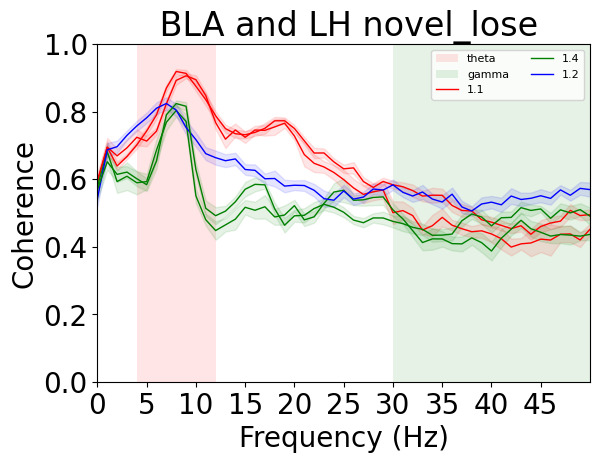

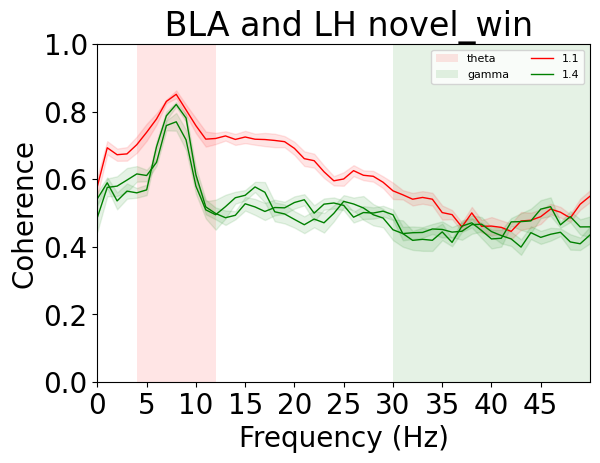

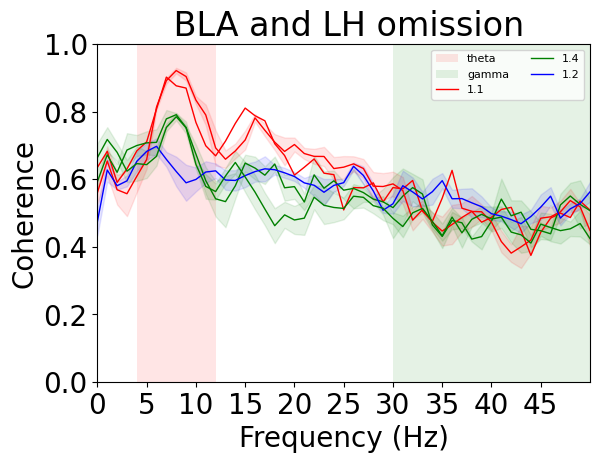

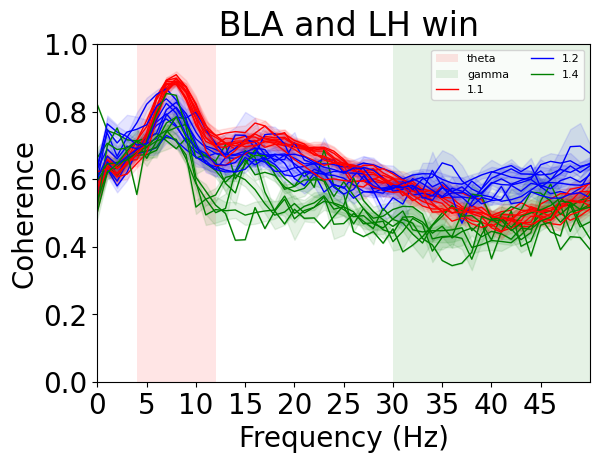

BLA_mPFC_RMS_filtered_coherence_all_frequencies


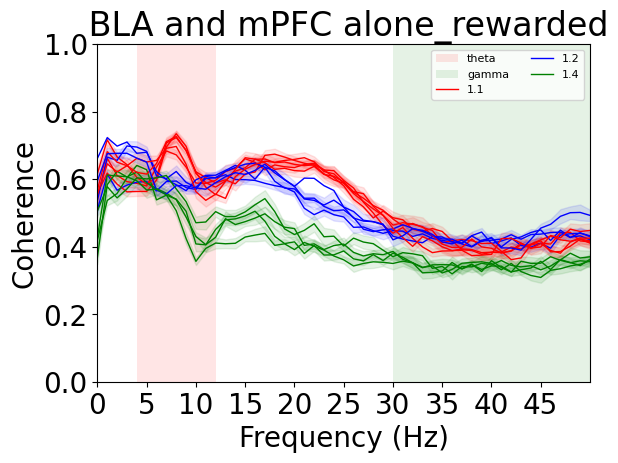

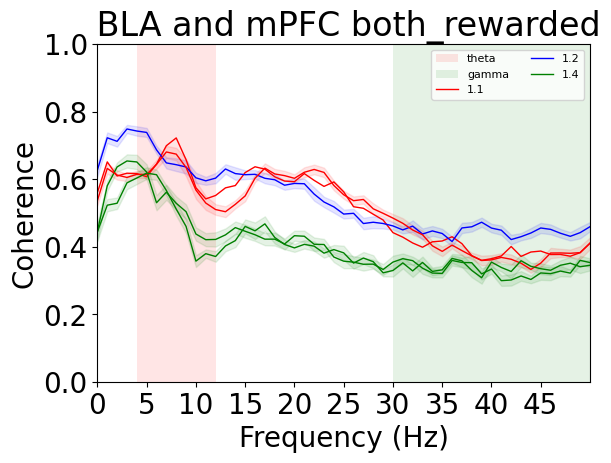

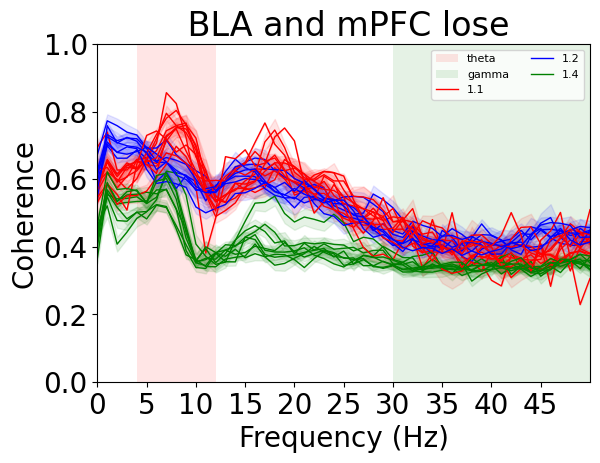

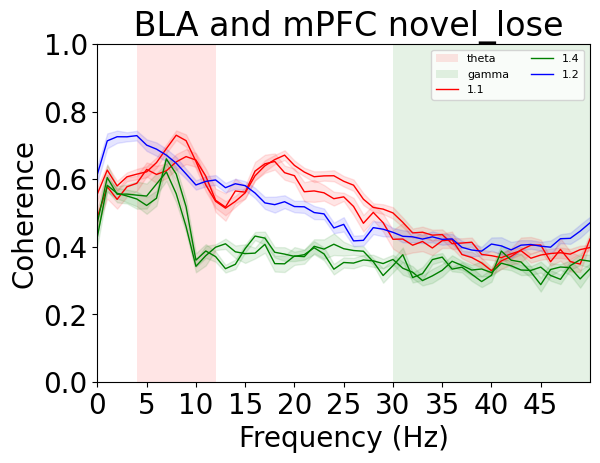

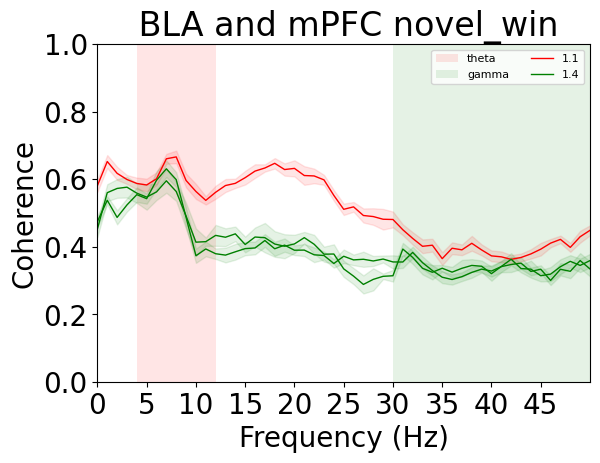

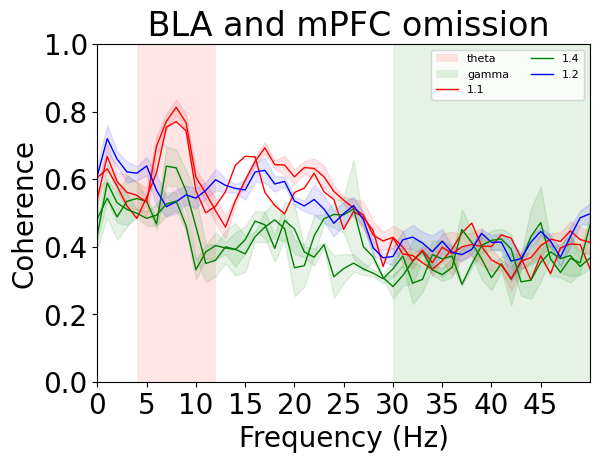

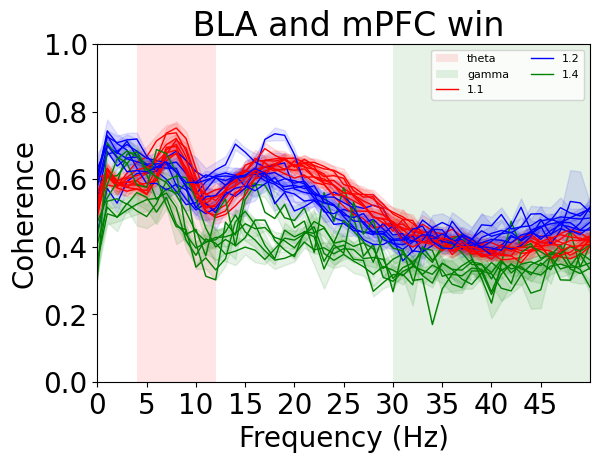

mPFC_vHPC_RMS_filtered_coherence_all_frequencies


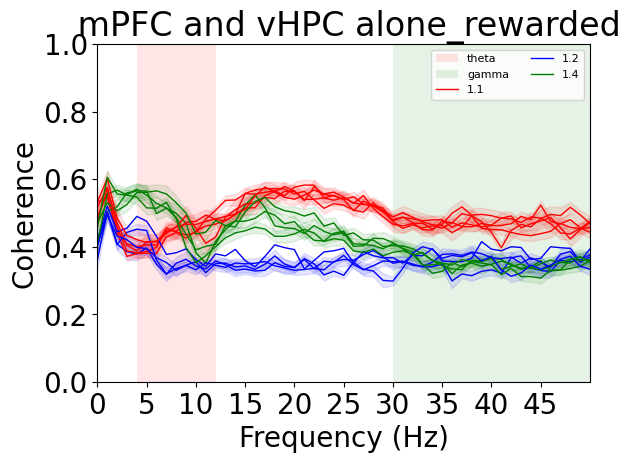

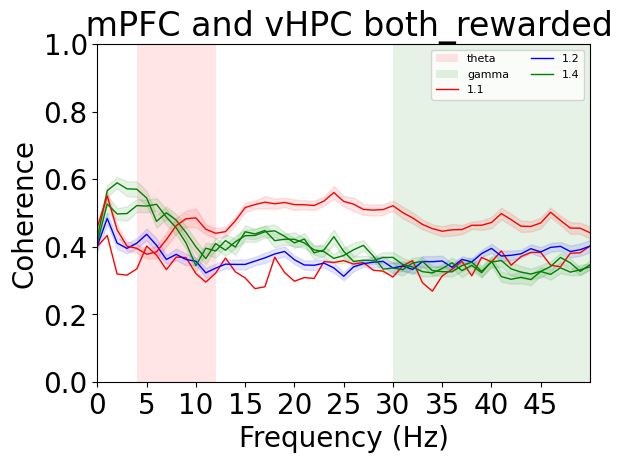

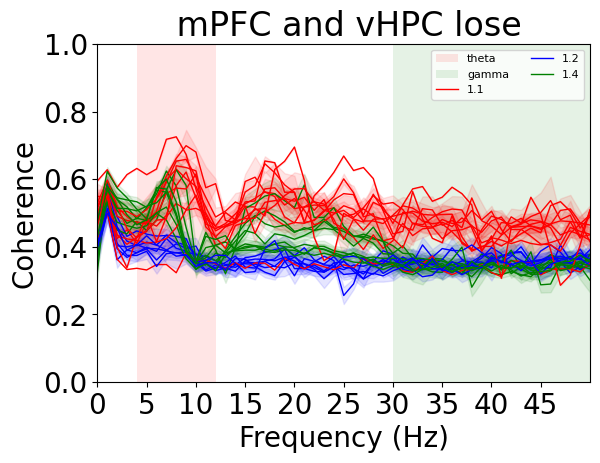

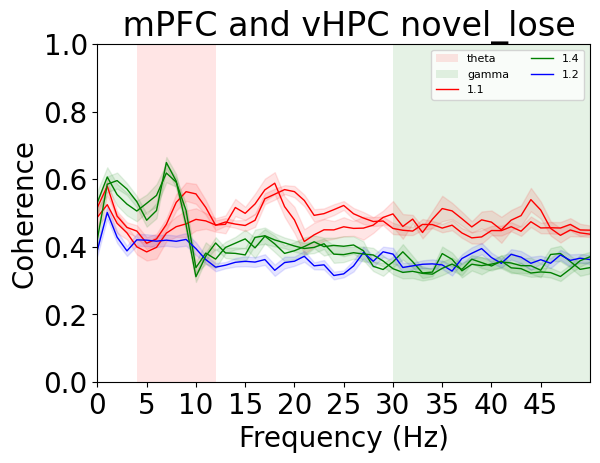

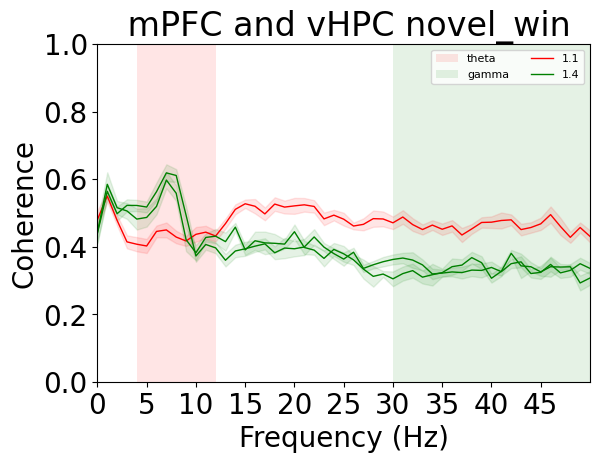

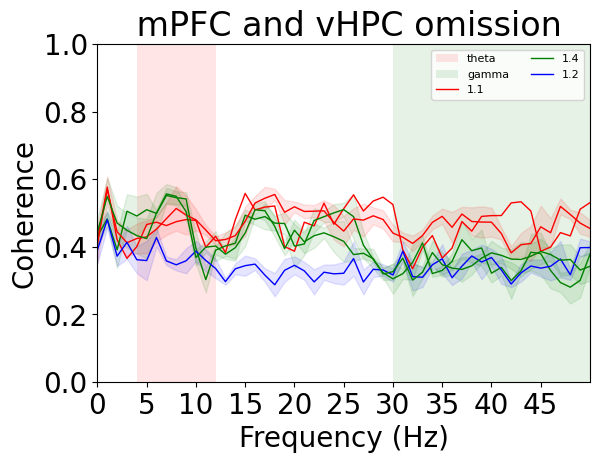

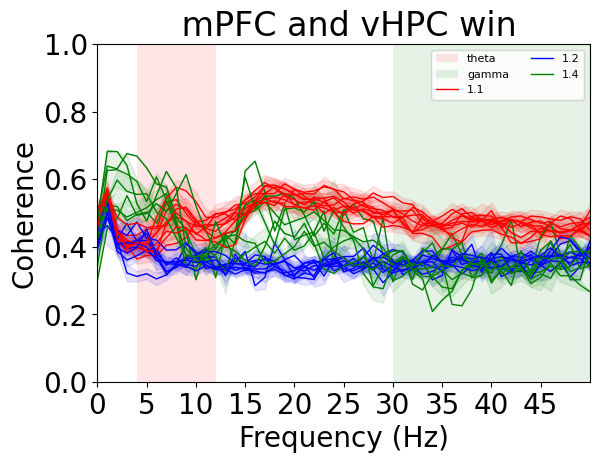

MD_vHPC_granger_all_frequencies


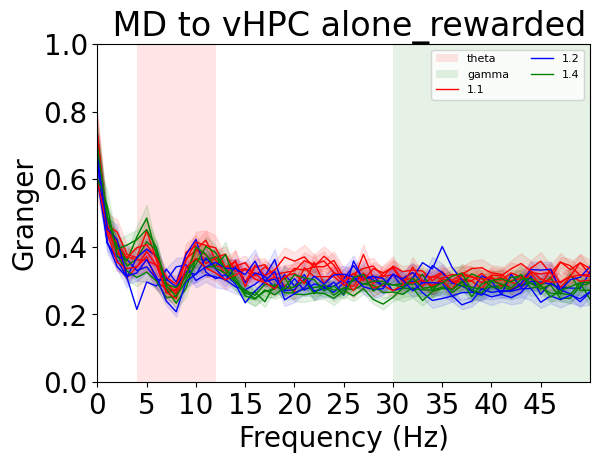

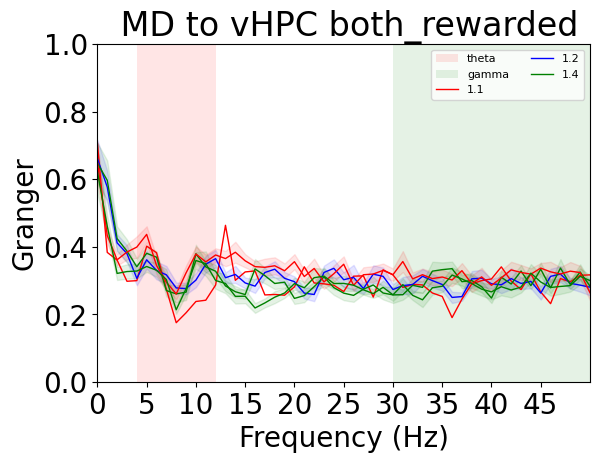

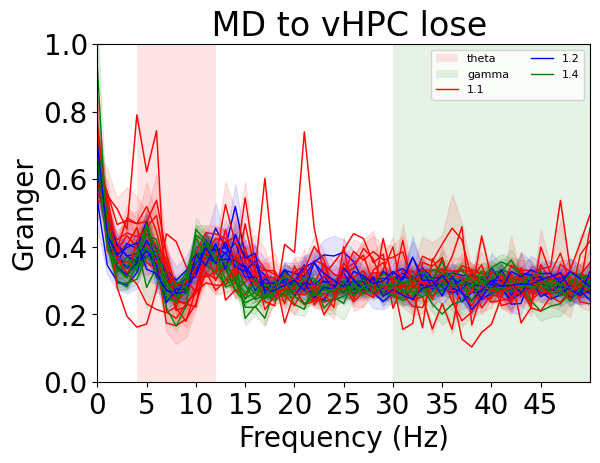

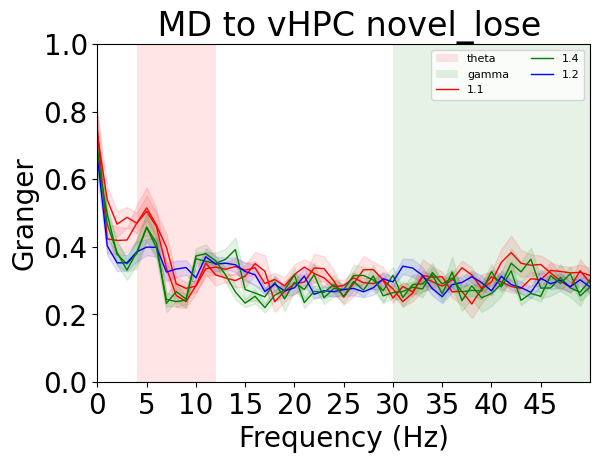

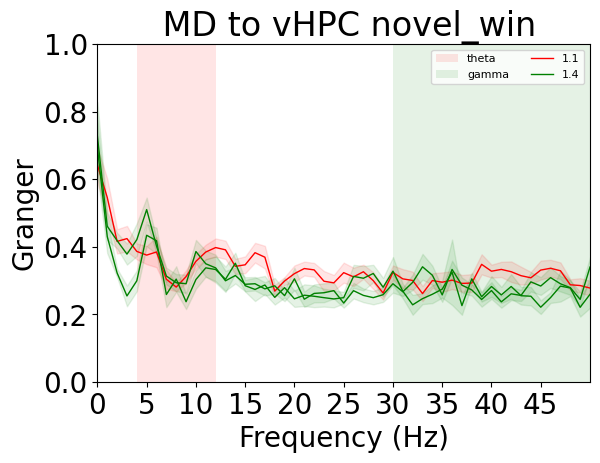

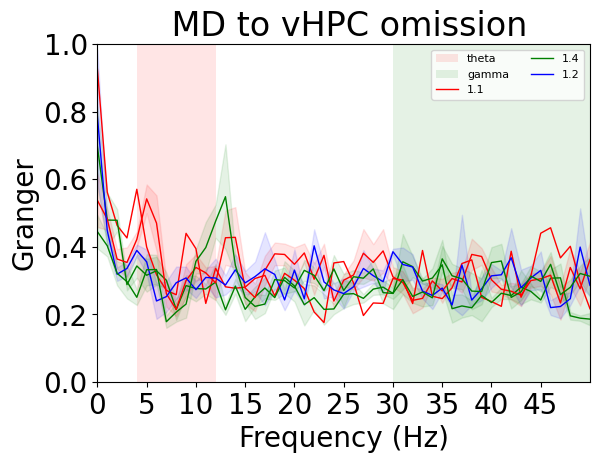

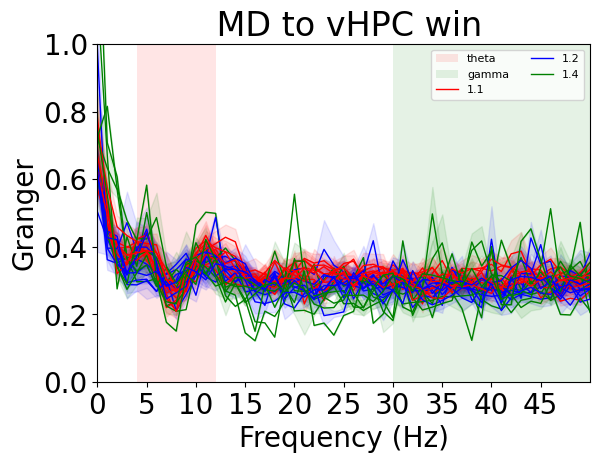

BLA_LH_granger_all_frequencies


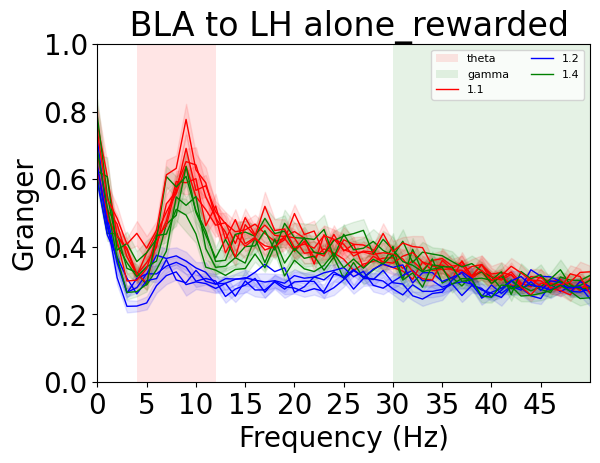

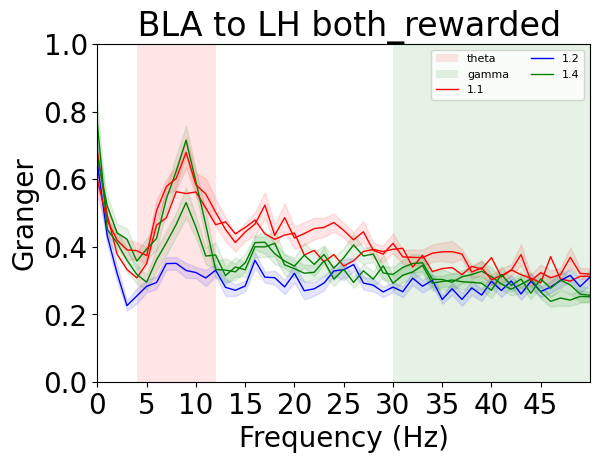

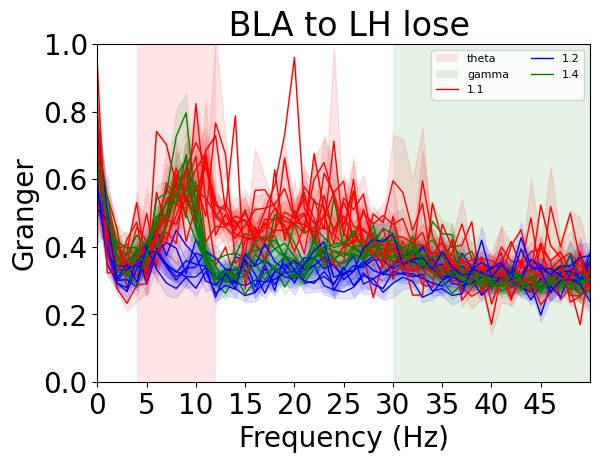

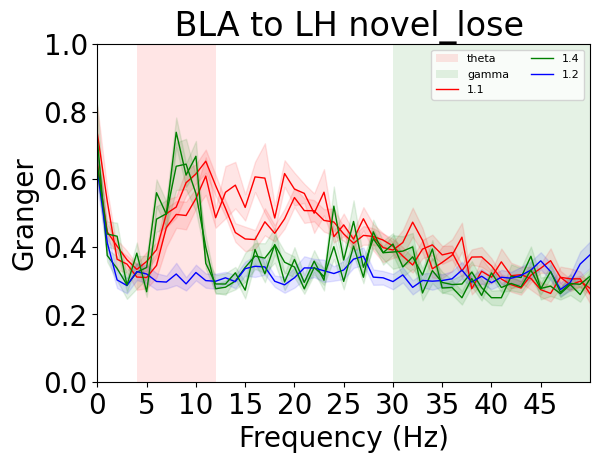

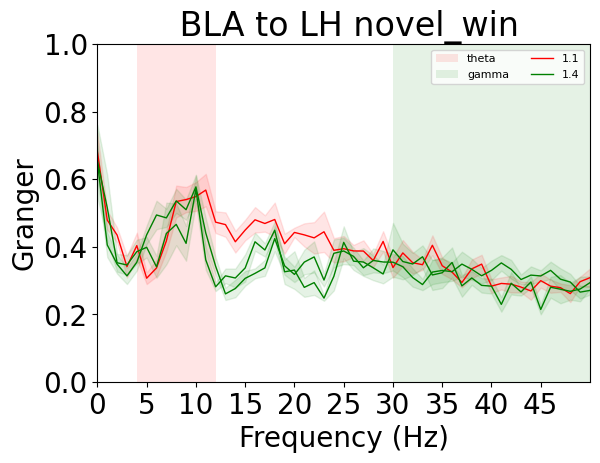

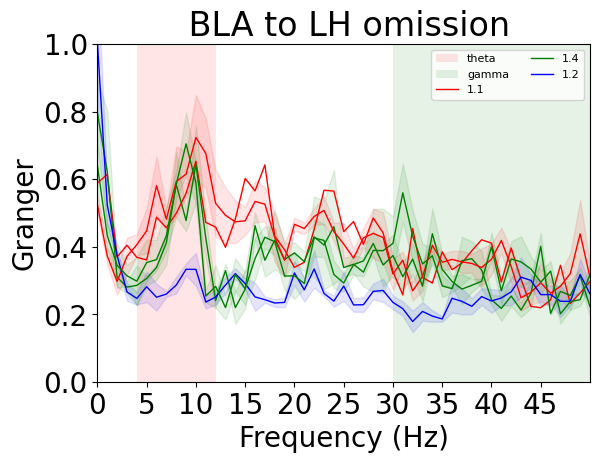

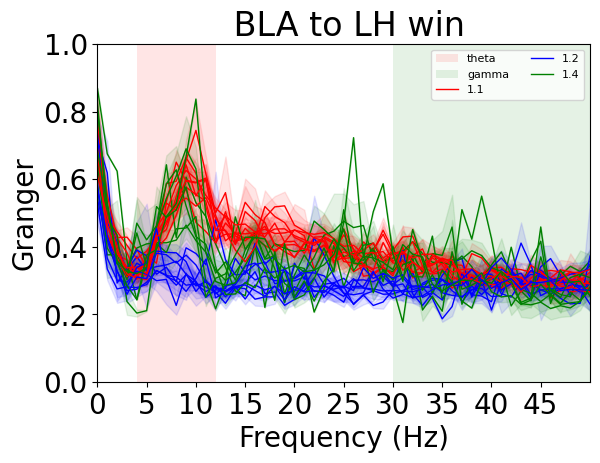

BLA_vHPC_RMS_filtered_coherence_all_frequencies


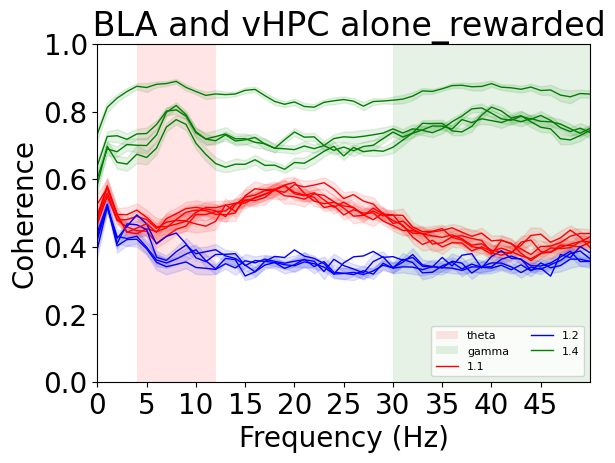

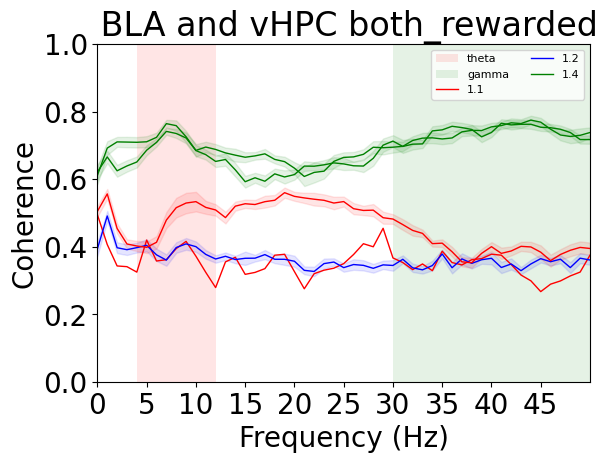

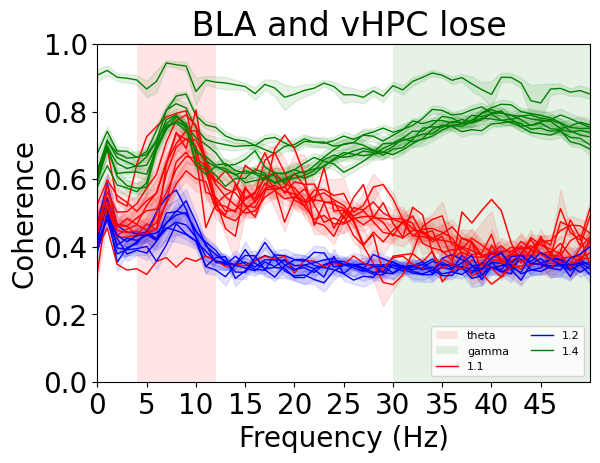

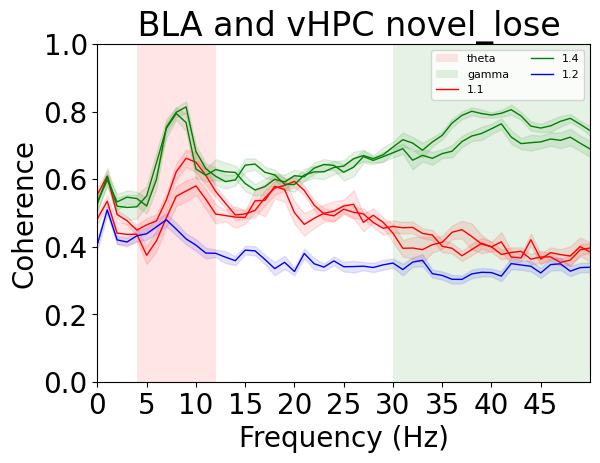

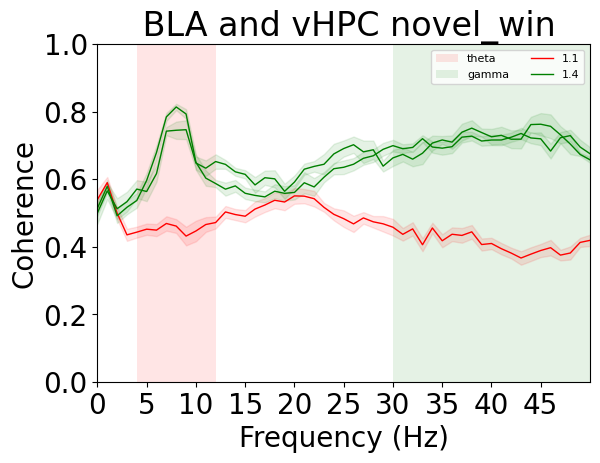

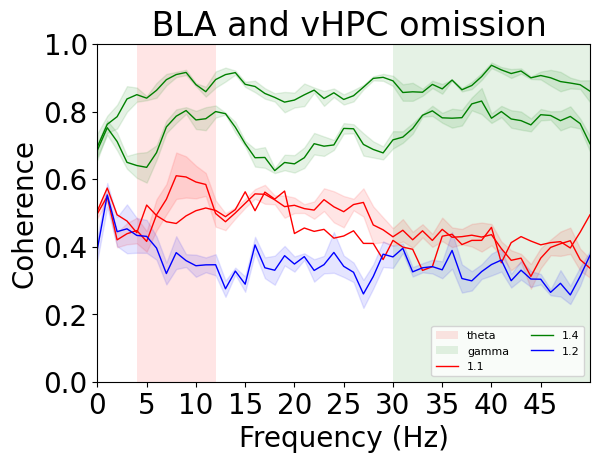

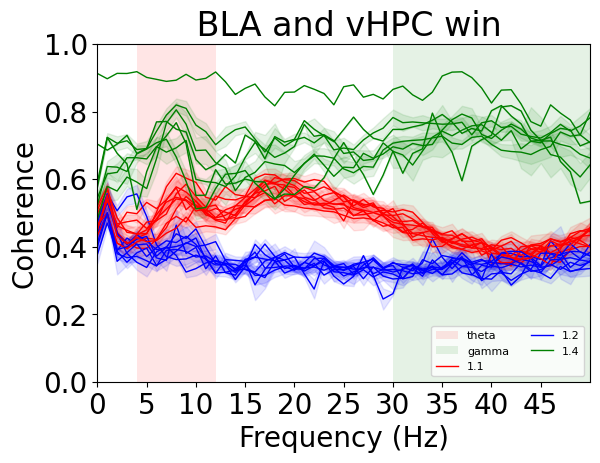

MD_LH_granger_all_frequencies


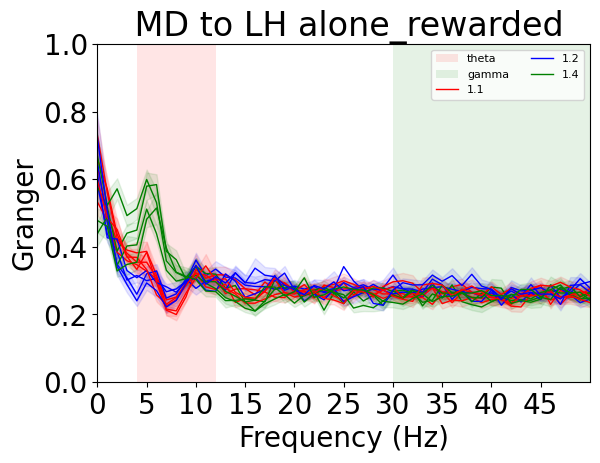

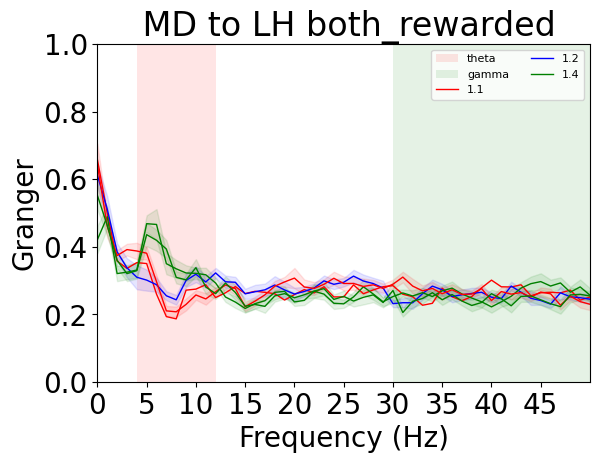

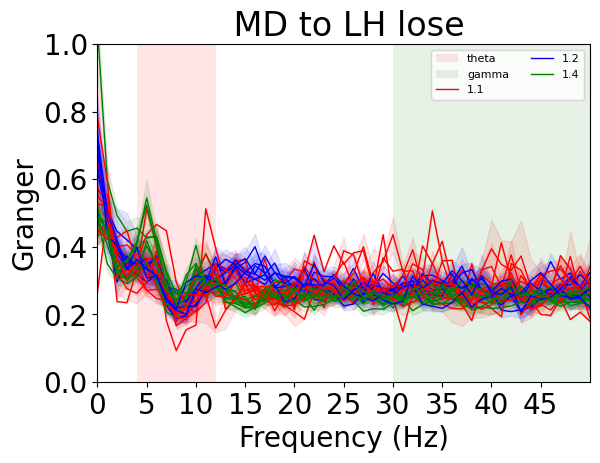

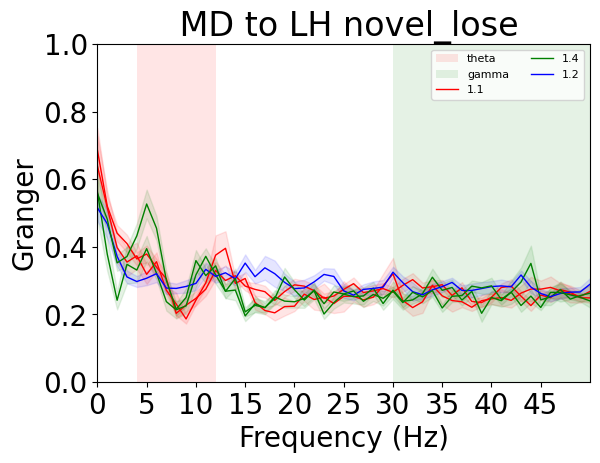

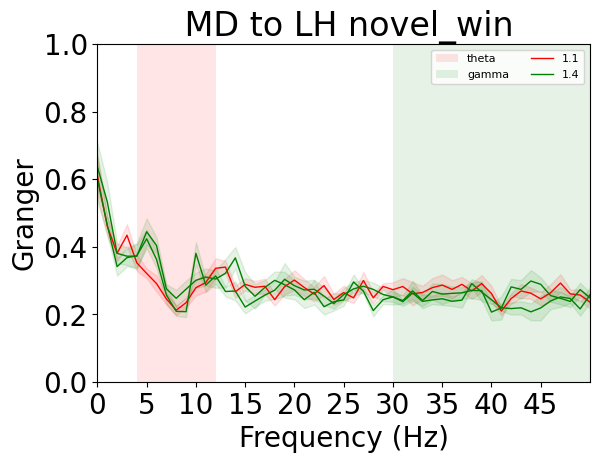

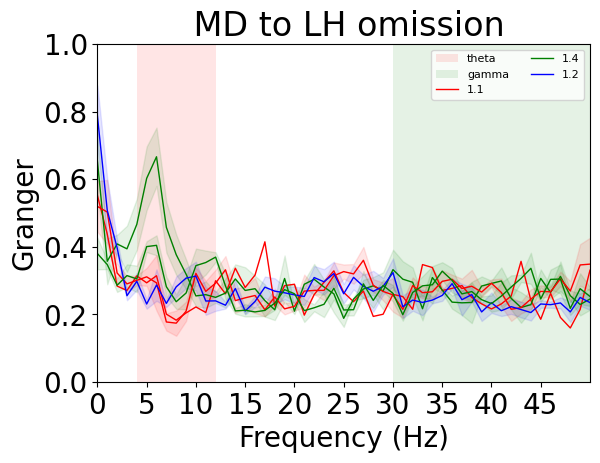

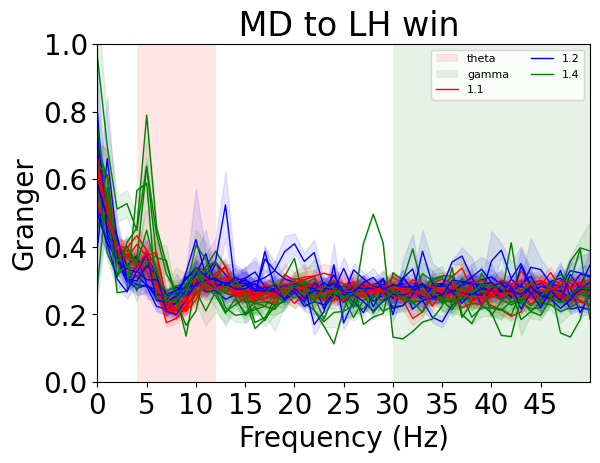

vHPC_MD_granger_all_frequencies


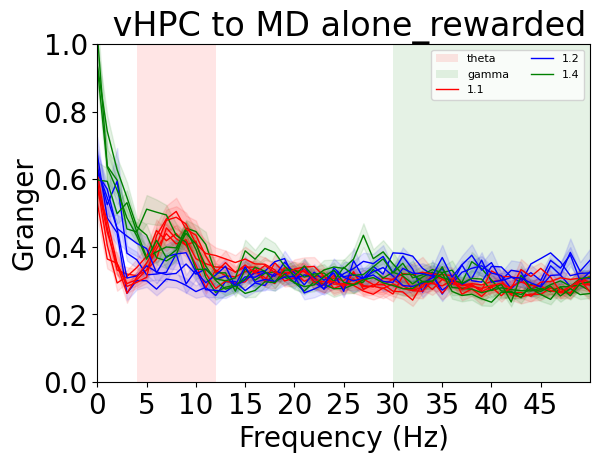

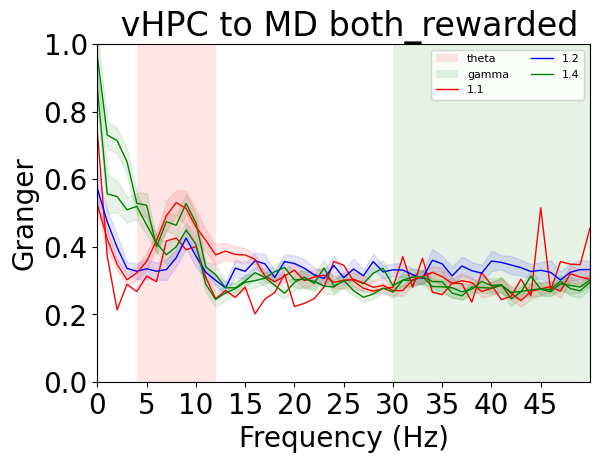

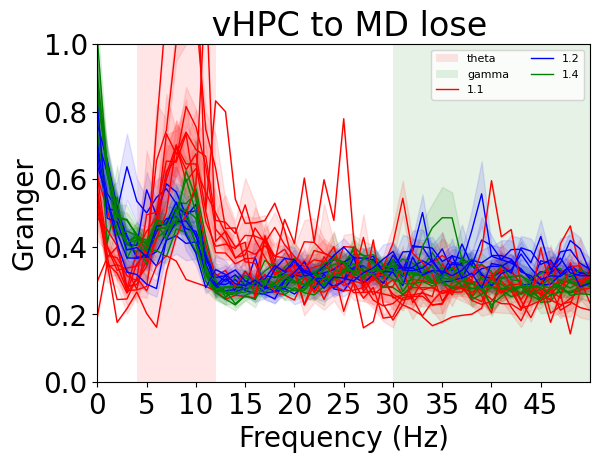

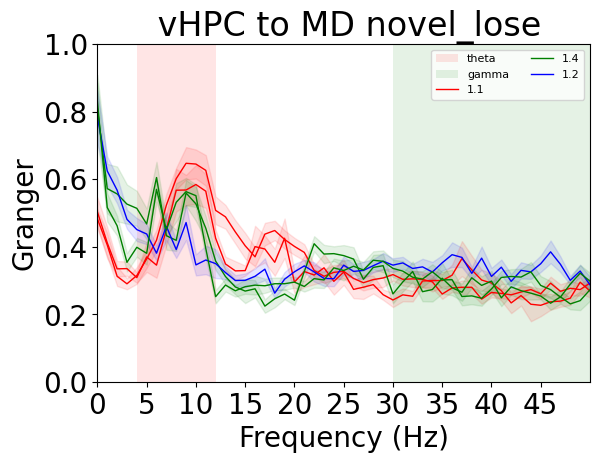

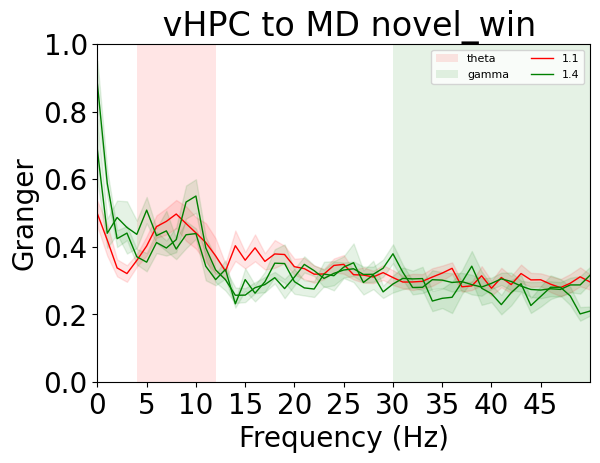

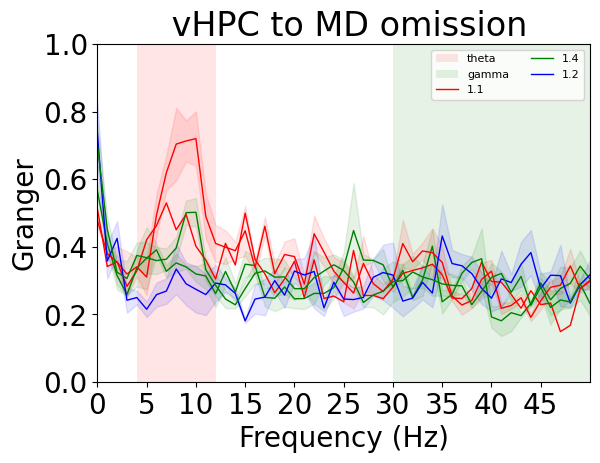

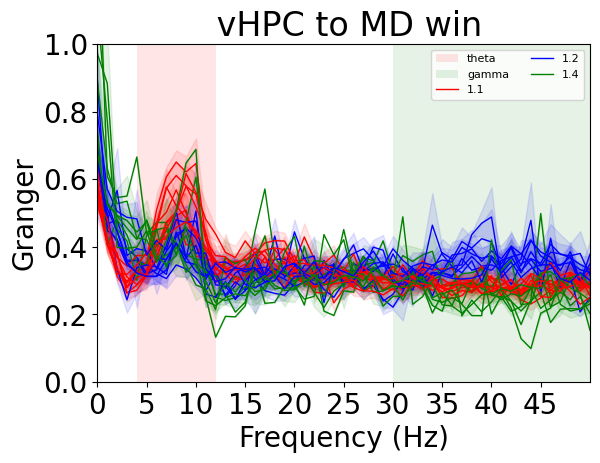

LH_RMS_filtered_power_all_frequencies


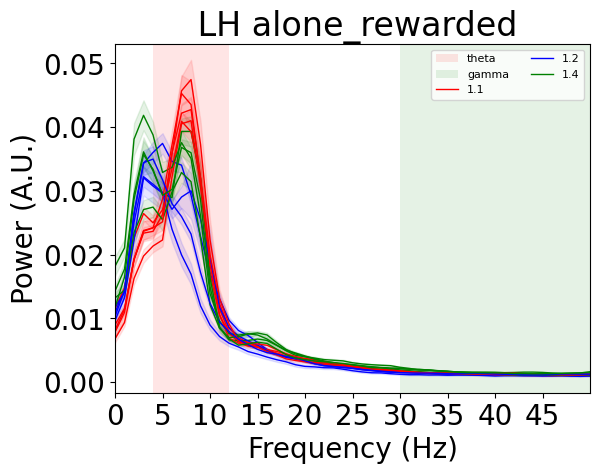

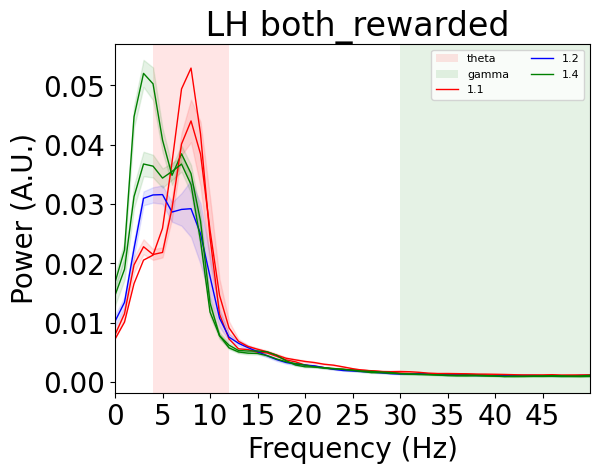

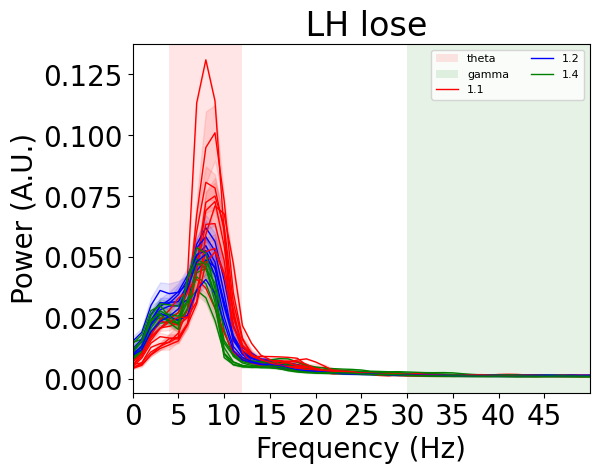

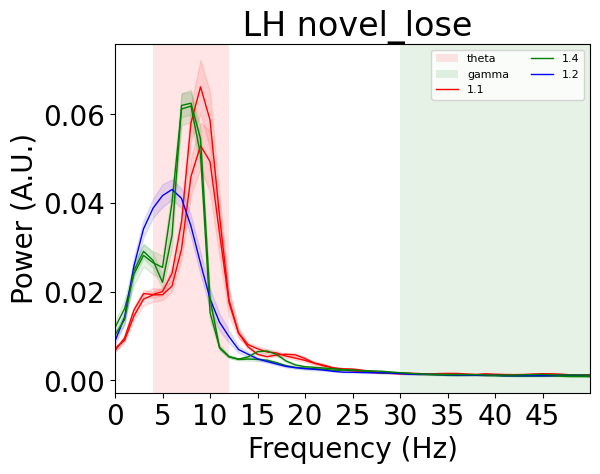

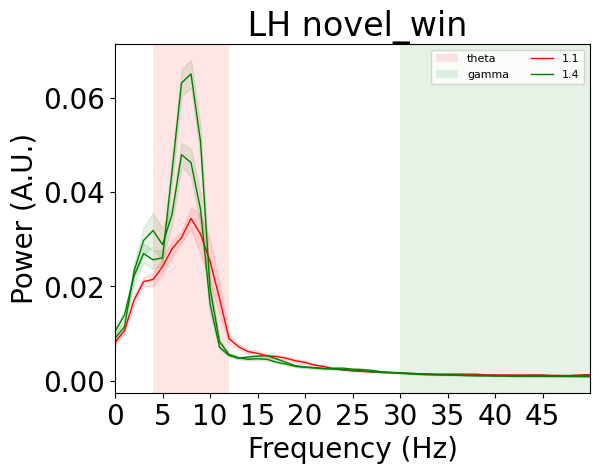

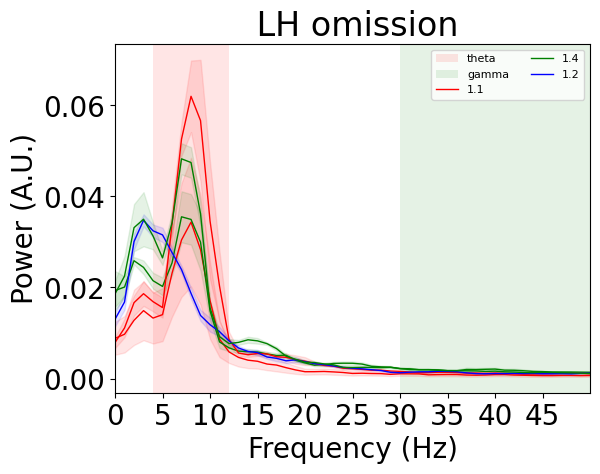

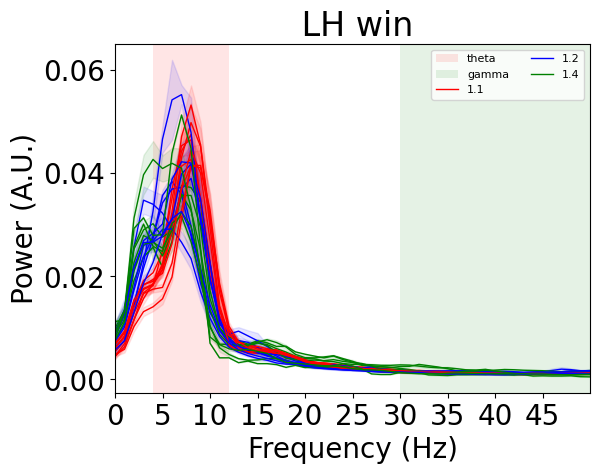

LH_vHPC_RMS_filtered_coherence_all_frequencies


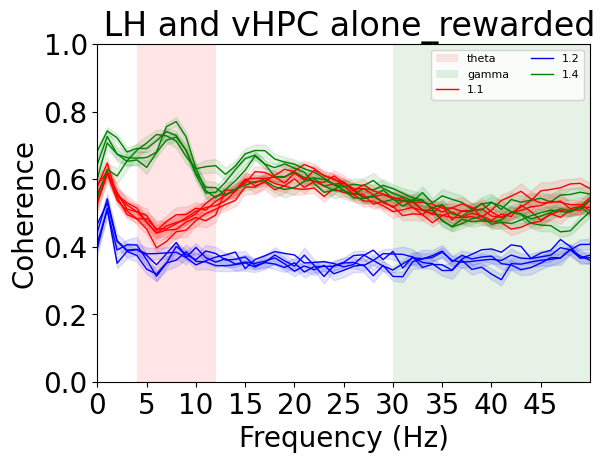

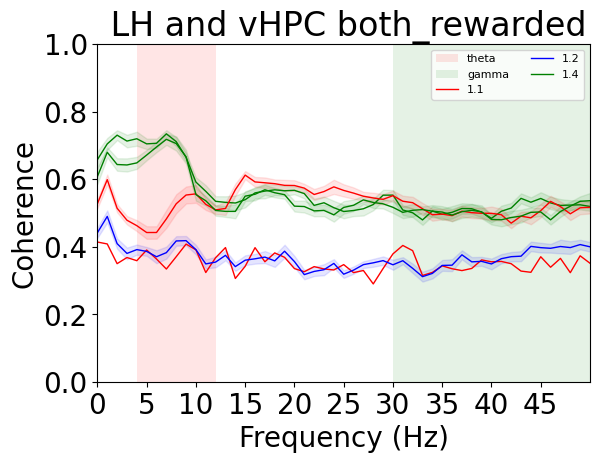

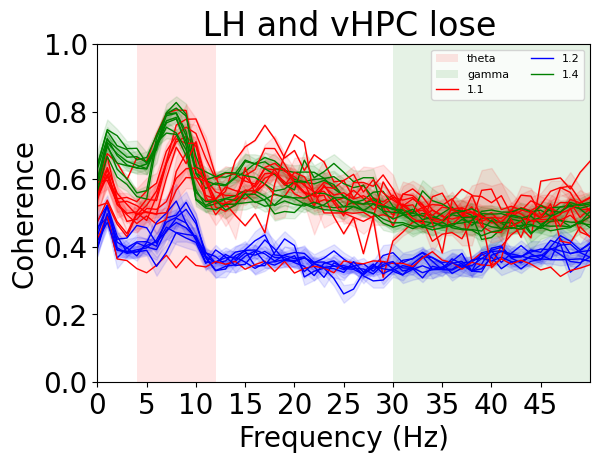

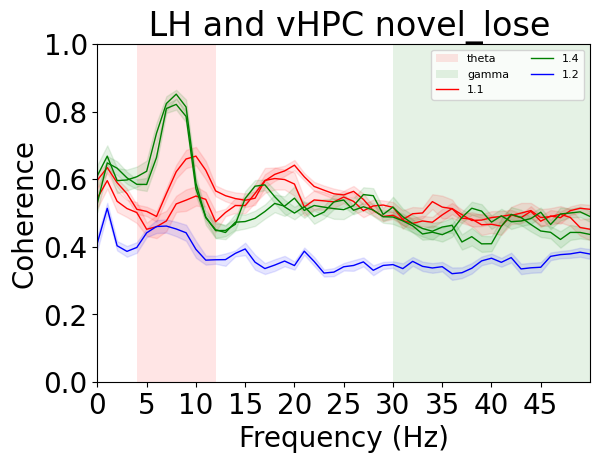

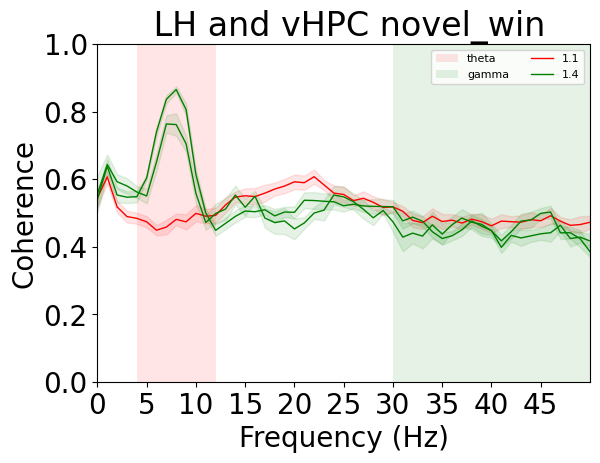

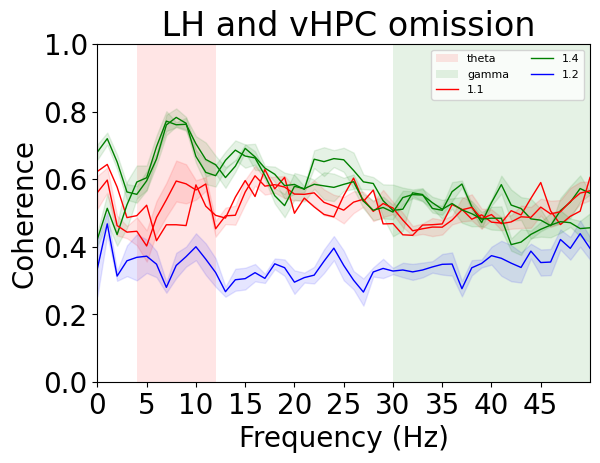

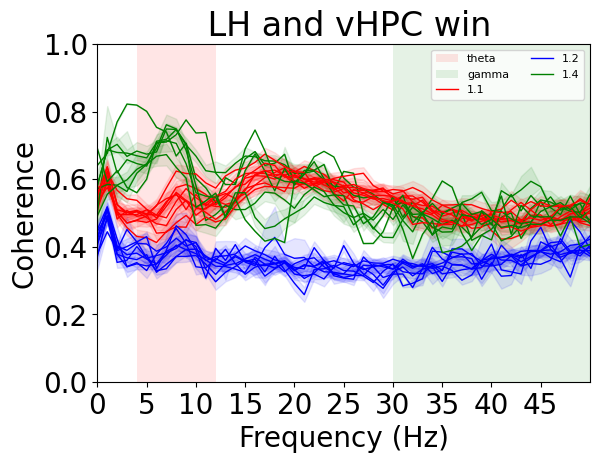

MD_BLA_granger_all_frequencies


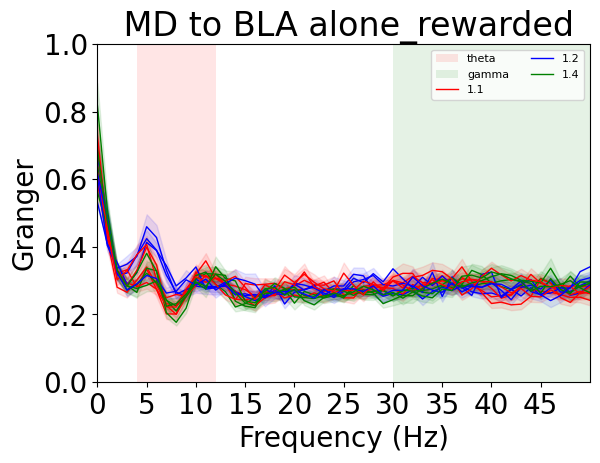

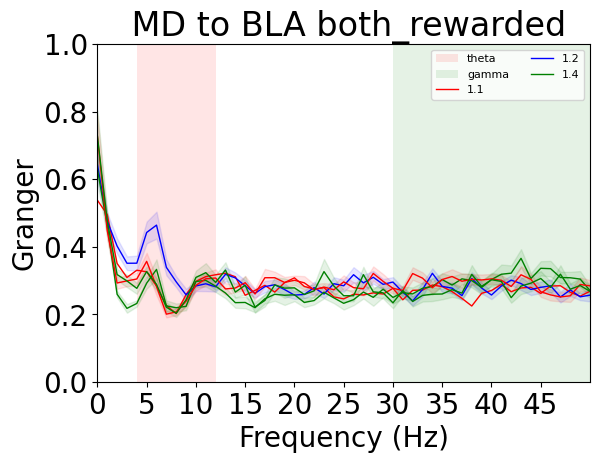

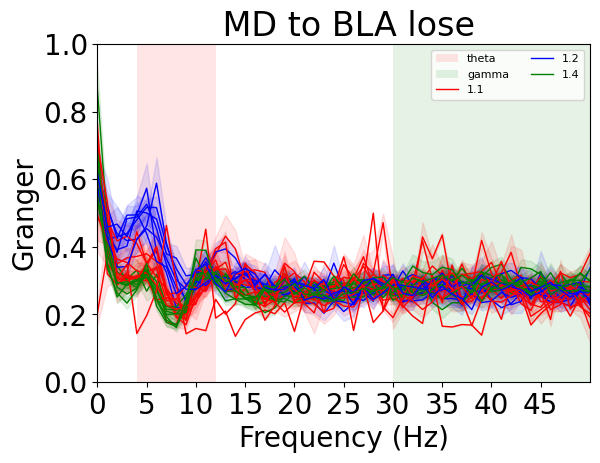

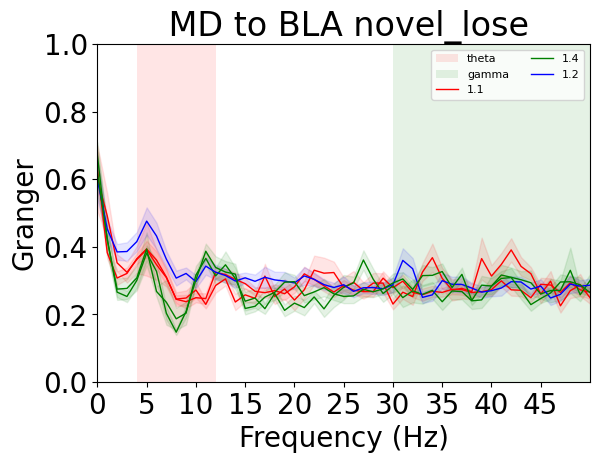

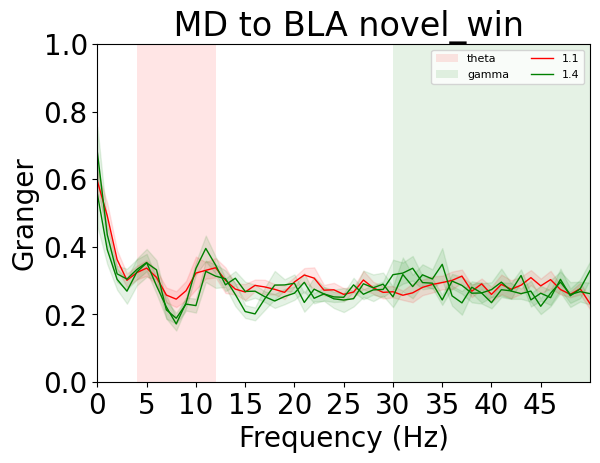

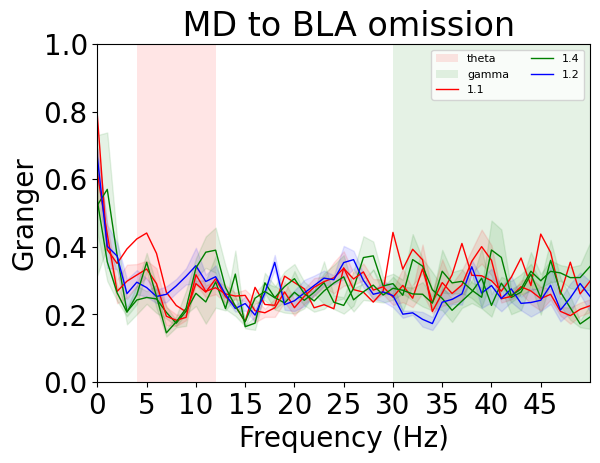

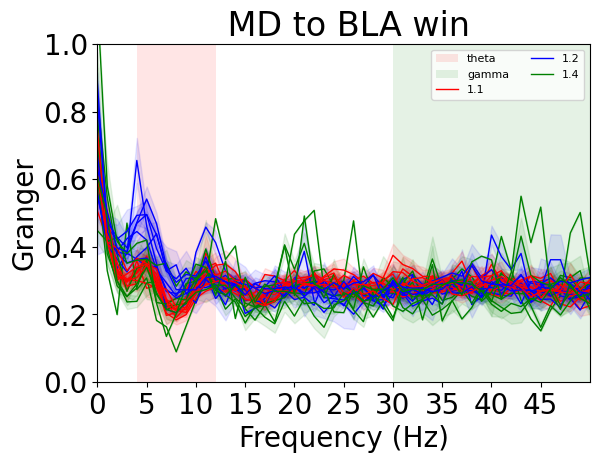

BLA_vHPC_granger_all_frequencies


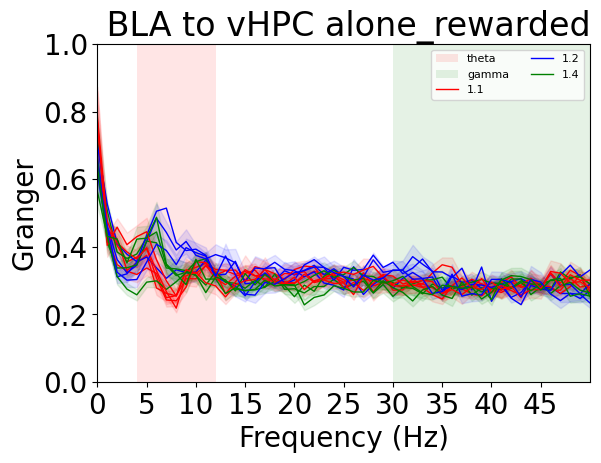

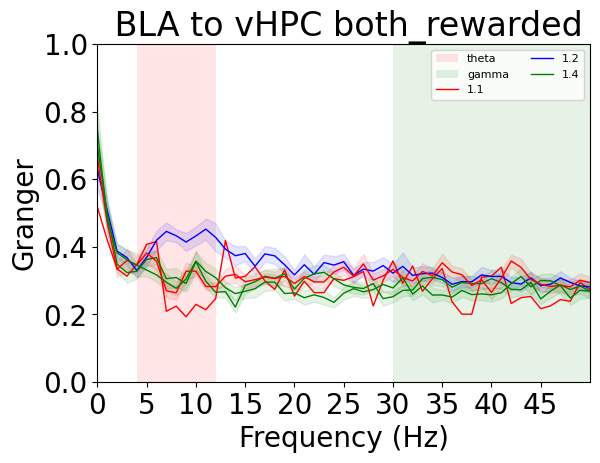

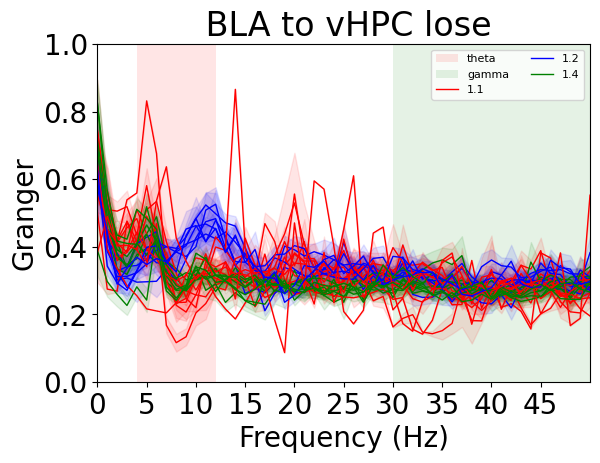

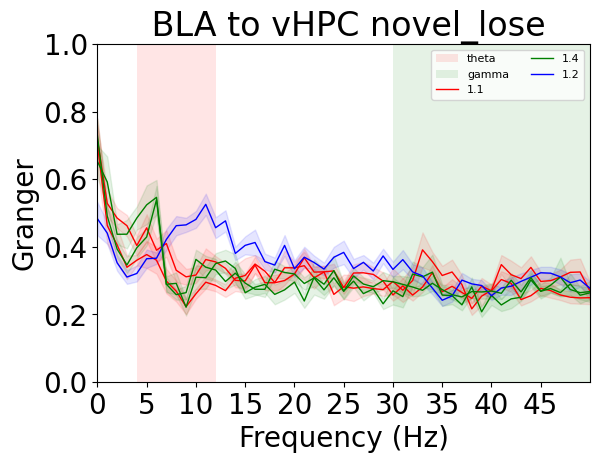

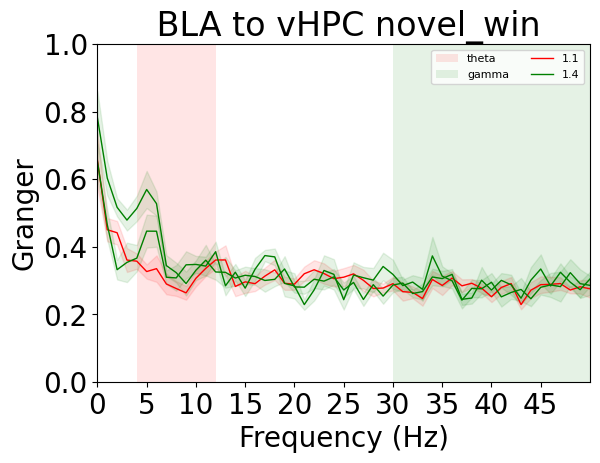

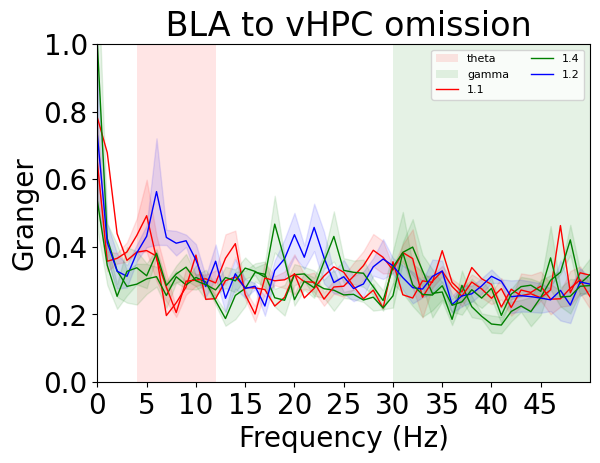

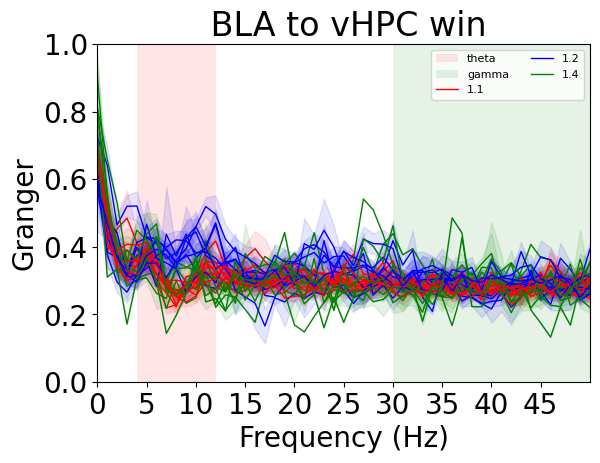

MD_mPFC_RMS_filtered_coherence_all_frequencies


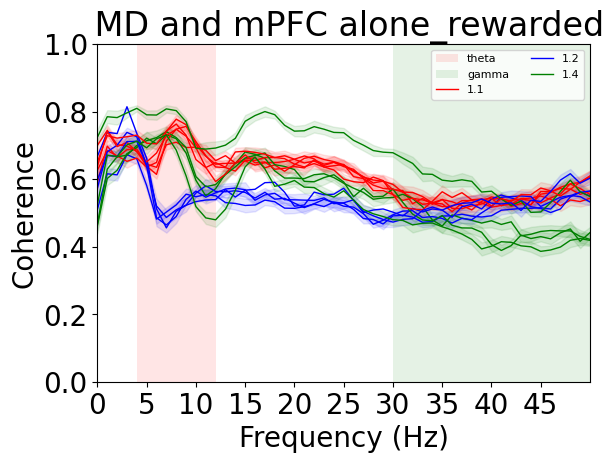

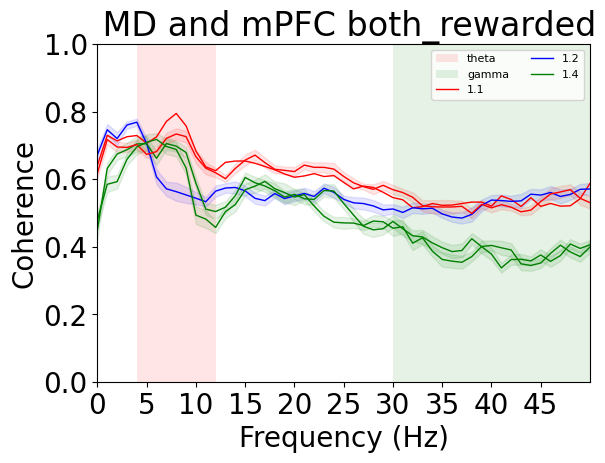

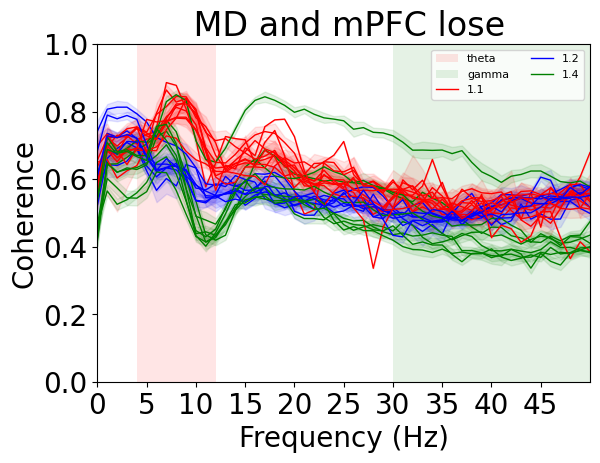

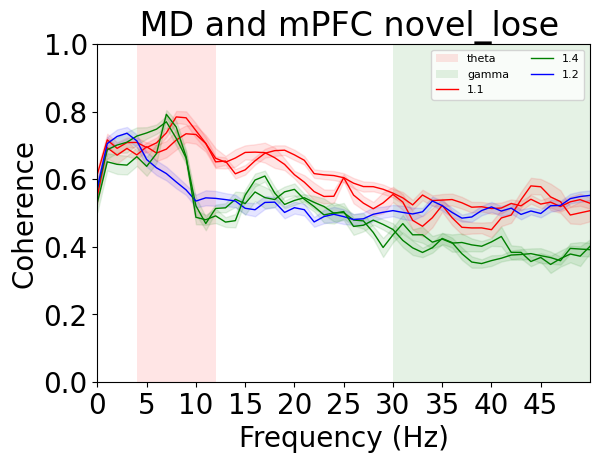

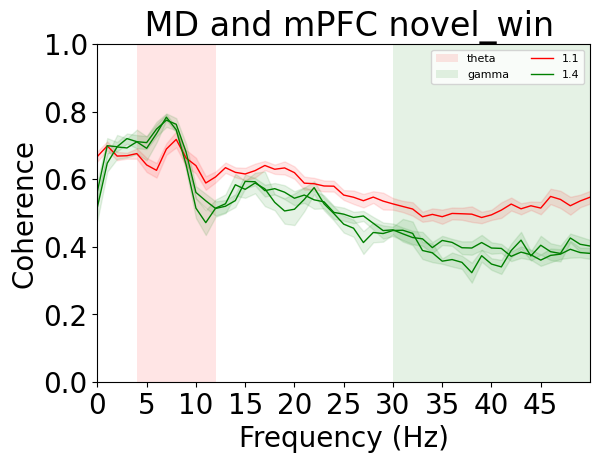

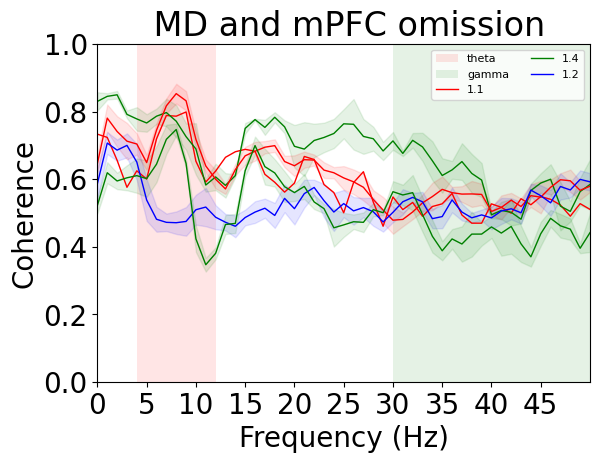

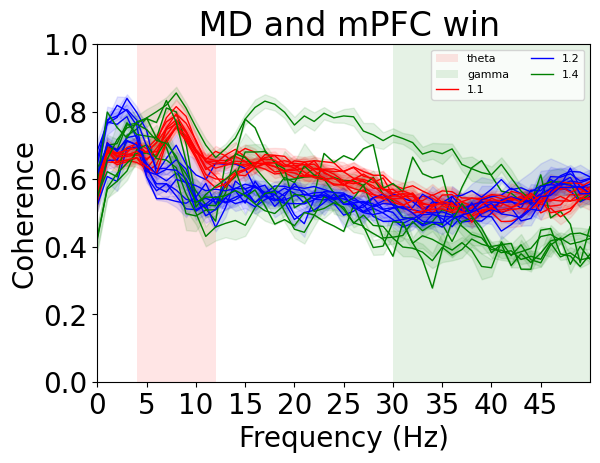

MD_vHPC_RMS_filtered_coherence_all_frequencies


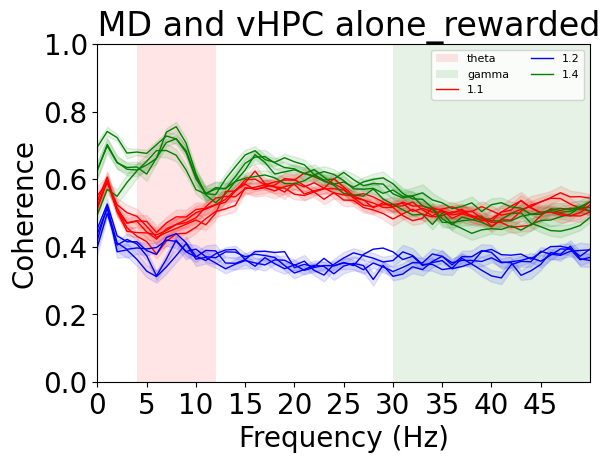

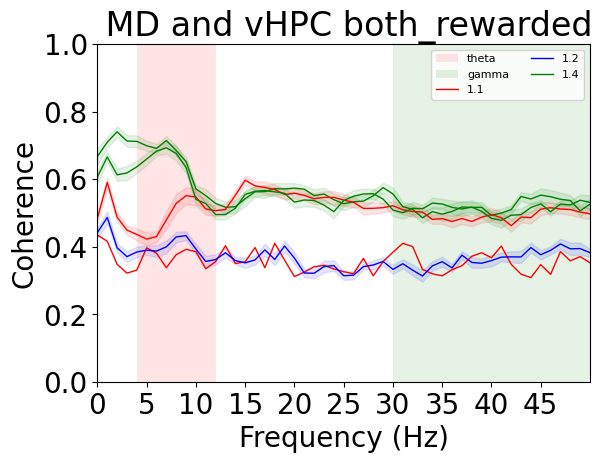

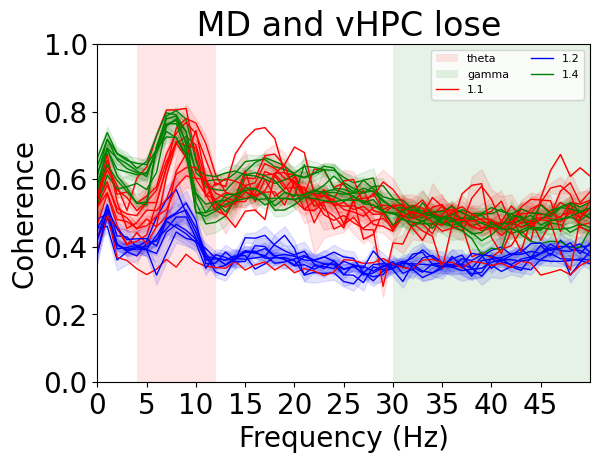

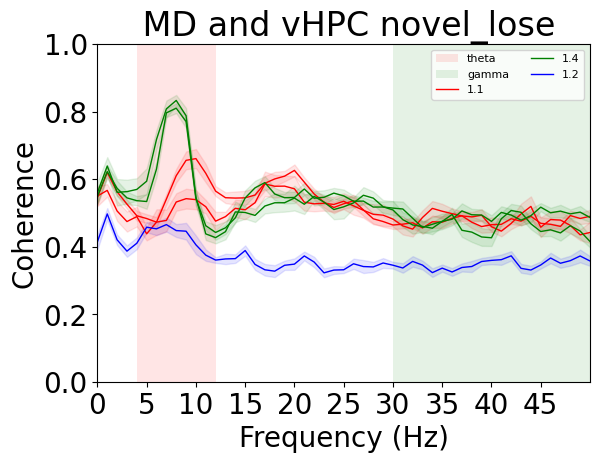

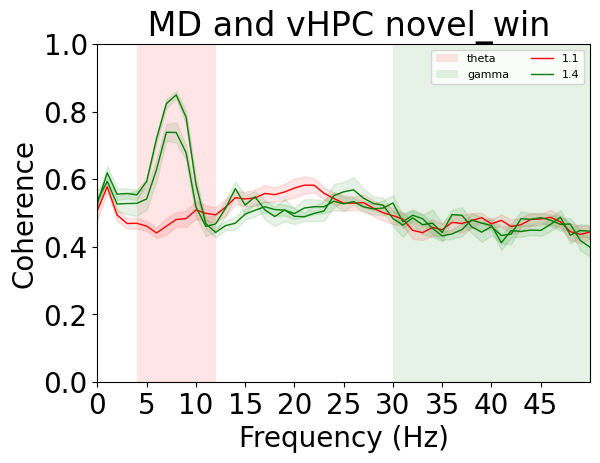

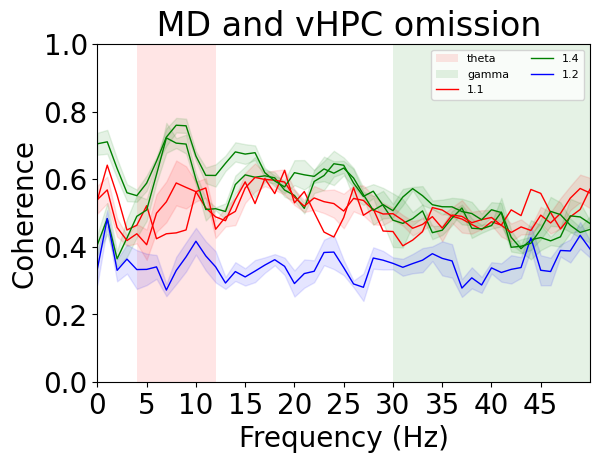

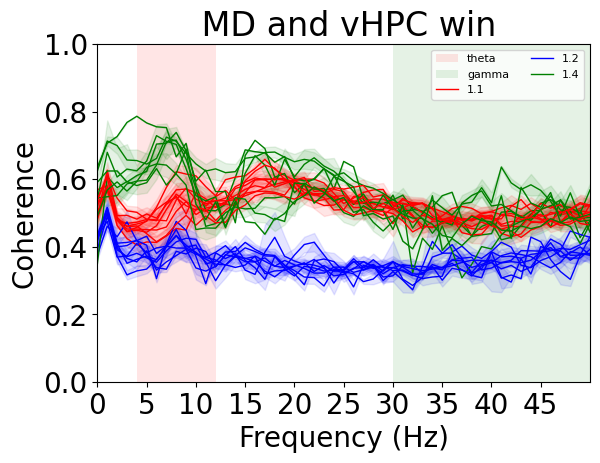

MD_mPFC_granger_all_frequencies


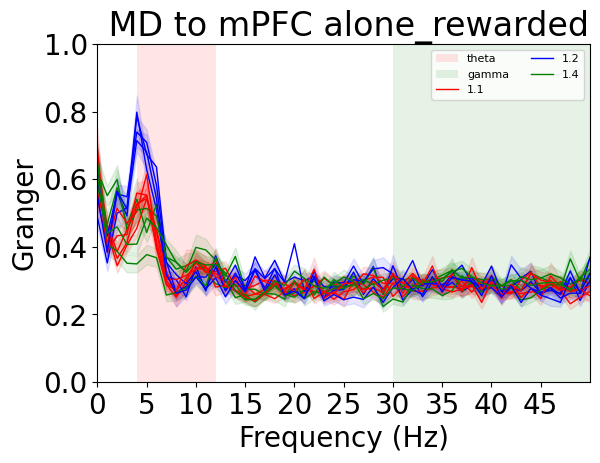

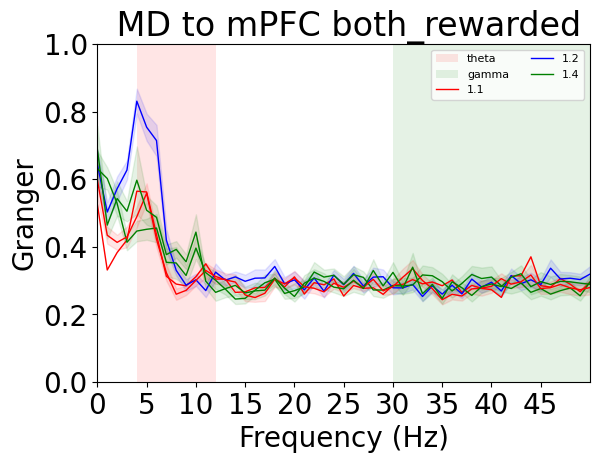

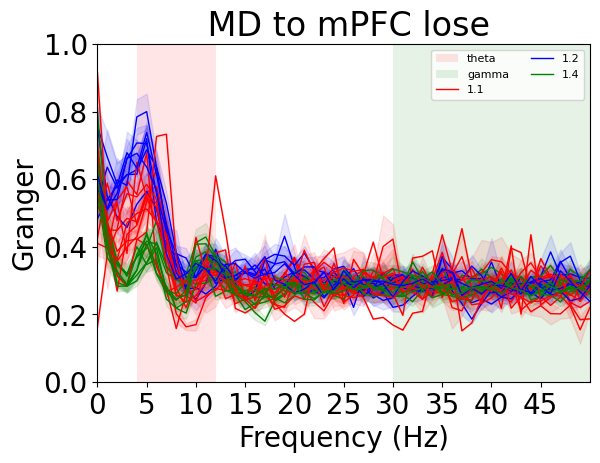

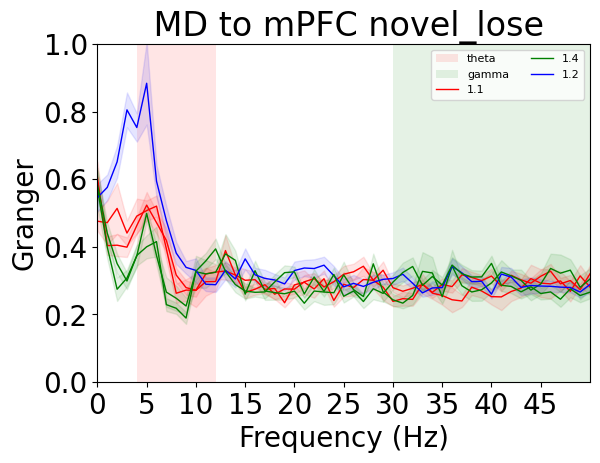

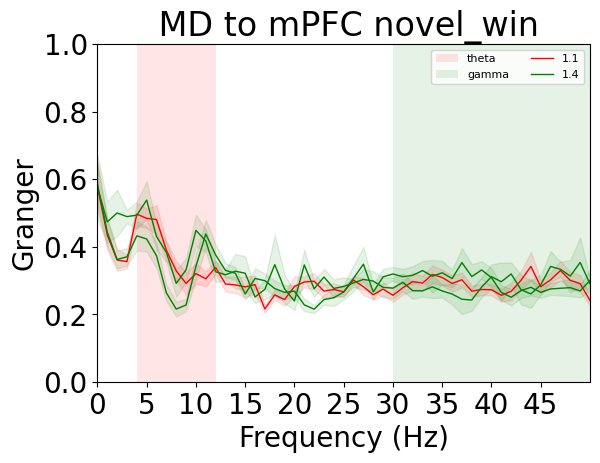

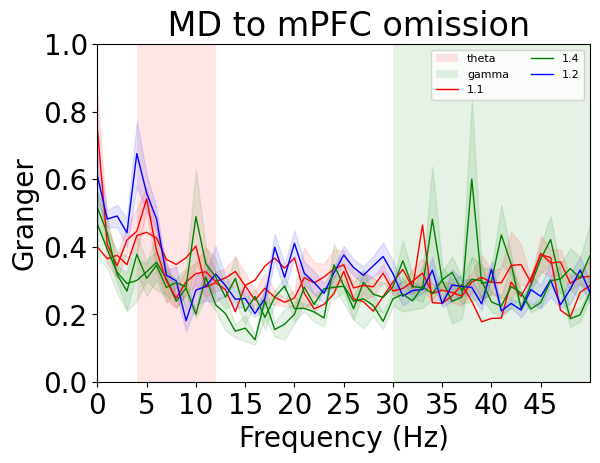

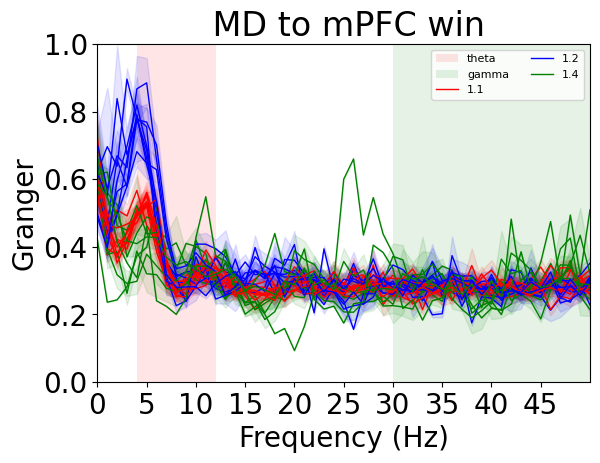

mPFC_MD_granger_all_frequencies


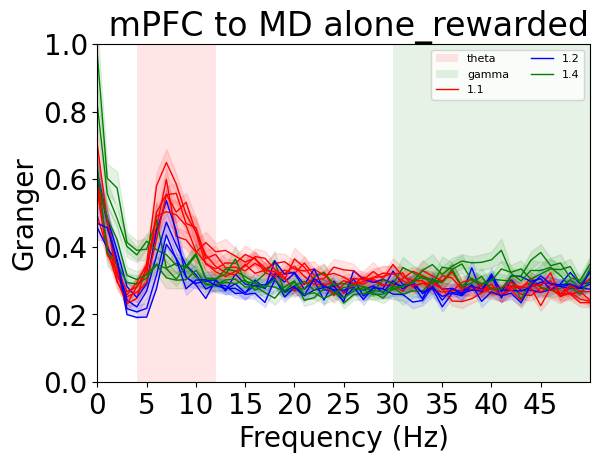

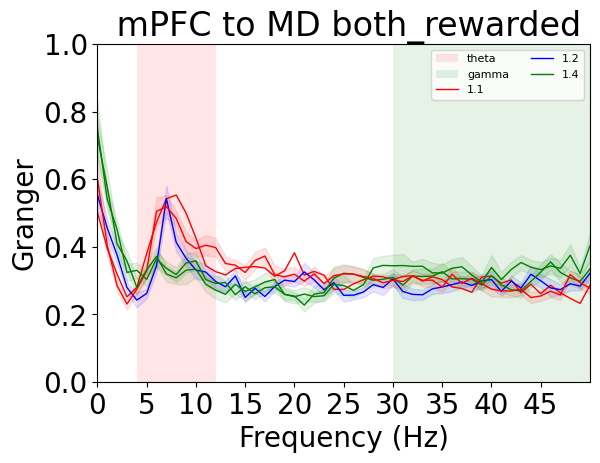

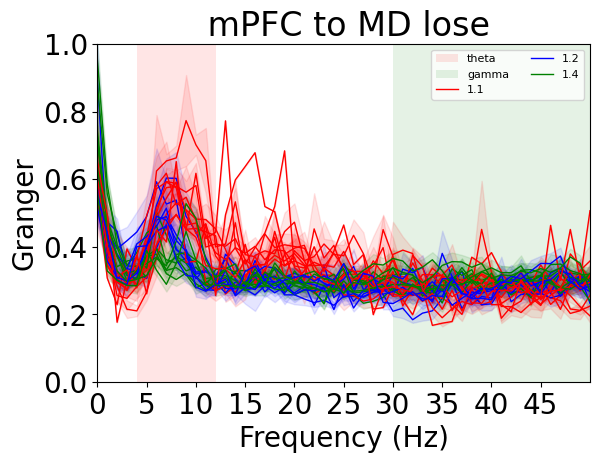

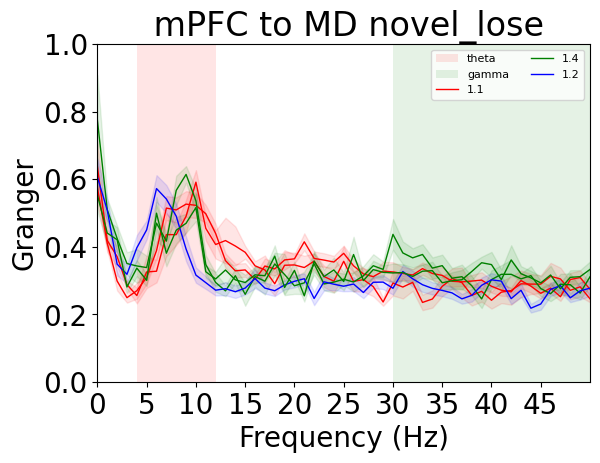

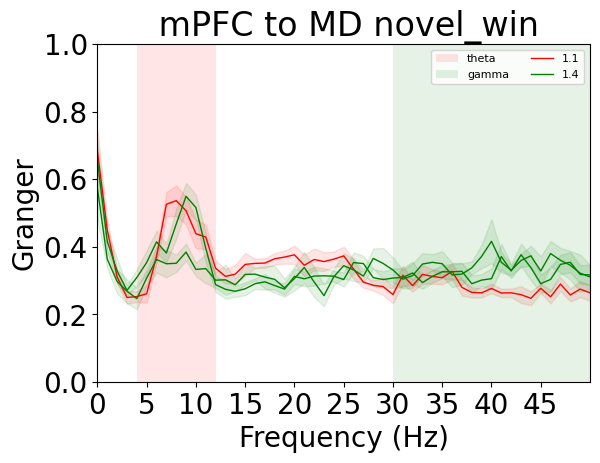

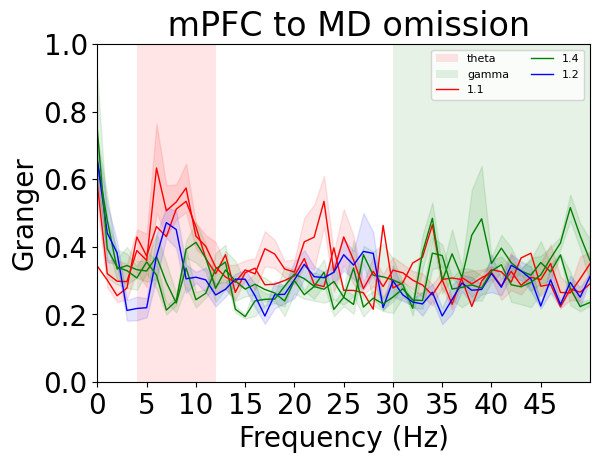

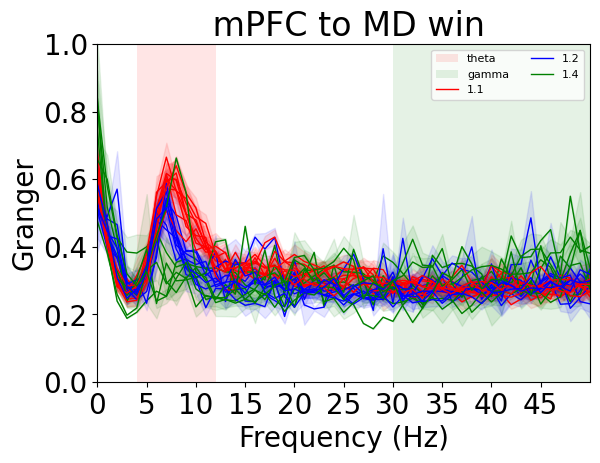

BLA_mPFC_granger_all_frequencies


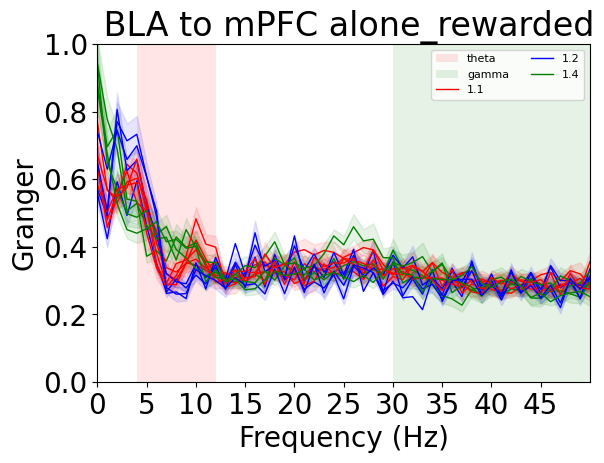

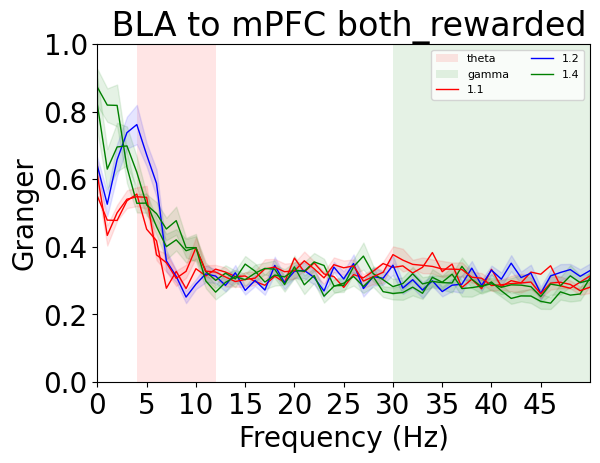

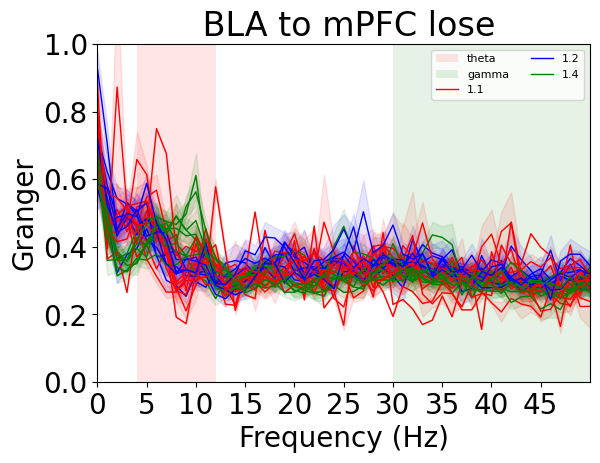

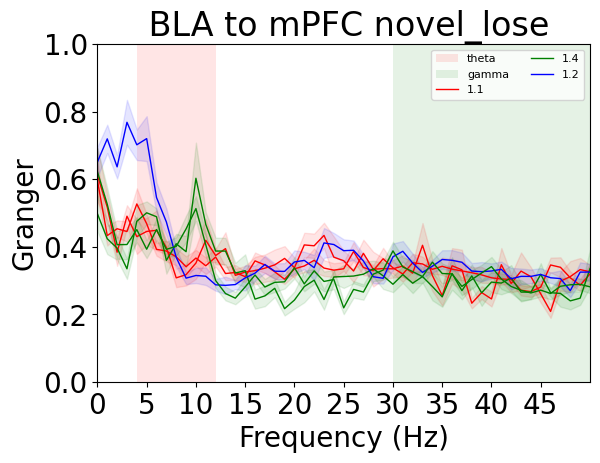

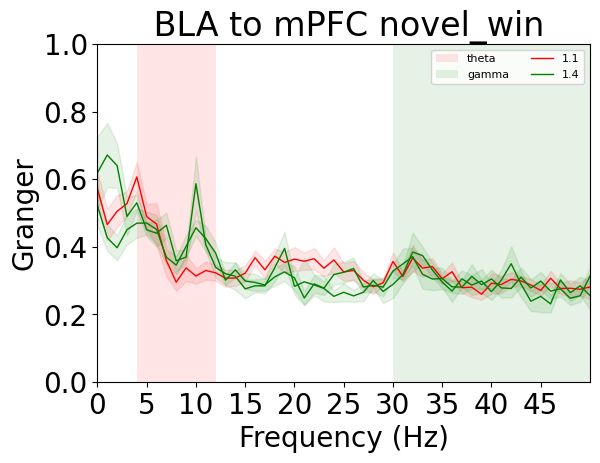

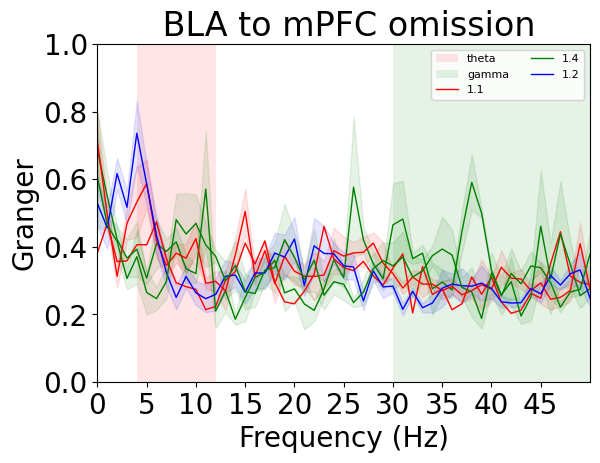

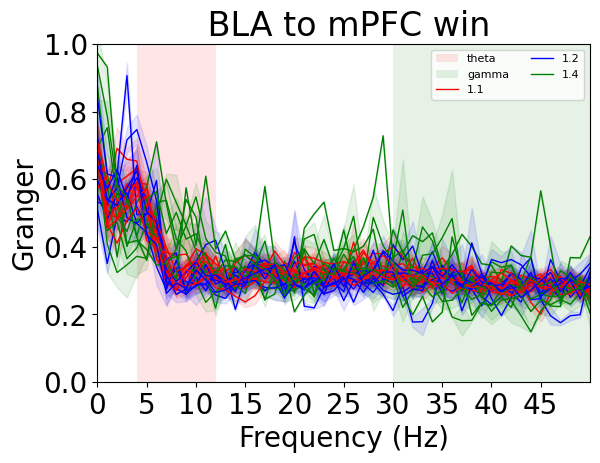

In [63]:
low_freq = 0
high_freq = 51
current_frequencies = range(low_freq, high_freq)

for column in power_columns:
    print(column)
    baseline_column = "baseline_{}".format(column)
    trial_column = "trial_{}".format(column)
    plot_title = "{}".format(column).replace("_all_frequencies", "").replace("_granger", "").replace("_power", "").replace("_coherence", "")
    if "granger" in column:
        plot_title = plot_title.replace("_", " to ")
    elif "power" in column:
        plot_title = plot_title.split("_")[0]

    elif "coherence" in column:
        plot_title = " and ".join(plot_title.split("_")[:2])
    else:
        plot_title = plot_title.replace("_", " and ")

    # plt.title("{} {}".format(preprocessing_type, plot_title))
    
    for trial_label in grouped_all_trials_df["experiment_and_label"].unique():
        current_df = grouped_all_trials_df[grouped_all_trials_df["experiment_and_label"] == trial_label].copy()
    
        ## Setting up the y-axis and the titles
        if "power" not in column:
            pass
        if "trace" in column:
            continue
        fig, ax = plt.subplots()
        

        plt.xlabel("Frequency (Hz)", fontsize=FONTSIZE)

        if "power" in column:
            plt.ylabel("Power (A.U.)", fontsize=FONTSIZE)

        elif "coherence" in column:
            plt.ylabel("Coherence", fontsize=FONTSIZE)

        elif "granger" in column:
            plt.ylabel("Granger", fontsize=FONTSIZE)

        else:
            plt.ylabel("(A.U.)", fontsize=FONTSIZE)


        plt.xlim(low_freq, high_freq-1) 
        plt.xticks(np.arange(low_freq, high_freq-1, 5))

        if "power" in column:
            # plt.ylim(0,0.01)
            # plt.yscale("log")
            # plt.ylim((10**-3.5,10**-0.5))
            ax.set_ylim(auto=True)
            pass
        else:
            # pass
            plt.ylim(0, 1)

        for band, (min_freq, max_freq) in BAND_TO_FREQ_PLOT.items():
            ax.axvspan(min_freq, max_freq, facecolor=BAND_TO_FREQ_COLOR[band], alpha=0.1, label=band)

        for index, row in current_df.iterrows():   
            #### DURING TRIAL ####
            mean_power = np.nanmean(row[trial_column], axis=0)[low_freq: high_freq]
            # print(mean_power)

            # nans, x= nan_helper(mean_power)
            # mean_power[nans]= np.interp(x(nans), x(~nans), mean_power[~nans])
            sem_power = stats.sem(row[trial_column], axis=0, ddof=0)

            # sem_power = np.nanstd(row[trial_column], axis=0) / ((row[trial_column].shape[0])**0.5)
            sem_power = sem_power[low_freq: high_freq]
            # nans, x= nan_helper(sem_power)
            # sem_power[nans]= np.interp(x(nans), x(~nans), sem_power[~nans])   

            baseline_mean_power = np.nanmean(row[baseline_column], axis=0)[low_freq: high_freq]
            # print(mean_power)
            baseline_sem_power = stats.sem(row[baseline_column], axis=0, ddof=0)
            baseline_sem_power = baseline_sem_power[low_freq: high_freq]

            try:
                ax = sns.lineplot(x=current_frequencies, y=mean_power, \
                label=row["subject"], linewidth=1, color=subj_to_color[row["subject"]])

                plt.fill_between(current_frequencies, 
                mean_power - sem_power, mean_power + sem_power, \
                alpha=0.1, color=subj_to_color[row["subject"]])


            except Exception as e: 
                print(e)

        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        plt.legend(by_label.values(), by_label.keys(), fontsize=8, ncols=2)

        ax.set_ylim(auto=True)
        plt.tight_layout()
        plt.title("{} {} {}".format(preprocessing_type, plot_title, trial_label))

        column = column.replace("_all_frequencies", "")
        spectra_type = column.split("_")[-1]
        brain_regions = "_".join((column.split("_")[:-1]))

        plt.savefig("./proc/plots/spectra/session_average/trial_type/png/{}_{}hz_{}_{}_{}_spectra.png".format(low_freq, high_freq, spectra_type, plot_title, trial_label))
        plt.savefig("./proc/plots/spectra/session_average/trial_type/svg/{}_{}hz_{}_{}_{}_spectra.svg".format(low_freq, high_freq, spectra_type, plot_title, trial_label))
        plt.show()



# Old code below

In [65]:
raise ValueError()

ValueError: 

In [ ]:
low_freq = 0
high_freq = 51
current_frequencies = range(low_freq, high_freq)

for session in session_types:
    print(session)
    session_df = averaged_LFP_SPECTRAL_DF[averaged_LFP_SPECTRAL_DF["recording"].str.contains(session)].copy()
    
    # Apply the function to each group and each column
    grouped_all_trials_df = session_df.groupby(["experiment_and_label"]).agg({col: stack_arrays for col in all_frequencies_col})

    grouped_all_trials_df = pd.DataFrame(grouped_all_trials_df).reset_index()    
    
    for column in power_columns:
        if "power" not in column:
            pass
        if "trace" in column:
            continue
        fig, ax = plt.subplots()
        print(column)
        baseline_column = "baseline_{}".format(column)
        trial_column = "trial_{}".format(column)
        plot_title = "{}".format(column).replace("_all_frequencies", "").replace("_granger", "").replace("_power", "").replace("_coherence", "")
        if "granger" in column:
            plot_title = plot_title.replace("_", " to ")
        elif "power" in column:
            plot_title = plot_title.split("_")[0]

        elif "coherence" in column:
            plot_title = " and ".join(plot_title.split("_")[:2])
        else:
            plot_title = plot_title.replace("_", " and ")

        plt.title("{} {}".format(preprocessing_type, plot_title))
        
        plt.xlabel("Frequency (Hz)", fontsize=FONTSIZE)
        
        if "power" in column:
            plt.ylabel("Power (A.U.)", fontsize=FONTSIZE)

        elif "coherence" in column:
            plt.ylabel("Coherence", fontsize=FONTSIZE)
        
        elif "granger" in column:
            plt.ylabel("Granger", fontsize=FONTSIZE)

        else:
            plt.ylabel("(A.U.)", fontsize=FONTSIZE)

        
        plt.xlim(low_freq, high_freq-1) 
        plt.xticks(np.arange(low_freq, high_freq-1, 5))

        for band, (min_freq, max_freq) in BAND_TO_FREQ_PLOT.items():
            ax.axvspan(min_freq, max_freq, facecolor=BAND_TO_FREQ_COLOR[band], alpha=0.1, label=band)
        
        if "power" in column:
            # plt.ylim(0,0.01)
            # plt.yscale("log")
            # plt.ylim((10**-3.5,10**-0.5))
            ax.set_ylim(auto=True)
            pass
        else:
            # pass
            plt.ylim(0, 1)
            
        for index, row in grouped_all_trials_df.iterrows():   
            #### DURING TRIAL ####
            mean_power = np.nanmean(row[trial_column], axis=0)[low_freq: high_freq]
            print(mean_power)
            
            # nans, x= nan_helper(mean_power)
            # mean_power[nans]= np.interp(x(nans), x(~nans), mean_power[~nans])
            sem_power = stats.sem(row[trial_column], axis=0, ddof=0)
            
            # sem_power = np.nanstd(row[trial_column], axis=0) / ((row[trial_column].shape[0])**0.5)
            sem_power = sem_power[low_freq: high_freq]
            # nans, x= nan_helper(sem_power)
            # sem_power[nans]= np.interp(x(nans), x(~nans), sem_power[~nans])   
            
            
            baseline_mean_power = np.nanmean(row[baseline_column], axis=0)[low_freq: high_freq]
            print(mean_power)
            
            baseline_sem_power = stats.sem(row[baseline_column], axis=0, ddof=0)
            baseline_sem_power = baseline_sem_power[low_freq: high_freq]

            try:
                ax = sns.lineplot(x=current_frequencies, y=mean_power, \
                label="trial "+ " ".join("{}".format(row["experiment_and_label"]).split("_")), linewidth=3, color=OUTCOME_TO_COLOR[row["experiment_and_label"]])

                plt.fill_between(current_frequencies, 
                mean_power - sem_power, mean_power + sem_power, \
                alpha=0.1, color=OUTCOME_TO_COLOR[row["experiment_and_label"]])
                
#                 ax = sns.lineplot(x=current_frequencies, y=baseline_mean_power, \
#                 label="baseline " + " ".join("{}".format(row["experiment_and_label"]).split("_")), linewidth=3, linestyle="--", color=OUTCOME_TO_COLOR[row["experiment_and_label"]])

#                 plt.fill_between(current_frequencies, 
#                 baseline_mean_power - baseline_sem_power, baseline_mean_power + baseline_sem_power, \
#                 alpha=0.1, color=OUTCOME_TO_COLOR[row["experiment_and_label"]])
            
            
            
            
            except Exception as e: 
                print(e)
        # plt.legend(fontsize=10)
        plt.legend(fontsize=8, loc="lower center", ncols=2)

        ax.set_ylim(auto=True)
        plt.tight_layout()
        
        column = column.replace("_all_frequencies", "")
        spectra_type = column.split("_")[-1]
        brain_regions = "_".join((column.split("_")[:-1]))
        
        plt.savefig("./proc/plots/spectra/session_average/trial_type/png/{}_{}hz_{}_{}_{}_spectra.png".format(low_freq, high_freq, spectra_type, session, plot_title))
        plt.savefig("./proc/plots/spectra/session_average/trial_type/svg/{}_{}hz_{}_{}_{}_spectra.svg".format(low_freq, high_freq, spectra_type, session, plot_title))
        plt.show()
        
    

In [ ]:
averaged_LFP_SPECTRAL_DF["experiment_and_comp"].unique()

In [ ]:
comp_labels = ['win_competitive', 'lose_no_comp', 'lose_competitive',
       'win_no_comp', 'alone_rewarded']

In [ ]:
low_freq = 0
high_freq = 51
current_frequencies = range(low_freq, high_freq)


session_df = averaged_LFP_SPECTRAL_DF[averaged_LFP_SPECTRAL_DF["experiment_and_comp"].isin(comp_labels)].copy()

# Apply the function to each group and each column
grouped_all_trials_df = session_df.groupby("experiment_and_comp").agg({col: stack_arrays for col in all_frequencies_col})

grouped_all_trials_df = pd.DataFrame(grouped_all_trials_df).reset_index()    

for column in power_columns:
    if "power" not in column:
        pass
    if "trace" in column:
        continue
    fig, ax = plt.subplots()
    print(column)
    baseline_column = "baseline_{}".format(column)
    trial_column = "trial_{}".format(column)
    plot_title = "{}".format(column).replace("_all_frequencies", "").replace("_granger", "").replace("_power", "").replace("_coherence", "")
    if "granger" in column:
        plot_title = plot_title.replace("_", " to ")
    elif "power" in column:
        plot_title = plot_title.split("_")[0]

    elif "coherence" in column:
        plot_title = " and ".join(plot_title.split("_")[:2])
    else:
        plot_title = plot_title.replace("_", " and ")

    plt.title("{} {}".format(preprocessing_type, plot_title))

    plt.xlabel("Frequency (Hz)", fontsize=FONTSIZE)

    if "power" in column:
        plt.ylabel("Power (A.U.)", fontsize=FONTSIZE)

    elif "coherence" in column:
        plt.ylabel("Coherence", fontsize=FONTSIZE)

    elif "granger" in column:
        plt.ylabel("Granger", fontsize=FONTSIZE)

    else:
        plt.ylabel("(A.U.)", fontsize=FONTSIZE)


    plt.xlim(low_freq, high_freq-1) 
    plt.xticks(np.arange(low_freq, high_freq-1, 5))

    for band, (min_freq, max_freq) in BAND_TO_FREQ_PLOT.items():
        ax.axvspan(min_freq, max_freq, facecolor=BAND_TO_FREQ_COLOR[band], alpha=0.1, label=band)

    if "power" in column:
        # plt.ylim(0,0.01)
        # plt.yscale("log")
        # plt.ylim((10**-3.5,10**-0.5))
        ax.set_ylim(auto=True)
        pass
    else:
        # pass
        plt.ylim(0, 1)

    for index, row in grouped_all_trials_df.iterrows():   
        #### DURING TRIAL ####
        mean_power = np.nanmean(row[trial_column], axis=0)[low_freq: high_freq]
        print(mean_power)

        # nans, x= nan_helper(mean_power)
        # mean_power[nans]= np.interp(x(nans), x(~nans), mean_power[~nans])
        sem_power = stats.sem(row[trial_column], axis=0, ddof=0)

        # sem_power = np.nanstd(row[trial_column], axis=0) / ((row[trial_column].shape[0])**0.5)
        sem_power = sem_power[low_freq: high_freq]
        # nans, x= nan_helper(sem_power)
        # sem_power[nans]= np.interp(x(nans), x(~nans), sem_power[~nans])   


        baseline_mean_power = np.nanmean(row[baseline_column], axis=0)[low_freq: high_freq]
        print(mean_power)

        baseline_sem_power = stats.sem(row[baseline_column], axis=0, ddof=0)
        baseline_sem_power = baseline_sem_power[low_freq: high_freq]

        try:
            ax = sns.lineplot(x=current_frequencies, y=mean_power, \
            label=""+ " ".join("{}".format(row["experiment_and_comp"]).split("_")), linewidth=3, linestyle=comp_to_style[row["experiment_and_comp"]], color=OUTCOME_TO_COLOR[row["experiment_and_comp"]])

            plt.fill_between(current_frequencies, 
            mean_power - sem_power, mean_power + sem_power, \
            alpha=0.1, color=OUTCOME_TO_COLOR[row["experiment_and_comp"]])

#             ax = sns.lineplot(x=current_frequencies, y=baseline_mean_power, \
#             label="baseline " + " ".join("{}".format(row["experiment_and_comp"]).split("_")), linewidth=3, linestyle="--", color=OUTCOME_TO_COLOR[row["experiment_and_comp"]])

#             plt.fill_between(current_frequencies, 
#             baseline_mean_power - baseline_sem_power, baseline_mean_power + baseline_sem_power, \
#             alpha=0.1, color=OUTCOME_TO_COLOR[row["experiment_and_comp"]])




        except Exception as e: 
            print(e)
    # plt.legend(fontsize=10)
    plt.legend(fontsize=8, loc="upper right", ncols=2)

    ax.set_ylim(auto=True)
    plt.tight_layout()

    column = column.replace("_all_frequencies", "")
    spectra_type = column.split("_")[-1]
    brain_regions = "_".join((column.split("_")[:-1]))

    plt.savefig("./proc/plots/spectra/session_average/competitive/png/{}_{}hz_{}_{}_spectra.png".format(low_freq, high_freq, spectra_type, plot_title))
    plt.savefig("./proc/plots/spectra/session_average/competitive/svg/{}_{}hz_{}_{}_spectra.svg".format(low_freq, high_freq, spectra_type, plot_title))
    plt.show()



In [ ]:
raise ValueError()

In [ ]:
Path("./proc/plots/spectra/subj/png").mkdir(parents=True, exist_ok=True)


In [ ]:
low_freq = 0
high_freq = 51
current_frequencies = range(low_freq, high_freq)

# Iterating through each power column
for column in power_columns:
    if "power" not in column:
        pass
    if "trace" in column:
        continue

    print(column)
    baseline_column = "baseline_{}".format(column)
    trial_column = "trial_{}".format(column)
    
    plot_title = "{}".format(column).replace("_all_frequencies", "").replace("_granger", "").replace("_power", "").replace("_coherence", "")
    if "granger" in column:
        plot_title = plot_title.replace("_", " to ")
    elif "power" in column:
        pass
    elif "coherence" in column:
        plot_title = " and ".join(plot_title.split("_")[:2])

    else:
        plot_title = plot_title.replace("_", " and ")
    
    session_max = averaged_LFP_SPECTRAL_DF[trial_column].apply(lambda x: np.median(x[low_freq:high_freq])).max() * 10
    print(session_max)
    
    column = column.replace("_all_frequencies", "")
    spectra_type = column.split("_")[-1]
    brain_regions = "_".join((column.split("_")[:-1]))
    
    for session in session_types:
        session_df = averaged_LFP_SPECTRAL_DF[averaged_LFP_SPECTRAL_DF["recording"].str.contains(session)].copy()
        
        
        
        for subj in session_df["current_subject"].unique():
            subj_df = session_df[session_df["current_subject"] == subj].copy()

            # Apply the function to each group and each column
            grouped_all_trials_df = subj_df.groupby('experiment_and_comp').agg({col: stack_arrays for col in [baseline_column, trial_column]})
            grouped_all_trials_df = pd.DataFrame(grouped_all_trials_df).reset_index()
            
            fig, ax = plt.subplots()
            
            plt.title("{} {} {} LFP".format(preprocessing_type, plot_title, subj))
            plt.xlabel("Frequency (Hz)", fontsize=FONTSIZE)

            if "power" in column:
                plt.ylabel("Power (A.U.)", fontsize=FONTSIZE)
            elif "coherence" in column:
                plt.ylabel("Coherence", fontsize=FONTSIZE)
            elif "granger" in column:
                plt.ylabel("Granger", fontsize=FONTSIZE)
            else:
                plt.ylabel("(A.U.)", fontsize=FONTSIZE)
                
            plt.xlim(low_freq, high_freq-1) 
            plt.xticks(np.arange(low_freq, high_freq-1, 5))
            
            # Shading the frequency bands
            for band, (min_freq, max_freq) in BAND_TO_FREQ_PLOT.items():
                ax.axvspan(min_freq, max_freq, facecolor=BAND_TO_FREQ_COLOR[band], alpha=0.1, label=band)
            
            if "power" in column:
                # plt.ylim(0, session_max)
                # plt.ylim(0, brain_region_to_ylim[brain_regions])
                pass
            else:
                plt.ylim(0, 1)
            
            for index, row in grouped_all_trials_df.iterrows():   
                #### DURING TRIAL ####
                mean_power = np.nanmean(row[trial_column], axis=0, dtype=float)[low_freq: high_freq]
                sem_power = np.nanstd(row[trial_column], axis=0, dtype=float) / ((row[trial_column].shape[0])**0.5)
                sem_power = sem_power[low_freq: high_freq]

                try:
                    ax = sns.lineplot(x=current_frequencies, y=mean_power, \
                    label=" ".join("{}".format(row["experiment_and_comp"]).split("_")), linewidth=3, linestyle=comp_to_style[row["experiment_and_comp"]],  color=OUTCOME_TO_COLOR[row["experiment_and_comp"]])

                    plt.fill_between(current_frequencies, 
                    mean_power - sem_power, mean_power + sem_power, \
                    alpha=0.1, color=OUTCOME_TO_COLOR[row["experiment_and_comp"]])
                except Exception as e: 
                    print(e)
            plt.legend(fontsize=8, loc="upper right", ncols=2)
            plt.tight_layout()


            plt.savefig("./proc/plots/spectra/subj/png/{}_{}hz_{}_{}_{}_{}_spectra.png".format(low_freq, high_freq, spectra_type, subj, session, plot_title))
            # plt.savefig("./proc/plots/spectra/subj/svg/{}_{}_{}_{}_{}_spectra.svg".format(preprocessing_type, spectra_type, brain_regions, session, subj))
            plt.show()

In [ ]:
raise ValueError()

In [ ]:
export_LFP_SPECTRAL_DF = export_LFP_SPECTRAL_DF[columns_to_keep].drop_duplicates(subset=['recording', 'tone_start_timestamp'])

In [ ]:
recording_dict = defaultdict(dict)
for recording in export_LFP_SPECTRAL_DF["recording"].unique():
    recording_dict[recording] = {}
    for label in export_LFP_SPECTRAL_DF["experiment_and_comp"].unique():
        current_df = export_LFP_SPECTRAL_DF[(export_LFP_SPECTRAL_DF["recording"] == recording) & (export_LFP_SPECTRAL_DF["experiment_and_comp"] == label)].copy()
        current_list = current_df.apply(lambda row: np.array([row["tone_start_timestamp"]//20, row["tone_stop_timestamp"]//20]).astype(int), axis=1).to_list()
        if current_list:
            recording_dict[recording][label] = np.vstack(current_list)
        else: 
            recording_dict[recording][label] = np.array([]).astype(int)

In [ ]:
import pickle

with open("./proc/rce2_trial_timestamps.pkl", 'wb') as handle:
    pickle.dump(recording_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
recording_dict = defaultdict(dict)
for recording in export_LFP_SPECTRAL_DF["recording"].unique():
    recording_dict[recording] = {}
    for label in export_LFP_SPECTRAL_DF["experiment_and_comp"].unique():
        current_df = export_LFP_SPECTRAL_DF[(export_LFP_SPECTRAL_DF["recording"] == recording) & (export_LFP_SPECTRAL_DF["experiment_and_comp"] == label)].copy()
        current_list = current_df.apply(lambda row: np.array([row["tone_start_timestamp"]//20, row["tone_stop_timestamp"]//20]).astype(int), axis=1).to_list()
        if current_list:
            recording_dict[recording][label] = np.vstack(current_list)
        else: 
            recording_dict[recording][label] = np.array([]).astype(int)

In [ ]:
recording_dict

In [ ]:
import pickle

with open("./proc/rce2_competitive_trial_timestamps.pkl", 'wb') as handle:
    pickle.dump(recording_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)